In [1]:
import scanpy as sc
import anndata as ann
import numpy as np 
import seaborn as sb
import pandas as pd
import pickle
from sklearn import preprocessing as pp
import diffxpy.api as de
import time
from scipy import sparse
#import warnings

import sys  
sys.path.insert(0, '/lustre/groups/ml01/code/karin.hrovatin/mm_pancreas_atlas_rep/code/')
from importlib import reload  
import helper
reload(helper)
import helper as h
from constants import SAVE
import expected_multiplet_rate as emr
reload(emr)
import expected_multiplet_rate as emr
#sc.settings.verbosity = 3

from matplotlib import rcParams
import matplotlib.pyplot as plt

#R interface
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [3]:
%%R
library(scran)
library(biomaRt)
library(BiocParallel)
#library(Seurat)


Error in library(scran) : there is no package called ‘scran’


In [4]:
# Path for saving results - last shared folder by all datasets
shared_folder='/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/islets_aged_fltp_iCre/rev6/'
UID2='Fltp2y_annotation'

Load data:

In [ ]:
#Load data
#adata=pickle.load(  open( shared_folder+"data_normalised.pkl", "rb" ) )
adata=h.open_h5ad(shared_folder+"data_normalised.h5ad",unique_id2=UID2)

## Add previously generated annotation

This annotation was not published - done for another lab-internal project by another scientist. It was used only for internal validation and no analyses in this project depend on it.

In [7]:
# Add previously generated annotation (Maren Buttner)
#adata_preannotated=h.open_h5ad("/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/salinno_project/rev4/maren/data_endo_final.h5ad",unique_id2=UID2)
adata_preannotated=h.open_h5ad("/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/islets_aged_fltp_iCre/rev6/maren/data/senis_data_annotated.h5ad",unique_id2=UID2)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/compat/__init__.py:158: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/compat/__init__.py:158: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [8]:
adata_preannotated

AnnData object with n_obs × n_vars = 17444 × 18256
    obs: 'batch', 'sample_id', 'eGFP_plus', 'eGFP_minus', 'Td-Tomato-plus', 'Td-Tomato-minus', 'sample', 'n_counts', 'log_counts', 'n_genes', 'mt_fraction', 'louvain', 'S_score', 'G2M_score', 'phase', 'x_score', 'y_score', 'sex', 'louvain_no_sex', 'cell_type', 'louvain_R', 'cell_type_refined'
    var: 'chromosome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'cell_type_colors', 'cell_type_refined_colors', 'louvain', 'louvain_R_colors', 'louvain_colors', 'louvain_no_sex_colors', 'neighbors', 'pca', 'phase_colors', 'sample_colors', 'sex_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [13]:
# Match the cell names between preanotated and current dataset
adata_preannotated.obs.index=['-'.join(idx.split('-')[:-1]+[file]) for idx,file in zip(adata_preannotated.obs.index,adata_preannotated.obs.sample_id)]

In [14]:
# Add pre-prepared cell type annotation to currently used dataset
for annotation in ['cell_type','cell_type_refined']:
    adata.obs['pre_'+annotation]=adata_preannotated.obs.reindex(adata.obs.index)[annotation]
    adata.obs['pre_'+annotation] = adata.obs['pre_'+annotation].cat.add_categories('NA')
    adata.obs['pre_'+annotation].fillna('NA', inplace =True) 

Pre-annotated cell counts

In [15]:
# Count of cells per annotation
for annotation in ['cell_type','cell_type_refined']:
    print('pre_'+annotation)
    print(adata.obs['pre_'+annotation].value_counts())

pre_cell_type
beta             14022
alpha              833
endothelial        634
delta              516
NA                 442
poly               371
immune             288
stellate           158
acinar/ductal       97
Name: pre_cell_type, dtype: int64
pre_cell_type_refined
beta             14022
alpha              700
endothelial        634
delta              516
NA                 442
immune             288
beta-delta         158
stellate           158
gamma              156
alpha-beta         127
acinar/ductal       97
alpha-delta         63
Name: pre_cell_type_refined, dtype: int64


In [16]:
# Rename annotation columns so that the desired annotation gets the name 'pre_cell_type'
adata.obs.rename(columns={'pre_cell_type':'pre_cell_type_coarse','pre_cell_type_refined':'pre_cell_type'},inplace=True)

## Visualisation

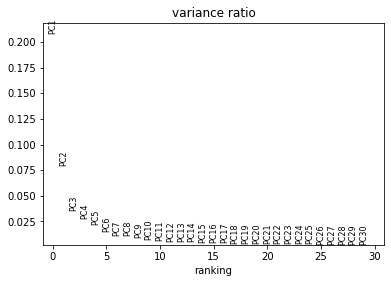

In [17]:
sc.pp.pca(adata, n_comps=30, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata)

In [10]:
# Select number of PCs to use
N_PCS=11

Compare different embeddings based on previously defined annotation. 

In [13]:
#sc.pp.neighbors(adata,n_pcs = N_PCS,metric='correlation') 
#sc.tl.umap(adata)

In [14]:
#rcParams['figure.figsize']=(7,7)
#sc.pl.umap(adata,size=10,color=['pre_cell_type'])
#sc.pl.umap(adata,size=10,color=['file'])

In [19]:
sc.pp.neighbors(adata,n_pcs = N_PCS) 
sc.tl.umap(adata)

In [21]:
# With default colours the NA  could not be separated well - change the color for NA
pos=len(adata.uns['pre_cell_type_colors'])-1
color='#000000'
if color not in adata.uns['pre_cell_type_colors']:
    adata.uns['pre_cell_type_colors'][pos]=color
else:
    print('Colour is already present:',adata.uns['pre_cell_type_colors'])

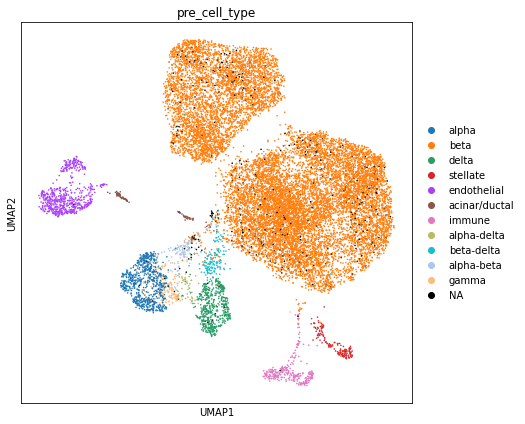

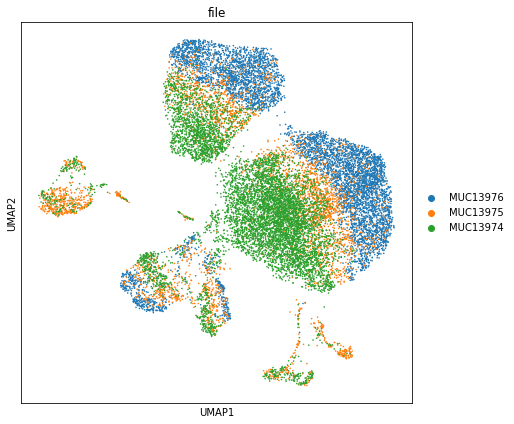

In [22]:
rcParams['figure.figsize']=(7,7)
sc.pl.umap(adata,size=10,color=['pre_cell_type'])
sc.pl.umap(adata,size=10,color=['file'])

## Cell cycle
Performed separately for individual batches.

### Seurat/Scanpy - score by G2M and S

In [23]:
# Load mouse cell cycle genes
cell_cycle_mm=pd.read_table('/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/gene_lists/cell_cycle_mm_Macosko2015.tsv',sep='\t')

Use cell cycle genes that overlap HVGs (from different batches). Display these genes on HVG plots (with non-phase genes being marked as .NA).

Use G2/M and M gene sets for G2/M annotation and S gene set for S annotation.

G1/S N genes: 92 overlap var: 90 overlap hvg (all): 3
S N genes: 96 overlap var: 91 overlap hvg (all): 7
G2/M N genes: 127 overlap var: 123 overlap hvg (all): 19
M N genes: 143 overlap var: 136 overlap hvg (all): 21
M/G1 N genes: 108 overlap var: 105 overlap hvg (all): 7
N genes for scoring S: 7 and G2/M: 40


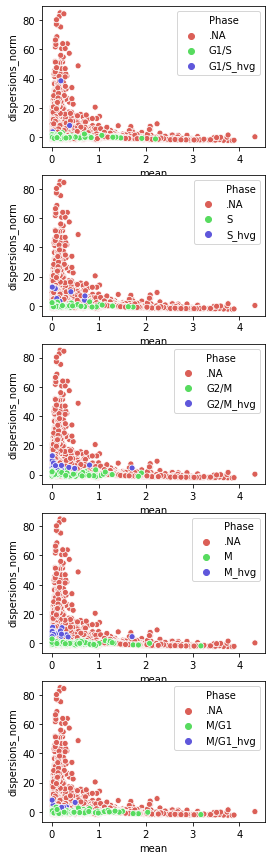

In [24]:
# How many of the cell cycle phase genes are present in HVG and in var and how variable they are
hvg=set(adata.var_names[adata.var.highly_variable])
i=0
rcParams['figure.figsize']=(4,15)
fig,axs=plt.subplots(5)
s_hvg=[]
g2m_hvg=[]
for phase in cell_cycle_mm.Phase.unique():
    genes_phase = set(cell_cycle_mm.query('Phase =="'+phase+'"').Gene)
    overlap_var = set(adata.var_names) & genes_phase
    overlap_hvg = hvg & genes_phase
    print(phase,'N genes:',len(genes_phase),'overlap var:',len(overlap_var),'overlap hvg (all):',len(overlap_hvg))
    phase_df=pd.DataFrame([phase]*len(overlap_var),index=overlap_var,columns=['Phase']).reindex(adata.var_names).fillna('.NA').sort_values('Phase')
    phase_df.loc[overlap_hvg,'Phase']=phase+'_hvg'
    phase_df['mean']=adata.var.means
    phase_df['dispersions_norm']=adata.var.dispersions_norm
    sb.scatterplot(x="mean", y="dispersions_norm", hue="Phase",data=phase_df,ax=axs[i],palette='hls')
    i+=1
    if phase == 'S':
        s_hvg.extend(overlap_hvg)
    if phase in ['G2/M','M']:
        g2m_hvg.extend(overlap_hvg)
        
print('N genes for scoring S:',len(s_hvg),'and G2/M:',len(g2m_hvg))

Cell cycle annotation

In [25]:
# Annotated cell cycle per batch
adata.obs['S_score']= np.zeros(adata.shape[0])
adata.obs['G2M_score'] = np.zeros(adata.shape[0])
adata.obs['phase'] = np.zeros(adata.shape[0])

for batch in enumerate(adata.obs['file'].cat.categories):
    batch=batch[1]
    idx = adata.obs.query('file=="'+batch+'"').index
    adata_tmp = adata[idx,:].copy()
    sc.tl.score_genes_cell_cycle(adata_tmp, s_genes=s_hvg, g2m_genes=g2m_hvg,use_raw=False)
    adata.obs.loc[idx,'S_score'] = adata_tmp.obs['S_score']
    adata.obs.loc[idx,'G2M_score'] = adata_tmp.obs['G2M_score']
    adata.obs.loc[idx,'phase'] = adata_tmp.obs['phase']
    
del adata_tmp

In [26]:
# Count of cells annotated to each phase
adata.obs['phase'].value_counts()

S      9771
G1     7050
G2M     540
Name: phase, dtype: int64

Display cell cycle score distributions and annotation.

... storing 'phase' as categorical


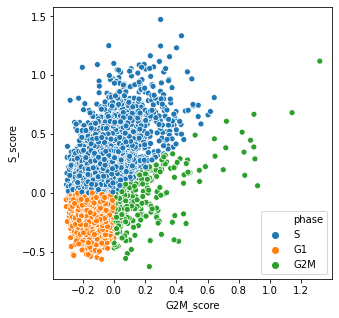

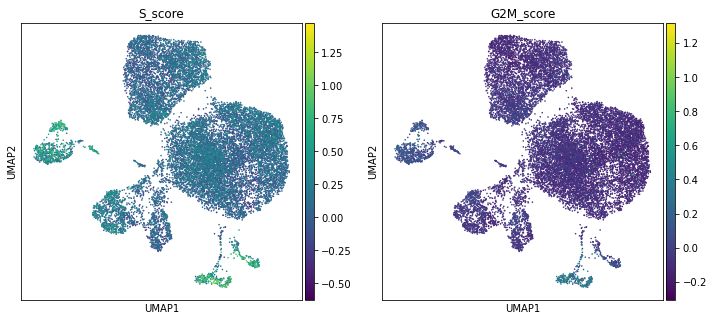

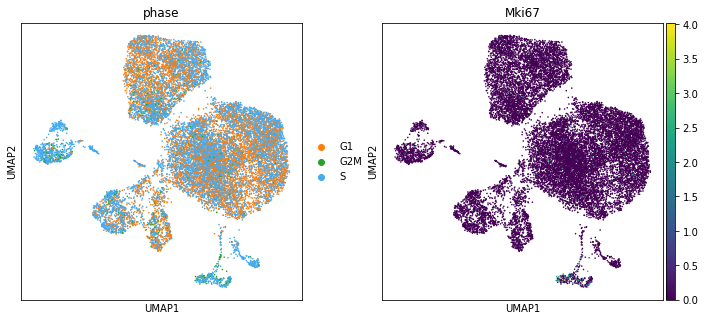

In [27]:
adata.uns['phase_colors']=['#ff7f0e', '#2ca02c','#46aaf0']

rcParams['figure.figsize']=(5,5)
sb.scatterplot(x='G2M_score',y='S_score',hue='phase',data=adata.obs)
sc.pl.umap(adata, color=['S_score', 'G2M_score'], size=10, use_raw=False)
sc.pl.umap(adata, color=['phase','Mki67'], size=10, use_raw=False)

#C: There might be some proliferating populations, but it is not very clear as many cells that preobably are not proliferating (low Mki67 expression) are annotated as cycling.

 ### Cyclone - based on G1, S, and G2/M scores

Add gene Entrez IDs to adata in order to map genes to cell cycle database.

In [34]:
# Adata genes for R
genes=adata.var_names

In [42]:
%%R -i genes -o gene_ids
# Extract Ensembl gene IDs
mouse = useMart("ensembl", dataset = "mmusculus_gene_ensembl")
gene_ids = getBM(attributes = c("mgi_symbol",'ensembl_gene_id'), filters = "mgi_symbol", values = genes , mart = mouse, uniqueRows=FALSE)

In [43]:
# Add gene ids to adata, use only genes with unique mapped ensembl ids
gene_ids.drop_duplicates(subset='mgi_symbol', keep=False, inplace=True)
gene_ids.index=gene_ids.mgi_symbol
gene_ids=gene_ids.reindex(list(adata.var_names))
adata.var['EID']=gene_ids.ensembl_gene_id

In [44]:
# Prepare R data for cyclonee
x_mat=adata.X.T
gene_ids=adata.var.EID
batches=adata.obs.file
cells=adata.obs.index

In [45]:
%%R -i x_mat -i gene_ids -i batches -i cells -o cyclone_anno
# Cyclone cell scores, calculated separately for each batch
mm.pairs <- readRDS(system.file("exdata", "mouse_cycle_markers.rds", package="scran"))
phases<-c()
s<-c()
g2m<-c()
g1<-c()
cells_order<-c()
for(batch in unique(batches)){
    # Select batch data
    x_mat_batch=x_mat[,batches==batch]
    print(batch,dim(x_mat_batch[1]))
    # Scores
    assignments <- cyclone(x_mat_batch, mm.pairs, gene.names=gene_ids,BPPARAM=MulticoreParam(workers = 16))
    phases<-c(phases,assignments$phases)
    s<-c(s,assignments$score$S)
    g2m<-c(g2m,assignments$score$G2M)
    g1<-c(g1,assignments$score$G1)
    # Save cell order
    cells_order<-c(cells_order,cells[batches==batch])
}
cyclone_anno<-data.frame(phase_cyclone=phases,s_cyclone=s,g2m_cyclone=g2m,g1_cyclone=g1)
rownames(cyclone_anno)<-cells_order

[1] "MUC13976"
[1] "MUC13975"
[1] "MUC13974"


In [46]:
# Count of cells annotated to each phase
cyclone_anno.phase_cyclone.value_counts()

G1     17340
G2M       16
S          5
Name: phase_cyclone, dtype: int64

In [49]:
# Add cyclone annotation to adata
cyclone_anno=cyclone_anno.reindex(adata.obs.index)
adata.obs=pd.concat([adata.obs,cyclone_anno],axis=1)

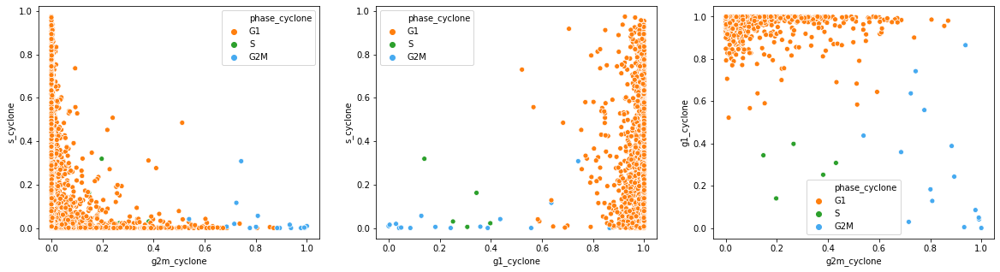

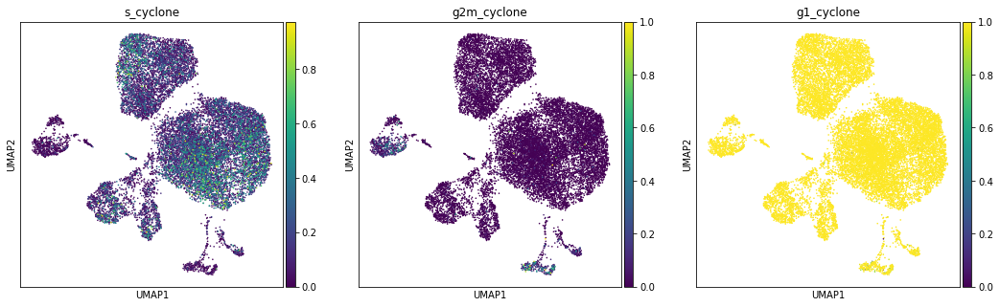

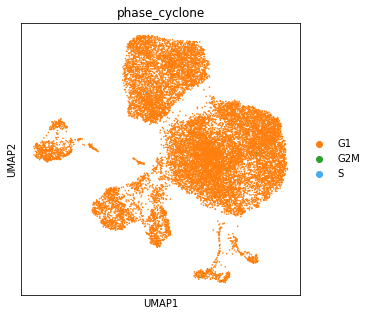

In [57]:
# Plot score distributions and cell assignment on UMAP
rcParams['figure.figsize']=(20,5)
fig,axs=plt.subplots(1,3)
palette=sb.color_palette(['#ff7f0e', '#2ca02c','#46aaf0'])
sb.scatterplot(x='g2m_cyclone',y='s_cyclone',hue='phase_cyclone',data=cyclone_anno,ax=axs[0],palette=palette)
sb.scatterplot(x='g1_cyclone',y='s_cyclone',hue='phase_cyclone',data=cyclone_anno,ax=axs[1],palette=palette)
sb.scatterplot(x='g2m_cyclone',y='g1_cyclone',hue='phase_cyclone',data=cyclone_anno,ax=axs[2],palette=palette)
rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata, color=['s_cyclone', 'g2m_cyclone','g1_cyclone'], size=10, use_raw=False)
adata.uns['phase_cyclone_colors']=['#ff7f0e', '#2ca02c','#46aaf0']
sc.pl.umap(adata, color=['phase_cyclone'], size=10, use_raw=False)

#C: The cyclone results seem more reliable based on Mki67 expression (above) and embedding.

## Sex scores

Extract expressed genes from X and Y chromosome and score their expression, separately for each batch.

Add chromosome information:

In [58]:
# Gene names for R for chromosome assignment
genes=adata.var_names

In [59]:
%%R -i genes -o genes_chr
# Chromosome assignment 

mouse = useMart("ensembl", dataset = "mmusculus_gene_ensembl")
# Return duplicated results - e.g. one gene being annotated to multiple chromosomes
genes_chr = getBM(attributes = c("mgi_symbol",'chromosome_name'), filters = "mgi_symbol", values = genes , mart = mouse, uniqueRows=F)


In [60]:
# Remove genes annotated to non-standard chromosomes and 
# confirm that each gene is now annotated to only one chromosome
mouse_chromosomes=[str(i) for i in range(1,20)]+['X','Y','MT']
genes_chr_filtered=genes_chr.query('chromosome_name in @mouse_chromosomes')
#Remove duplicated rows (gene was returned multiple times with the same chromosome)
genes_chr_filtered=genes_chr_filtered.drop_duplicates()
print('Each gene has one annotated chromosome:',
      genes_chr_filtered.mgi_symbol.unique().shape[0]==genes_chr_filtered.shape[0])
print('N genes with chromosomes:',genes_chr_filtered.shape[0],'out of',adata.shape[1],'genes')

Each gene has one annotated chromosome: True
N genes with chromosomes: 16701 out of 17146 genes


In [61]:
# Add chromosomes in adata
genes_chr_filtered.index=genes_chr_filtered.mgi_symbol
genes_chr_filtered=genes_chr_filtered.reindex(adata.var_names)
adata.var['chromosome']=genes_chr_filtered['chromosome_name']

Extract X and Y HVGs and compare their number to all expressed X and Y genes.

In [62]:
# Select X and Y genes that are HVG
x_hvg = adata.var.query('chromosome=="X" & highly_variable').index
y_hvg = adata.var.query('chromosome=="Y" & highly_variable').index
print('X HVG:',len(x_hvg),'/',adata.var.query('chromosome=="X"').shape[0],
      'Y HVG:',len(y_hvg),'/',adata.var.query('chromosome=="Y"').shape[0])

X HVG: 58 / 538 Y HVG: 3 / 6


Show Y gene expression on UMAP.

... storing 'chromosome' as categorical


Y specific HVG


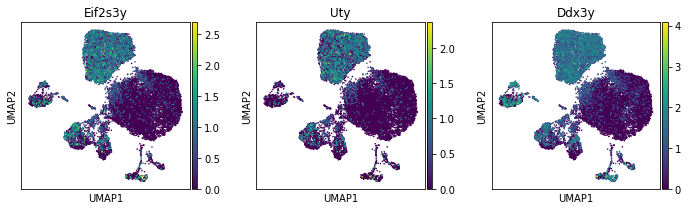

Y specific non-HVG


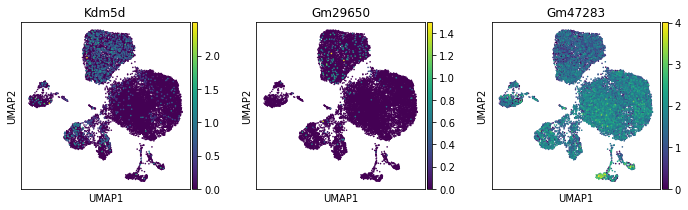

In [63]:
# Show Y HVGs and Y non-HVGs
rcParams['figure.figsize']=(3,3)
print('Y specific HVG')
sc.pl.umap(adata, color=y_hvg, size=10, use_raw=False)
print('Y specific non-HVG')
sc.pl.umap(adata, color=adata.var.query('chromosome=="Y"& ~highly_variable').index, size=10, use_raw=False)

#C: Due to low number of expressed Y genes both HVG and non-HVG genes will be used. Genes Gm47283 (unsepcific??) and Gm29650 (low expression in most cells) will not be used for Y scoring. 
For X chromosome only HVG will be used. 

Score cells:

In [64]:
# Prepare final scoring gene sets for X and Y
y_all=adata.var.query('chromosome=="Y"').index
y_selected=[gene for gene in y_all if gene not in ['Gm47283','Gm29650']]
x_selected=list(x_hvg)
print('N selected genes from Y:',len(y_selected),'and from X:',len(x_selected))

N selected genes from Y: 4 and from X: 58


In [65]:
#Do not use the smaller gene set as controll size as Y gene set is very small
#ctrl_size = min(len(x_genes), len(y_genes))

# For performing it on all batches together
#sc.tl.score_genes(adata, x_selected, score_name = 'x_score', use_raw=False)
#sc.tl.score_genes(adata, y_selected, score_name = 'y_score',use_raw=False)

# Compute sex score per batch
adata.obs['x_score']= np.zeros(adata.shape[0])
adata.obs['y_score'] = np.zeros(adata.shape[0])

for batch in enumerate(adata.obs['file'].cat.categories):
    batch=batch[1]
    idx = adata.obs.query('file=="'+batch+'"').index
    adata_tmp = adata[idx,:].copy()
    sc.tl.score_genes(adata_tmp, x_selected, score_name = 'x_score', use_raw=False)
    sc.tl.score_genes(adata_tmp, y_selected, score_name = 'y_score',use_raw=False)
    adata.obs.loc[idx,'y_score'] = adata_tmp.obs['y_score']
    adata.obs.loc[idx,'x_score'] = adata_tmp.obs['x_score']
    
del adata_tmp

Plot X and Y scores

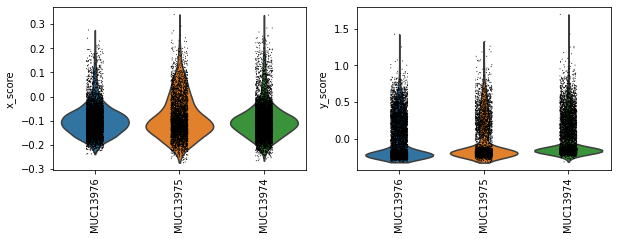

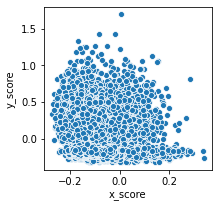

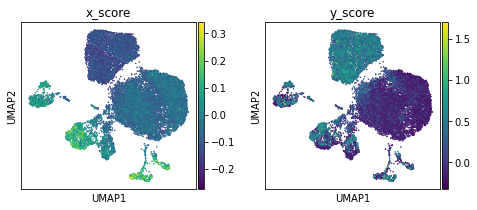

<AxesSubplot:xlabel='y_score'>

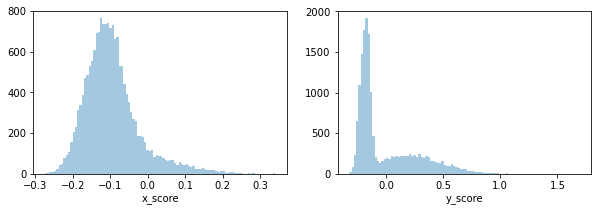

In [66]:
rcParams['figure.figsize']=(10,3)
fig,axs=plt.subplots(1,2)
# Scores across batches
sc.pl.violin(adata, ['x_score'], groupby='file', size=1, log=False,rotation=90,ax=axs[0],show=False)
sc.pl.violin(adata, ['y_score'], groupby='file', size=1, log=False,rotation=90,ax=axs[1],show=False)
plt.show()
# X vs Y score
rcParams['figure.figsize']=(3,3)
sb.scatterplot(x='x_score',y='y_score',data=adata.obs)
# Distribution of scores
sc.pl.umap(adata, color=['x_score','y_score'] ,size=10, use_raw=False)
rcParams['figure.figsize']=(10,3)
fig,axs=plt.subplots(1,2)
sb.distplot(adata.obs['x_score'],  kde=False,  bins=100,ax=axs[0])
sb.distplot(adata.obs['y_score'],  kde=False,  bins=100,ax=axs[1])

#C: It seems that Y score alone performs much better - X score depends more on the cell type. Thus only Y score will be used for cell type annotation.

<AxesSubplot:xlabel='y_score'>

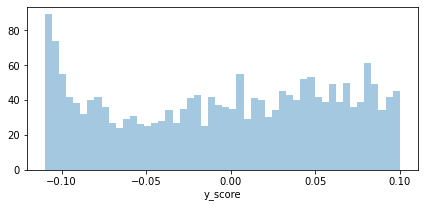

In [91]:
# More detailed plot of y_score region of interest
rcParams['figure.figsize']=(7,3)
sb.distplot(adata.obs.query('y_score>-0.11 & y_score<0.1')['y_score'],  kde=False,  bins=50)

#C: Set male threshold at >= - 0.07 (Score 0 means equal expression as a reference data set.)

... storing 'sex' as categorical


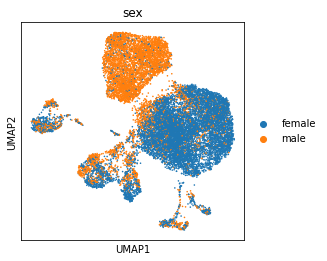

female    10739
male       6622
Name: sex, dtype: int64


In [93]:
adata.obs['sex']=(adata.obs['y_score']>=-0.07).replace(False,'female').replace(True,'male')

rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata, color=['sex'] ,size=10, use_raw=False)
print(adata.obs.sex.value_counts())

## Save intermediate results before cell type annotation

In [94]:
if SAVE:
    h.save_h5ad(adata, shared_folder+"data_annotated.h5ad",unique_id2=UID2)

# Cell type annotation

In [5]:
adata=h.open_h5ad(shared_folder+"data_annotated.h5ad",unique_id2=UID2)

## Endo high annotation

In [6]:
# Normalise raw data for cell type scoring
adata_rawnorm=adata.raw.to_adata().copy()
adata_rawnorm.X /= adata.obs['size_factors'].values[:,None] # This reshapes the size-factors array
sc.pp.log1p(adata_rawnorm)
adata_rawnorm.X = np.asarray(adata_rawnorm.X)
adata_rawnorm.obs=adata.obs.copy()

#### Ins

In [7]:
# Compute Ins score
sc.tl.score_genes(adata_rawnorm, gene_list=['Ins1','Ins2'], score_name='ins_score',  use_raw=False)

<ipython-input-17-25ff1235bd20>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ins_scores['ins_score_norm']=pp.minmax_scale(ins_scores.ins_score)


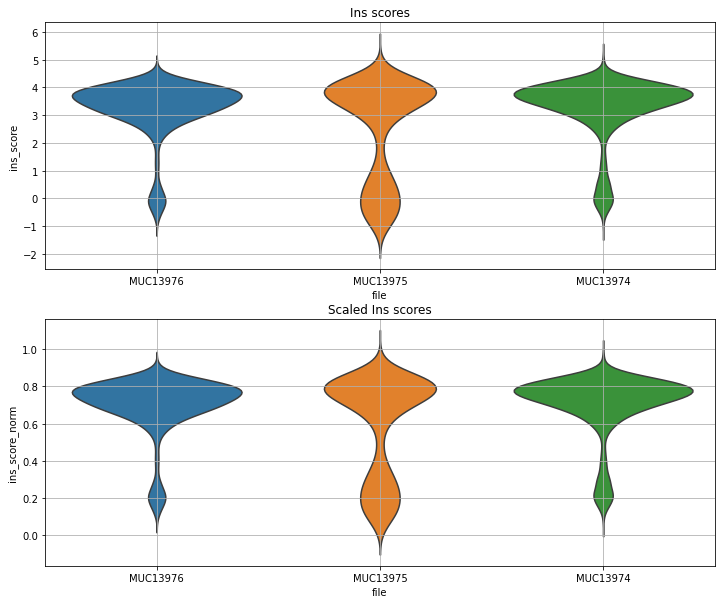

In [17]:
#sc.pl.violin(adata_rawnorm, keys=['ins_score'], groupby='file', stripplot=False, jitter=True)
ins_scores=adata_rawnorm.obs[['ins_score','file']]
ins_scores['ins_score_norm']=pp.minmax_scale(ins_scores.ins_score)
rcParams['figure.figsize']=(12,10)
fig,axs=plt.subplots(2,1)
sb.violinplot(x='file',y='ins_score',data=ins_scores,inner=None,ax=axs[0])
axs[0].title.set_text('Ins scores')
axs[0].grid()
sb.violinplot(x='file',y='ins_score_norm',data=ins_scores,inner=None,ax=axs[1])
axs[1].title.set_text('Scaled Ins scores')
axs[1].grid()
#sb.violinplot(x='file',y='ins_score_norm',data=ins_scores[ins_scores.ins_score_norm>0.2],inner=None,ax=axs[2])
#axs[2].title.set_text('Scaled Ins scores without very low Ins cells')
#axs[2].grid()

In [20]:
# Find ins high cells
adata_rawnorm.obs['ins_high']=ins_scores.ins_score_norm>0.5
print('Proportion of ins high across samples:')
adata_rawnorm.obs[['file','ins_high']].groupby('file').ins_high.value_counts(normalize=True,sort=False)

Proportion of ins high across samples:


file      ins_high
MUC13976  False       0.082881
          True        0.917119
MUC13975  False       0.322477
          True        0.677523
MUC13974  False       0.108309
          True        0.891691
Name: ins_high, dtype: float64

In [19]:
# Add info about ins high to main adata and save it
adata.obs['ins_score']=adata_rawnorm.obs['ins_score']
adata.obs['ins_high']=adata_rawnorm.obs['ins_high']

#### Gcg

In [7]:
genes=['Gcg']
score_name='gcg'

In [8]:
# Compute score
sc.tl.score_genes(adata_rawnorm, gene_list=genes, score_name=score_name+'_score',  use_raw=False)

<ipython-input-12-5e04c99c05d1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])


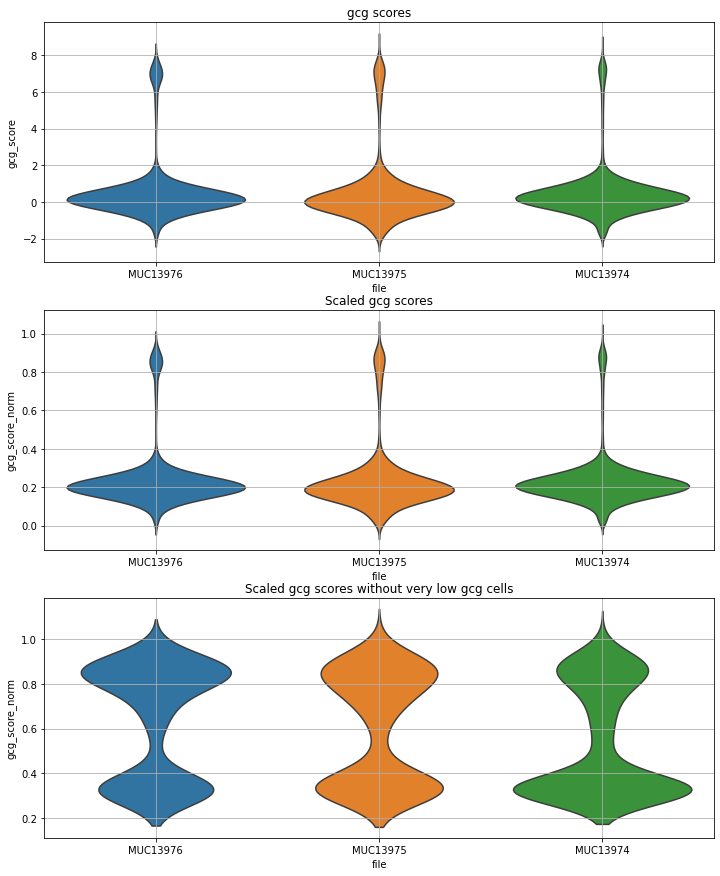

In [12]:
scores=adata_rawnorm.obs[[score_name+'_score','file']]
scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])
rcParams['figure.figsize']=(12,15)
fig,axs=plt.subplots(3,1)
sb.violinplot(x='file',y=score_name+'_score',data=scores,inner=None,ax=axs[0])
axs[0].title.set_text(score_name+' scores')
axs[0].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores,inner=None,ax=axs[1])
axs[1].title.set_text('Scaled '+score_name+' scores')
axs[1].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores[scores[score_name+'_score_norm']>0.3],
             inner=None,ax=axs[2])
axs[2].title.set_text('Scaled '+score_name+' scores without very low '+score_name+' cells')
axs[2].grid()

In [13]:
# Find score high cells
# Use different thresholds across files as there might be different ambient counts (or other effects), 
# thus shifting distributions up a bit
file_thresholds={'MUC13976':0.5, 'MUC13975':0.55, 'MUC13974':0.55}
adata_rawnorm.obs[score_name+'_high']=scores.apply(lambda x: x[score_name+'_score_norm'] > file_thresholds[x.file], 
                                                   axis=1)
print('Proportion of '+score_name+' high across samples:')
adata_rawnorm.obs[['file',score_name+'_high']].groupby('file')[score_name+'_high'].value_counts(
    normalize=True,sort=False)

Proportion of gcg high across samples:


file      gcg_high
MUC13976  False       0.930604
          True        0.069396
MUC13975  False       0.922050
          True        0.077950
MUC13974  False       0.951818
          True        0.048182
Name: gcg_high, dtype: float64

In [14]:
# Add info about score high to main adata and save it
adata.obs[score_name+'_score']=adata_rawnorm.obs[score_name+'_score']
adata.obs[score_name+'_high']=adata_rawnorm.obs[score_name+'_high']

#### Sst

In [17]:
genes=['Sst']
score_name='sst'

In [18]:
# Compute score
sc.tl.score_genes(adata_rawnorm, gene_list=genes, score_name=score_name+'_score',  use_raw=False)

<ipython-input-20-cac3e59fdde3>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])


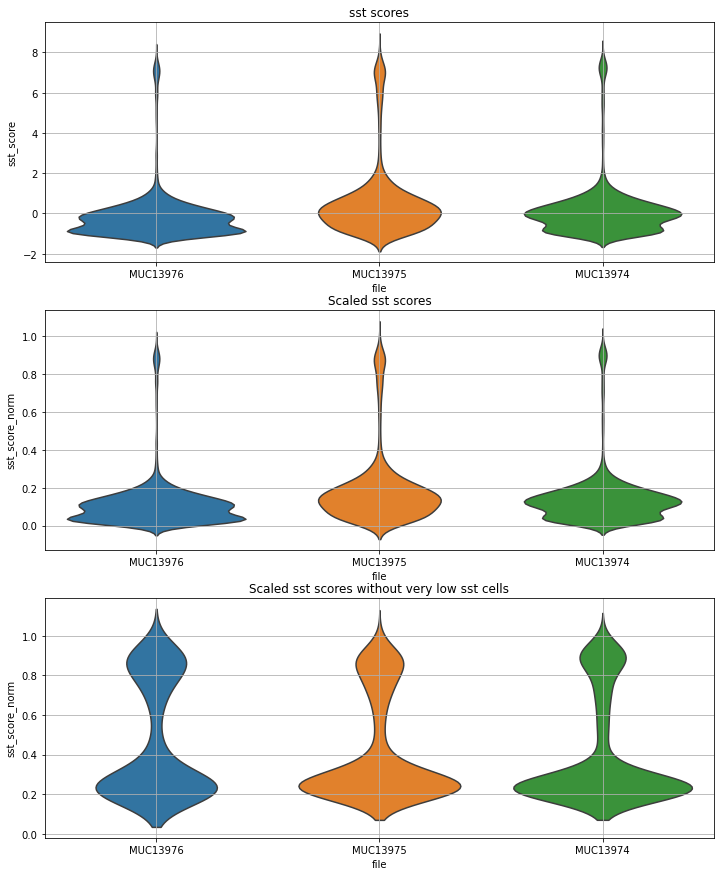

In [20]:
scores=adata_rawnorm.obs[[score_name+'_score','file']]
scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])
rcParams['figure.figsize']=(12,15)
fig,axs=plt.subplots(3,1)
sb.violinplot(x='file',y=score_name+'_score',data=scores,inner=None,ax=axs[0])
axs[0].title.set_text(score_name+' scores')
axs[0].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores,inner=None,ax=axs[1])
axs[1].title.set_text('Scaled '+score_name+' scores')
axs[1].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores[scores[score_name+'_score_norm']>0.2],
             inner=None,ax=axs[2])
axs[2].title.set_text('Scaled '+score_name+' scores without very low '+score_name+' cells')
axs[2].grid()

In [21]:
# Find score high cells
# Use different thresholds across files as there might be different ambient counts (or other effects), 
# thus shifting distributions up a bit
file_thresholds={'MUC13976':0.55, 'MUC13975':0.55, 'MUC13974':0.6}
adata_rawnorm.obs[score_name+'_high']=scores.apply(lambda x: x[score_name+'_score_norm'] > file_thresholds[x.file], 
                                                   axis=1)
print('Proportion of '+score_name+' high across samples:')
adata_rawnorm.obs[['file',score_name+'_high']].groupby('file')[score_name+'_high'].value_counts(
    normalize=True,sort=False)

Proportion of sst high across samples:


file      sst_high
MUC13976  False       0.968426
          True        0.031574
MUC13975  False       0.919915
          True        0.080085
MUC13974  False       0.960977
          True        0.039023
Name: sst_high, dtype: float64

In [22]:
# Add info about score high to main adata and save it
adata.obs[score_name+'_score']=adata_rawnorm.obs[score_name+'_score']
adata.obs[score_name+'_high']=adata_rawnorm.obs[score_name+'_high']

In [23]:
#### Ppy

In [24]:
genes=['Ppy']
score_name='ppy'

In [25]:
# Compute score
sc.tl.score_genes(adata_rawnorm, gene_list=genes, score_name=score_name+'_score',  use_raw=False)

<ipython-input-28-b5dae19a0625>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])


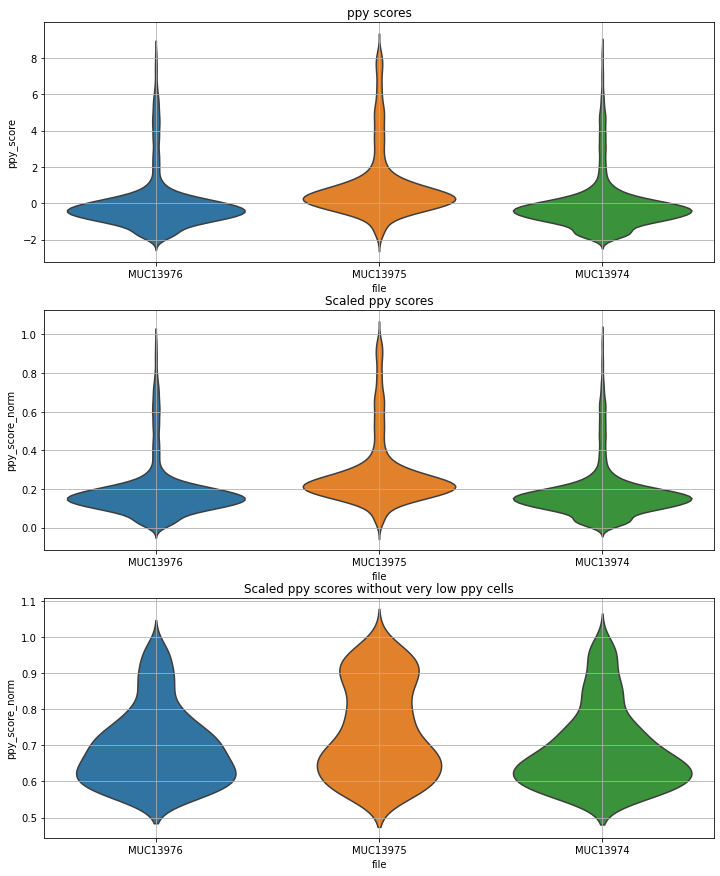

In [28]:
scores=adata_rawnorm.obs[[score_name+'_score','file']]
scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])
rcParams['figure.figsize']=(12,15)
fig,axs=plt.subplots(3,1)
sb.violinplot(x='file',y=score_name+'_score',data=scores,inner=None,ax=axs[0])
axs[0].title.set_text(score_name+' scores')
axs[0].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores,inner=None,ax=axs[1])
axs[1].title.set_text('Scaled '+score_name+' scores')
axs[1].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores[scores[score_name+'_score_norm']>0.55],
             inner=None,ax=axs[2])
axs[2].title.set_text('Scaled '+score_name+' scores without very low '+score_name+' cells')
axs[2].grid()

In [29]:
# Find score high cells
# Use different thresholds across files as there might be different ambient counts (or other effects), 
# thus shifting distributions up a bit
file_thresholds={'MUC13976':0.83, 'MUC13975':0.83, 'MUC13974':0.8}
adata_rawnorm.obs[score_name+'_high']=scores.apply(lambda x: x[score_name+'_score_norm'] > file_thresholds[x.file], 
                                                   axis=1)
print('Proportion of '+score_name+' high across samples:')
adata_rawnorm.obs[['file',score_name+'_high']].groupby('file')[score_name+'_high'].value_counts(
    normalize=True,sort=False)

Proportion of ppy high across samples:


file      ppy_high
MUC13976  False       0.992435
          True        0.007565
MUC13975  False       0.969834
          True        0.030166
MUC13974  False       0.992700
          True        0.007300
Name: ppy_high, dtype: float64

In [30]:
# Add info about score high to main adata and save it
adata.obs[score_name+'_score']=adata_rawnorm.obs[score_name+'_score']
adata.obs[score_name+'_high']=adata_rawnorm.obs[score_name+'_high']

#### Save

In [31]:
if SAVE:
    h.save_h5ad(adata, shared_folder+"data_annotated.h5ad",unique_id2=UID2)

## Clustering

#### Leiden clustering on log transformed data.

In [6]:
sc.tl.leiden(adata,resolution=0.4)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


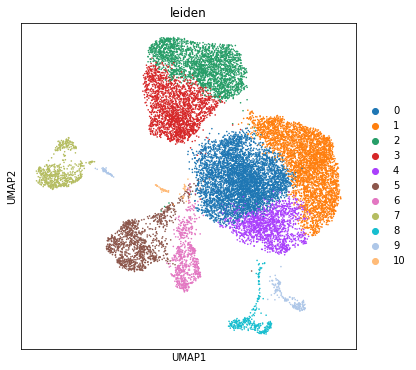

In [7]:
rcParams['figure.figsize']=(6,6)
sc.pl.umap(adata, color=['leiden'] ,size=10, use_raw=False)

#### Seurat style clustering

#### Leiden clustering on log transformed z-scaled data.

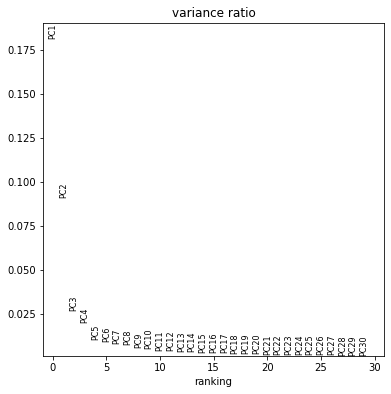

In [8]:
# Scale data and perform PCA
adata_scl=adata.copy()
sc.pp.scale(adata_scl,max_value=10)
sc.pp.pca(adata_scl, n_comps=30, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata_scl)

In [11]:
#C: Can stay the same as above
N_PCS

11

In [12]:
# neighbours on scaled data
sc.pp.neighbors(adata_scl,n_pcs = N_PCS) 

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities


In [13]:
# This neighbour weight computation (used in  Seurat) does not improve clustering - the main improvement is due to scaling
#snn.shared_knn_adata(adata,n_pcs=N_PCS,n_jobs=8)

In [14]:
# Umap on scaled data
sc.tl.umap(adata_scl)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),


In [15]:
# Add scaled embedding to adata
adata.obsm['X_umap_scl']=adata_scl.obsm['X_umap']

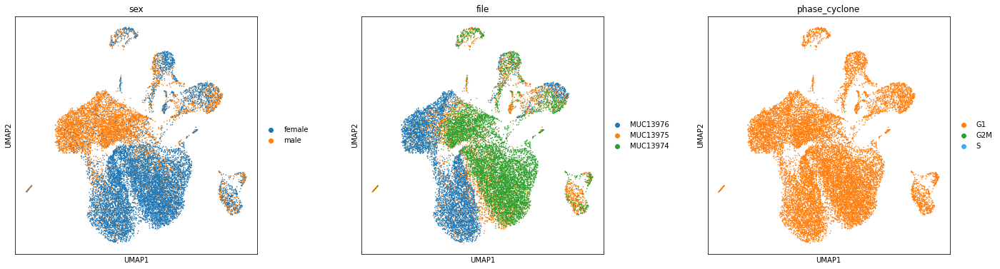

In [16]:
#del adata_scl.uns['sex_colors']
rcParams['figure.figsize']=(6,6)
sc.pl.umap(adata_scl, color=['sex','file','phase_cyclone'] ,size=10, use_raw=False,wspace=0.3)

In [17]:
# Clustering resolution
res=0.4

In [18]:
# Cluster scaled data
sc.tl.leiden(adata_scl, resolution=res, key_added='leiden_scaled_r'+str(res), directed=True, use_weights=True)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


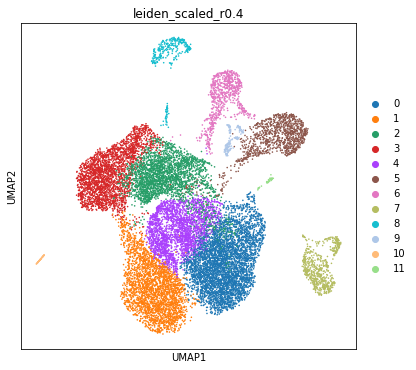

In [19]:
# Compare UMAPs and clusters on scaled data
rcParams['figure.figsize']=(6,6)
sc.pl.umap(adata_scl, color=['leiden_scaled_r'+str(res)] ,size=10, use_raw=False)

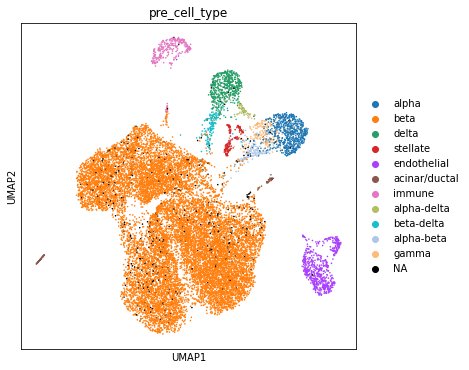

In [20]:
sc.pl.umap(adata_scl, color=['pre_cell_type'] ,size=10, use_raw=False)

#C: Umaps and clusterings on z-scaled data and non-z-scaled data perform similarly. z-scaled data will be used for consistency with other analysed studies.

## Cell type annotation

In [21]:
# Normalise raw data for plotting and cell type scoring
adata_raw=adata_scl.raw.to_adata().copy()
sc.pp.normalize_total(adata_raw, target_sum=1e4, exclude_highly_expressed=True,inplace=False)
sc.pp.log1p(adata_raw)
adata_rawnormalised=adata_scl.copy()
adata_rawnormalised.raw=adata_raw
del adata_raw

In [22]:
# Markers data
markers=pd.read_excel('/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/gene_lists/markers.xlsx',
                          sheet_name='mice')

In [23]:
# Subset markers to non-immature and non-dedifferentiated for initial annotation
print('Subtypes (original):',markers.Subtype.unique())
remove_subtype=['immature','dedifferentiated']
remove_subtype=[]
markers_filter=markers.query('Subtype not in @remove_subtype')

Subtypes (original): ['mature' 'immature' nan 'dedifferentiated' 'activated' 'quiescent'
 'cytotoxic' 'disease' 'senescent' 'aging' 'inflamation']


acinar
Missing genes: ['Ptf1a', 'Ce1', 'Rbpj1']


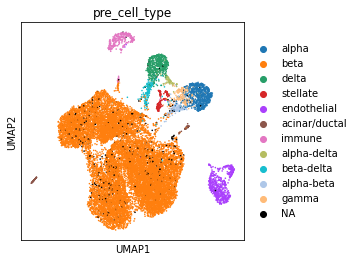

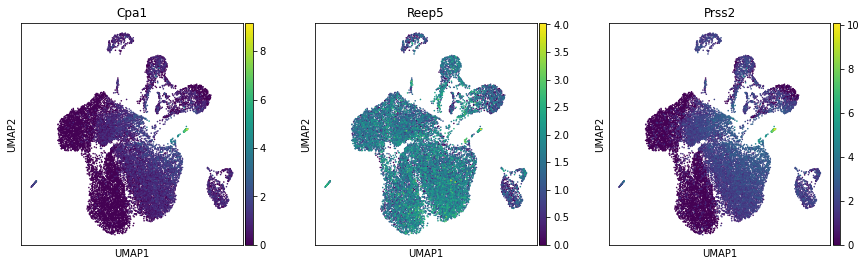

alpha
Missing genes: []


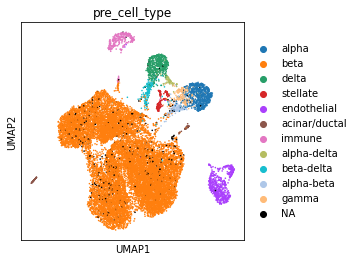

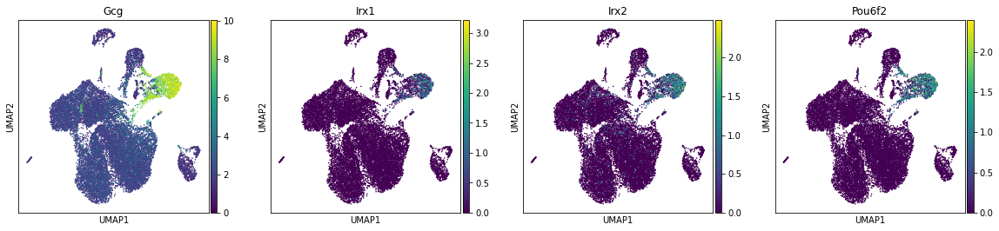

B immune
Missing genes: []


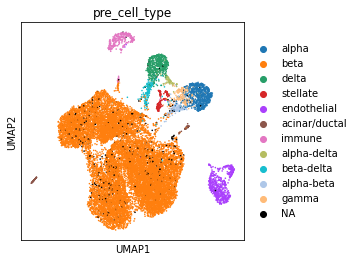

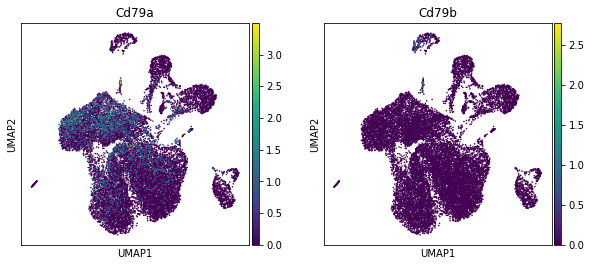

beta
Missing genes: ['Pax4']


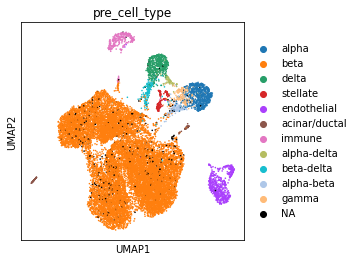

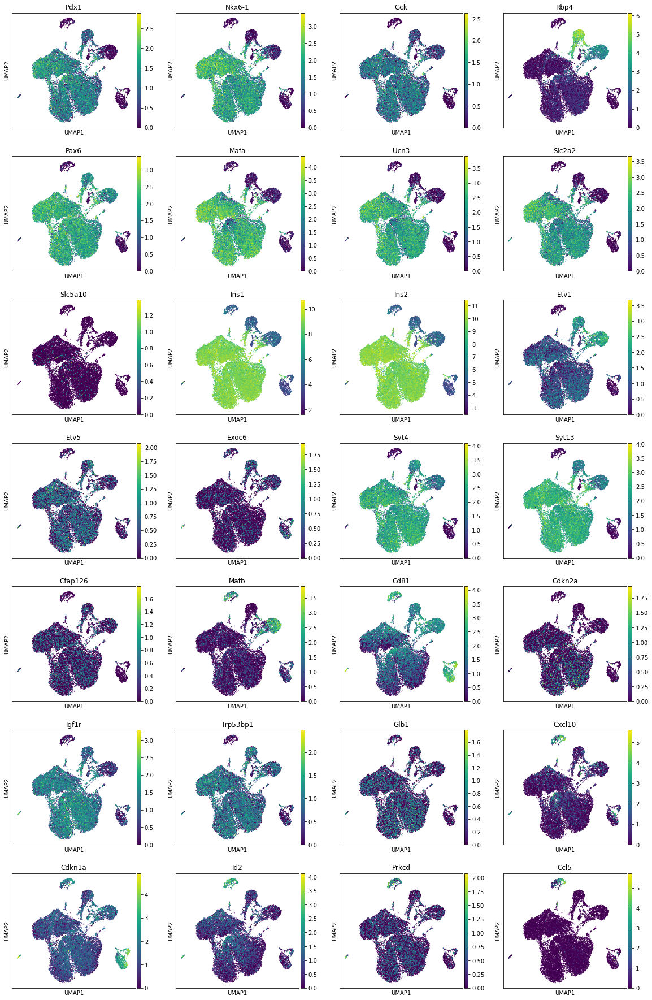

delta
Missing genes: []


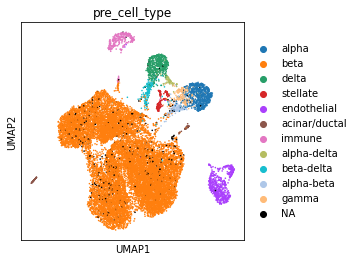

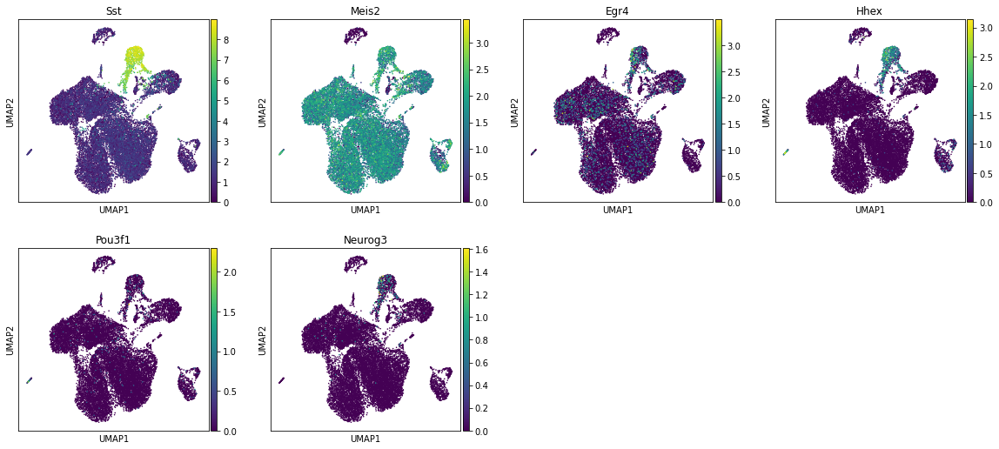

dendritic
Missing genes: ['Iftim3']


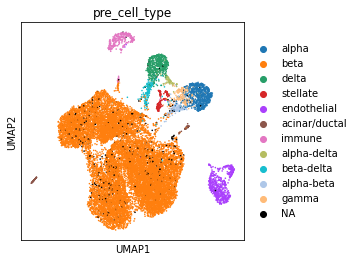

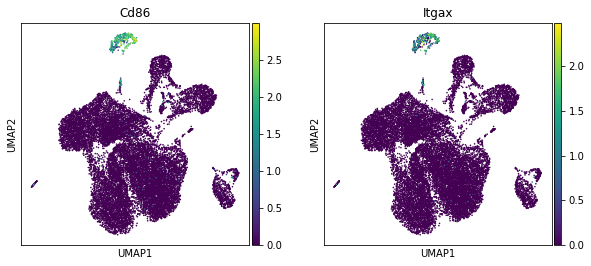

ductal
Missing genes: ['Ca2']


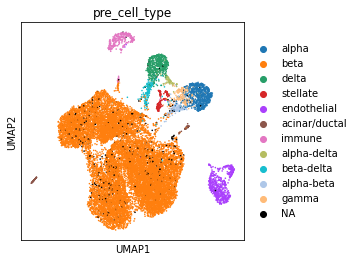

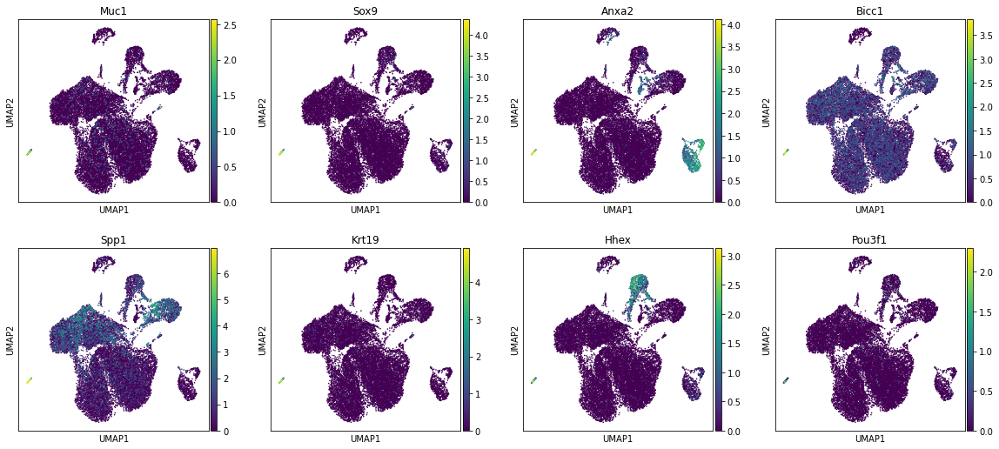

endocrine
Missing genes: ['Neurod2', 'Gng13']


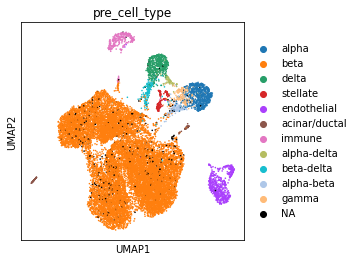

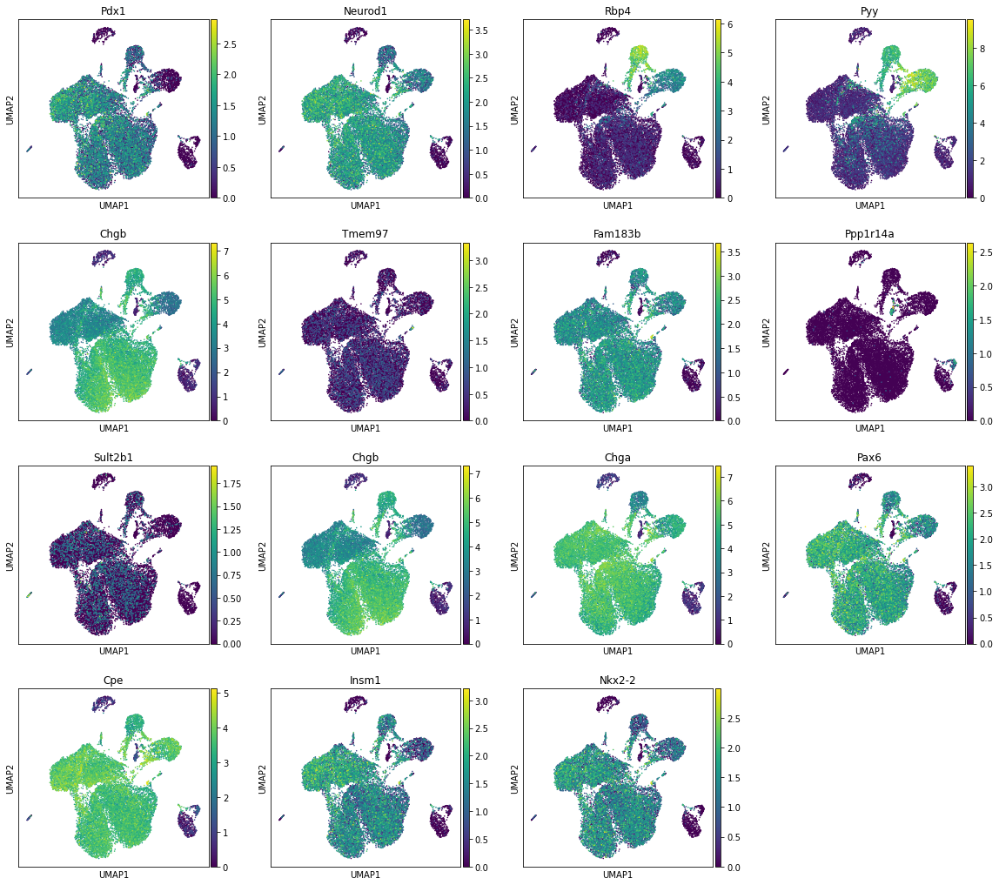

endothelial
Missing genes: []


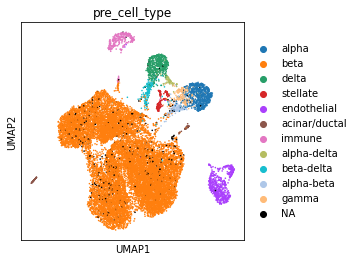

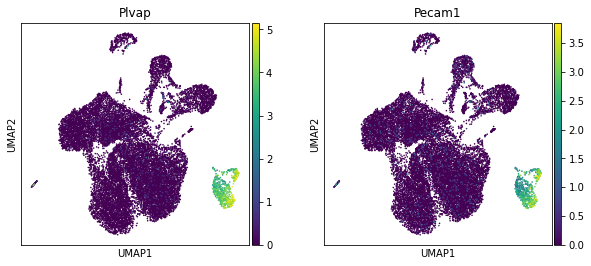

EP
Missing genes: ['Ngn3']


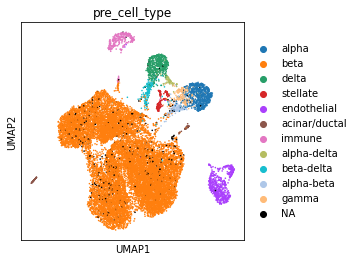

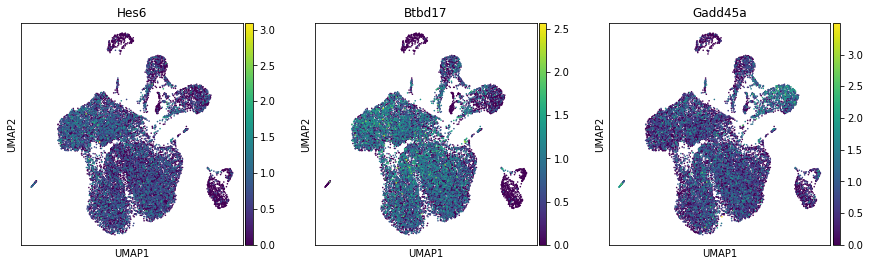

epithelial
Missing genes: []


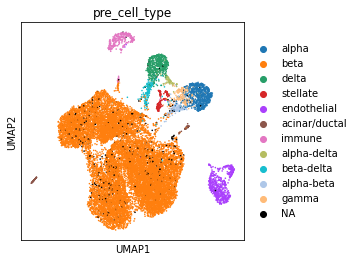

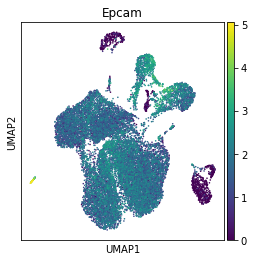

epsilon
Missing genes: []


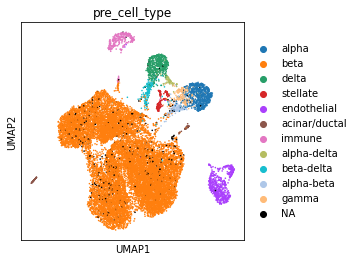

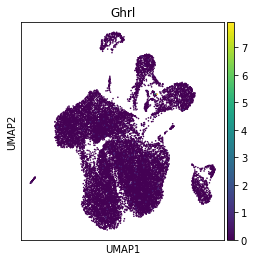

gamma
Missing genes: []


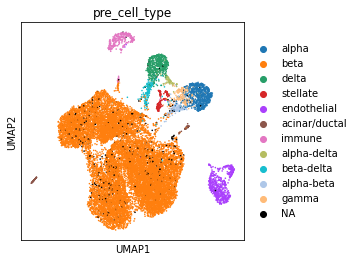

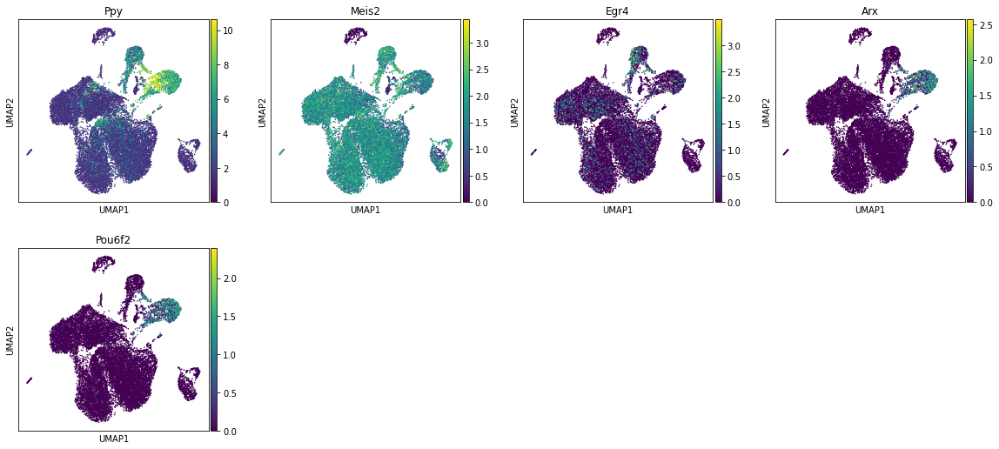

immune
Missing genes: []


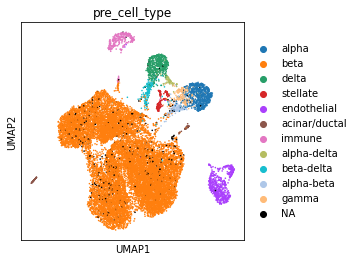

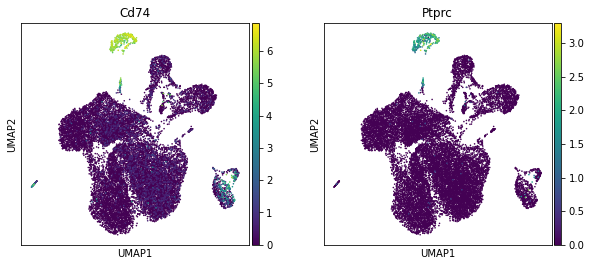

lymphocye
Missing genes: []


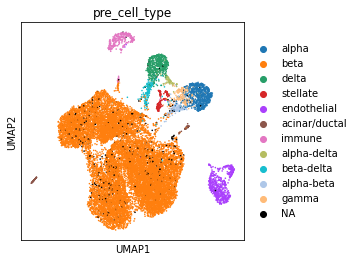

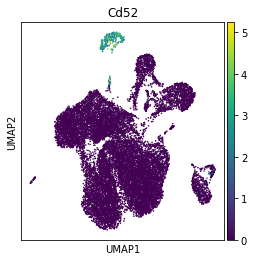

macrophage
Missing genes: []


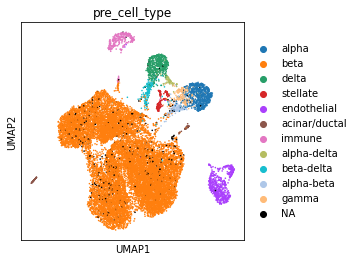

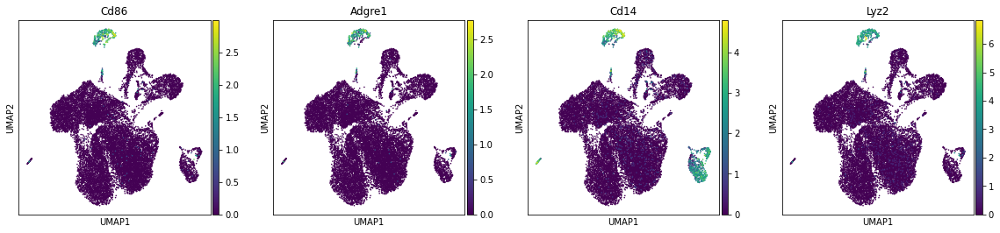

MPC
Missing genes: ['Bft3']


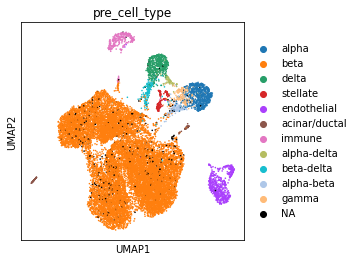

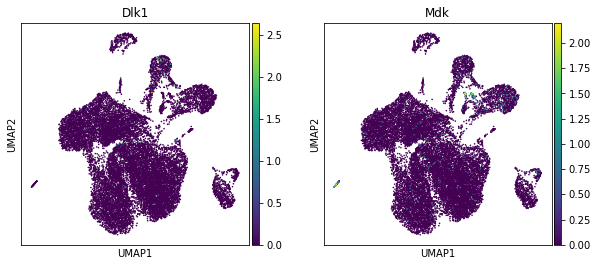

pericyte
Missing genes: []


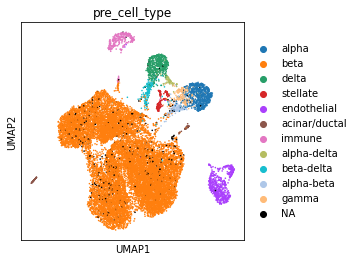

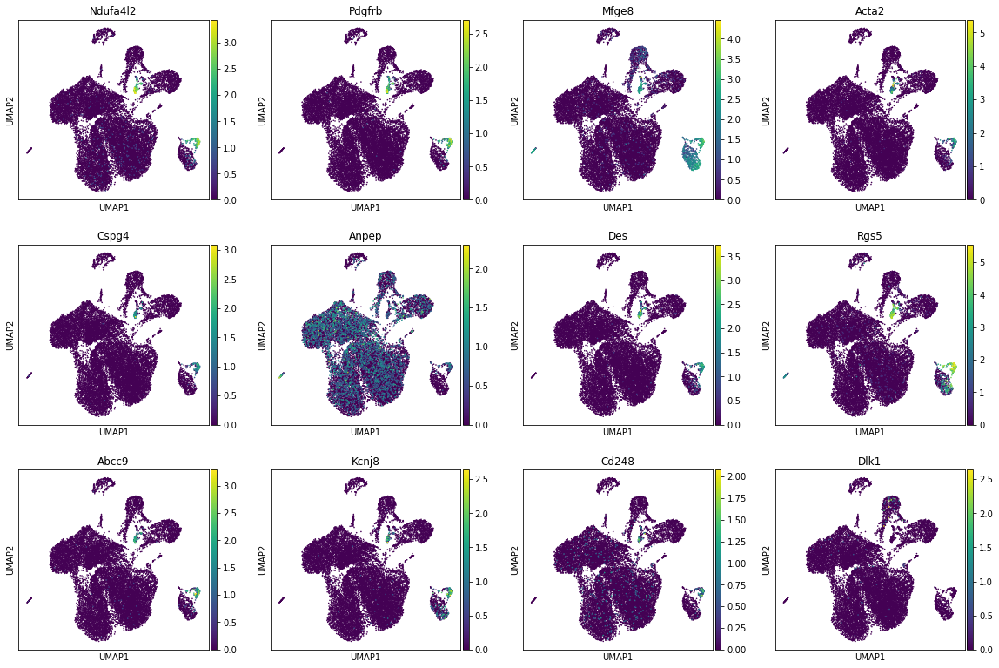

schwann
Missing genes: ['Sox10']


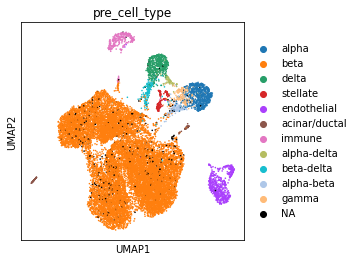

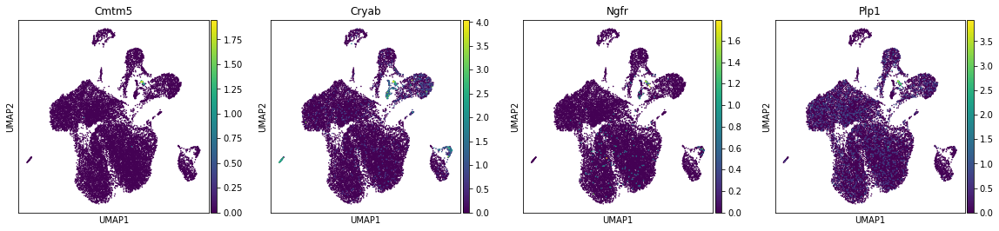

stellate
Missing genes: []


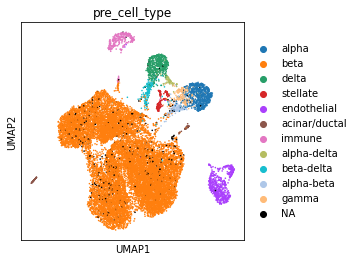

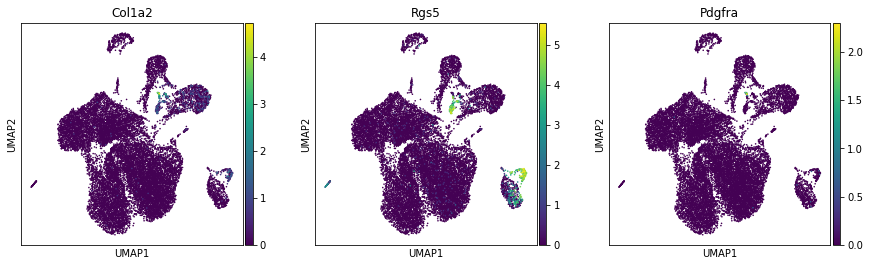

T immune
Missing genes: ['Cd8a', 'Cd3d']


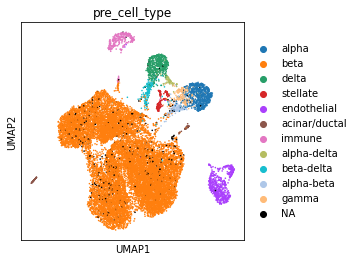

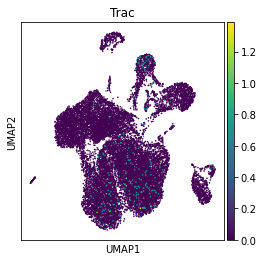

tip
Missing genes: []


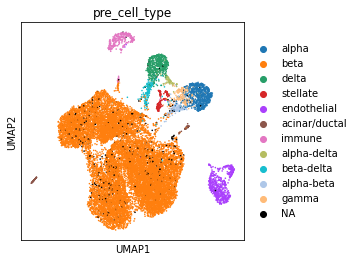

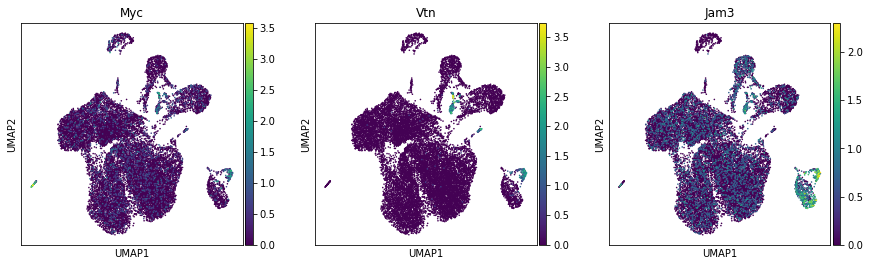

trunk
Missing genes: []


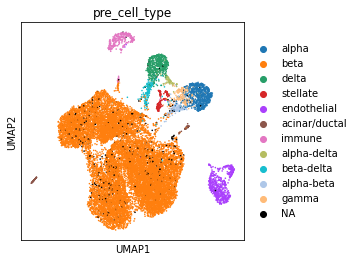

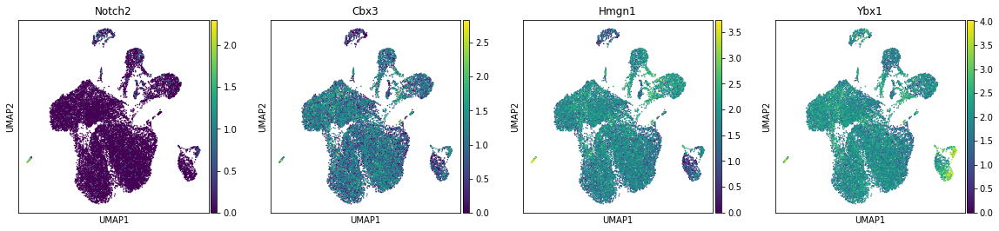

In [24]:
# Plot markers for each cell type
# Plot markers for each cell type
for cell_type in sorted(list(markers_filter.Cell.unique()), key=str.lower):
    print(cell_type)
    genes=list(markers_filter.query('Cell == "'+cell_type+'"').Gene)
    # Retain genes present in raw var_names
    missing=[gene for gene in genes if gene not in adata.raw.var_names]
    genes=[gene for gene in genes if gene in adata.raw.var_names]
    if len(genes)>0:
        print('Missing genes:',missing)
        rcParams['figure.figsize']=(4,4)
        sc.pl.umap(adata_rawnormalised, color=['pre_cell_type'],size=10, use_raw=True)
        sc.pl.umap(adata_rawnormalised, color=genes ,size=10, use_raw=True)
    else:
        print('No availiable genes (out of:',missing,')\n')

In [25]:
# Selected markers that seem to be able to distinguish between cell types
# Use only hormone genes for endocrine cells
markers_selection={
'immune':['Cd86','Cd74','Ptprc','Cd52','Lyz2'],
'schwann':['Cmtm5','Ngfr','Plp1'],
'stellate':['Col1a2','Pdgfra'],
'endothelial':['Plvap','Pecam1'],
'pericyte':['Ndufa4l2','Pdgfrb','Acta2','Cspg4','Des','Rgs5','Abcc9'],
'acinar':['Cpa1','Prss2'],
'ductal':['Muc1','Sox9','Anxa2','Bicc1','Spp1','Krt19'],
'alpha':['Gcg'],
'beta':['Ins1','Ins2'],
'delta':['Sst'],
'gamma':['Ppy'],
'epsilon':['Ghrl']
}

#markers_selection={
#'immune':['Cd74','Ptprc','Cd86','Adgre1','Lyz2','Cd86','Itgax','Cd52'],
#'schwann':['Sox10'],
#'stellate':['Col1a2','Pdgfra'],
#'endothelial':['Plvap','Pecam1'],
#'ductal':['Muc1','Sox9','Spp1','Krt19'],
#'acinar':['Cpa1','Prss2'],
#'beta':['Slc2a2','Ins1','Ins2'],
#'alpha':['Gcg','Irx1','Irx2'],
#'delta':['Sst','Hhex','Neurog3'],
#'gamma':['Ppy'],
#'epsilon':['Ghrl']
#}

### Marker expression scores
Score each cell for marker expression of each cell type. Cells can thus be annotated qith 0 to N cell types. The presence of annotations is then checked for each cluster.

In [26]:
#Score cells for each cell type

# Save score column names 
scores=[]
for cell_type,genes in markers_selection.items():
    score_name=cell_type+'_score'
    scores.append(cell_type+'_score')
    sc.tl.score_genes(adata_rawnormalised, gene_list=genes, score_name=score_name,  use_raw=True)

In [27]:
# Which clusters (column name) to analyse for cell scores
res=0.4
clusters_col='leiden_scaled_r'+str(res)

In [28]:
# Add cluster information to the used adata
adata_rawnormalised.obs[clusters_col]=adata_scl.obs[clusters_col]

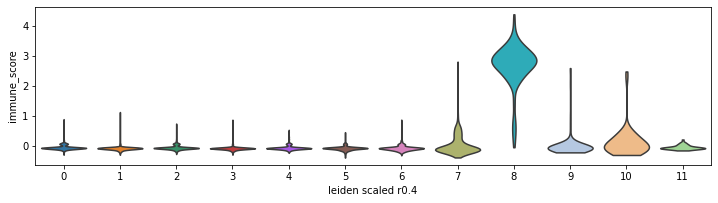

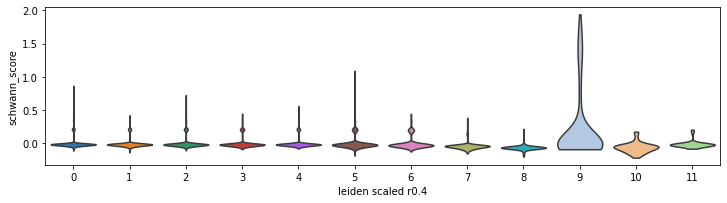

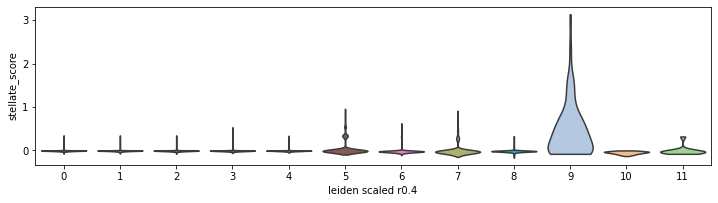

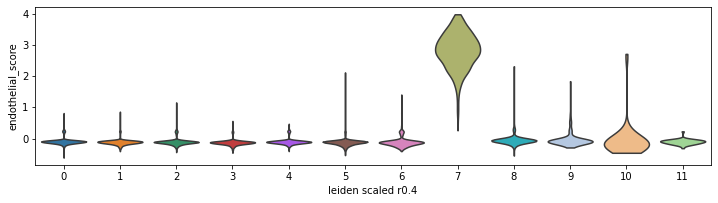

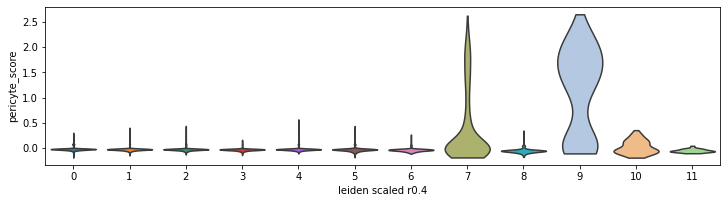

...

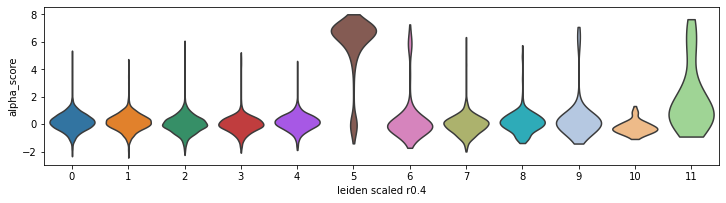

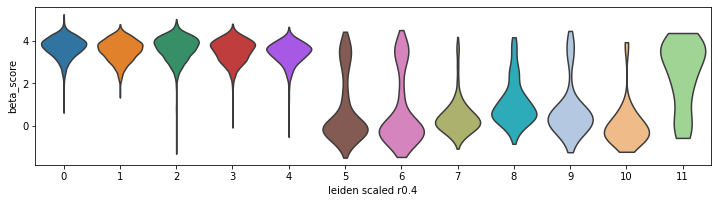

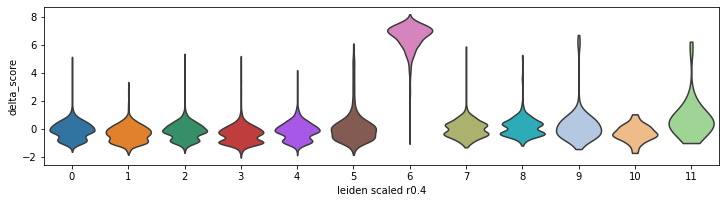

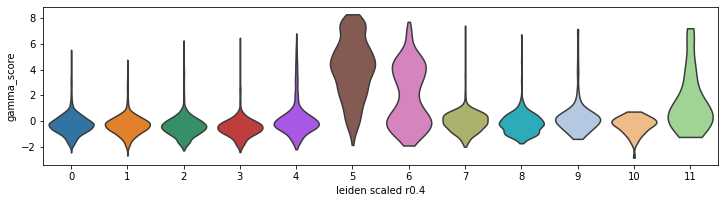

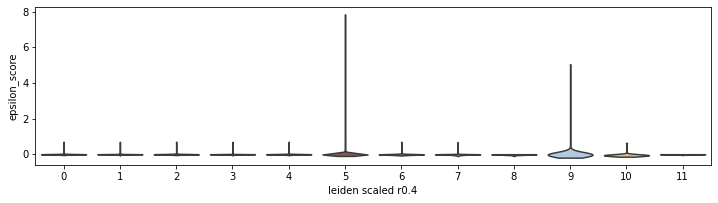

In [29]:
# Plot scores distribution across clusters
rcParams['figure.figsize']=(10,3)
for score in scores:
    sc.pl.violin(adata_rawnormalised, keys=score, groupby=clusters_col, use_raw=True, stripplot=False)

In [30]:
# Scores per cluster, scaled from 0 to 1 in each cell type
#C: Not very informative!
#scores_df=adata_rawnormalised.obs[scores+[clusters_col]]
#score_means=scores_df.groupby(clusters_col).mean()
#score_means=pd.DataFrame(pp.minmax_scale(score_means),index=score_means.index,columns=score_means.columns)
#sb.clustermap(score_means,yticklabels=1)

In [31]:
# Scores normalised to interval [0,1] for each cell type - so that they can be more easily compared
scores_df_norm=adata_rawnormalised.obs[scores]
scores_df_norm=pd.DataFrame(pp.minmax_scale(scores_df_norm),columns=scores_df_norm.columns,index=adata_rawnormalised.obs.index)

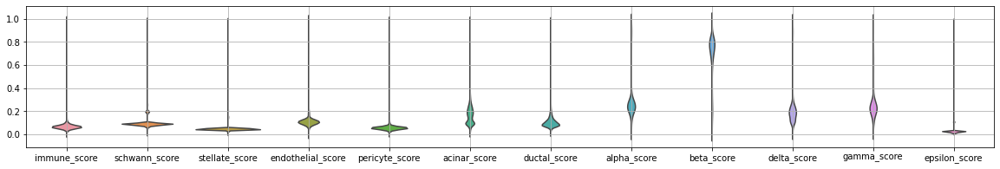

In [32]:
# Plot of normalised scores distribution in whole dataset, per cluster
rcParams['figure.figsize']=(20,3)
fig,ax=plt.subplots()
sb.violinplot(data=scores_df_norm,inner=None,ax=ax)
ax.grid()

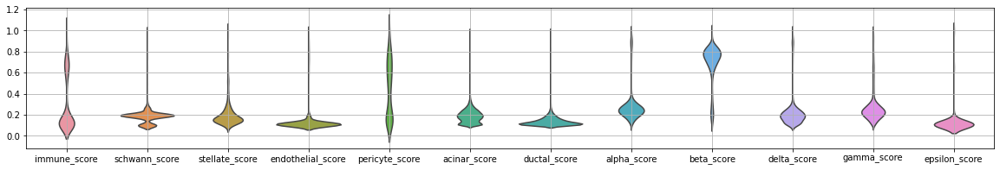

In [33]:
# Plot of normalised scores distribution, excluding low scores, per cluster
rcParams['figure.figsize']=(20,3)
fig,ax=plt.subplots()
sb.violinplot(data=scores_df_norm[scores_df_norm>0.1],inner=None,ax=ax)
ax.grid()

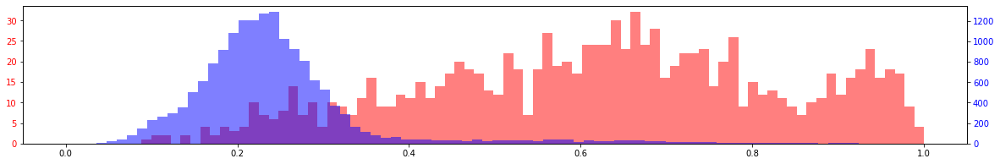

In [34]:
# Check gamma score in gamma cluster to reset the threshold
# Cluster 5 contains only partialy gamma cells
fig,ax1=plt.subplots()
a=ax1.hist(scores_df_norm.gamma_score[(adata_scl.obs[clusters_col]=='5').values],bins=80,alpha=0.5,color='r')
ax1.tick_params(axis='y', labelcolor='r')
ax2 = ax1.twinx()
a=ax2.hist(scores_df_norm.gamma_score[(adata_scl.obs[clusters_col]!='5').values],bins=80,alpha=0.5,color='b')
ax2.tick_params(axis='y', labelcolor='b')

In [35]:
# Thresholds for cell type assignemnt based on normalised scores
thresholds=[]
for col in scores_df_norm:
    threshold=0.4
    if col=='gamma_score':
        threshold=0.83
    elif col=='schwann_score':
        threshold=0.7
    elif col=='stellate_score':
        threshold=0.5
    elif col=='beta_score':
        threshold=0.5
    elif col =='alpha_score' :
        threshold=0.6
    elif col =='delta_score' :
        threshold=0.6
    thresholds.append(threshold)

In [36]:
# Assign cell types based on scores to each cell
assignment_df=scores_df_norm>=thresholds
assignment_df.columns=[col.replace('_score','') for col in scores_df_norm.columns] 

In [37]:
# Count of cells per cell type
assignment_df[[col.replace('_score','') for col in scores_df_norm.columns]].sum()

immune           305
schwann           15
stellate          14
endothelial      633
pericyte         231
acinar            66
ductal            56
alpha           1065
beta           14829
delta            799
gamma            232
epsilon            2
dtype: int64

#C: Epsilon cells will be dissregarded as there are so few (2).

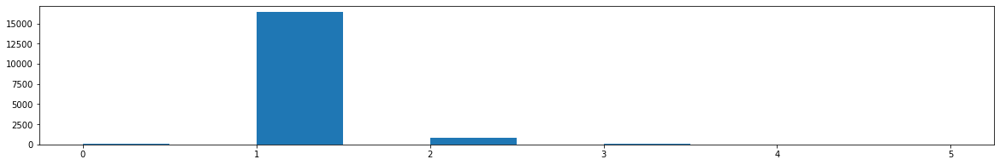

In [38]:
# How many cell types were annotated to each cell
a=plt.hist(assignment_df.sum(axis=1))

In [39]:
# For each cell make a (standard) string of annotated cell types: 
# e.g. each annotated cell type in the same order, separated by '_' when multiple cell types were annotated
type_unions=[]
for idx,row in assignment_df.iterrows():
    type_union=''
    for col in row.index:
        if row[col]:
            type_union=type_union+col+'_'
    if type_union=='':
        type_union='NA'
    type_unions.append(type_union.rstrip('_'))

In [40]:
# Add cell types strings of cells to scores/assignment DF
assignment_df['type_union']=type_unions
assignment_df[clusters_col]=adata_rawnormalised.obs[clusters_col].values

### Annotate clusters

In [41]:
# Make DF of marker gene expressions (normalised, log transformed), scaled for each gene to [0,1]
used_markers=list(dict.fromkeys([marker for marker_list in markers_selection.values() for marker in marker_list]))
gene_idx=adata_rawnormalised.raw.var_names.isin(used_markers)
genes=adata_rawnormalised.raw.var_names[gene_idx]
scaled_expression=pd.DataFrame(pp.minmax_scale(adata_rawnormalised.raw.X.toarray()[:, gene_idx]),
                               columns=genes,index=adata_rawnormalised.obs.index
                              )[[marker for marker in used_markers if marker in genes]]

In [42]:
def add_category(df,idxs,col,category):
    """
    Add single value to multiple rows of DF column (useful when column might be categorical). 
    If column is categorical the value is beforehand added in the list of present categories 
    (required for categorical columns). 
    :param df: DF to which to add values
    :param idxs: Index names of rows where the value should be assigned to the column.
    :param col: Column to which to add the value.
    :param category: The value to add to rows,column.
    """
    # If column is already present, is categorical and value is not in categories add the value to categories first.
    if col in df.columns and df[col].dtype.name=='category' and category not in df[col].cat.categories:
        df[col] = df[col].cat.add_categories([category])
    df.loc[idxs,col]=category

In [43]:
def subcluster(adata_cluster,res,original_cluster,assignment_df_temp,clusters_name_prefix='leiden_scaled_r'):
    """
    Cluster adata and add reult into cell type assignment DF. Plot the clustering on UMAP.
    Add name of the original cluster to which the adata belongs to new cluster names.
    Cluster column name: clusters_name_prefix+str(res) 
    :param adata_cluster: Adata (with already computed neighbours and UMAP) to cluster with leiden clustering. 
    :param res: Leiden resolution
    :param original_cluster: Original cluster name, new clusters are named 'original cluster'+'_'+'new cluster'
    :param assignment_df_temp: assignment_df to which to add clusters - should have same row order as adata
    :param clusters_name_prefix: Prefix for cluster column name.
    """
    clusters_col_name=clusters_name_prefix+str(res)
    sc.tl.leiden(adata_cluster, resolution=res, key_added=clusters_col_name, directed=True, use_weights=True)
    adata_cluster.obs[clusters_col_name]=[original_cluster+'_'+subcluster 
                                                 for subcluster in adata_cluster.obs[clusters_col_name]]
    sc.pl.umap(adata_cluster,color=clusters_col_name)
    time.sleep(1.0)
    
    assignment_df_temp['leiden_scaled_r'+str(res)]=adata_cluster.obs['leiden_scaled_r'+str(res)].values
    
def get_cluster_data(adata_original, cluster,cluster_col,assignment_df):
    """
    Subset adata and assignment_df to cluster.
    :param adata_original: Adata to subset.
    :param  cluster: Cluster for which to extract the data.
    :param cluster_col: Column where clusters are listed. Should be present in adata and assignment_df.
    :param assignment_df: DF with cell type assignmnets in column 'type_union' and cluster info. Should have index names
    that are present in adata.obs.index.
    :return: Subset of adata, assignment_df
    """
    adata_temp=adata_original[adata_original.obs[cluster_col]==cluster].copy()
    assignment_df_temp=pd.DataFrame(assignment_df.loc[adata_temp.obs.index,'type_union'])
    return adata_temp, assignment_df_temp

def cluster_annotate(assignment_df,cluster_col,present_threshold,nomain_threshold,
                     save,cluster_annotation,adata_main):
    """
    Loop through clusters, check present cell types and if there is no main cell type plot expression and QC metrics.
    For each cluster list proportion of present cell types.
    Expression (normalised, log transformed, [0,1] per gene scaled) is plotted for marker genes across cells (heatmap).
    QC metrics are plotted as scatterplot of N genes and N counts with cluster cells overlayed over all cels.
    :param assignment_df: DF with cell type assignment in column 'type_union' and cluster assignment.
    :param cluster_col: Cluster column name in assignment_df.
    :param present_threshold: Count among present cell types each cell type present if it represents 
    at least present_threshold proportion of cells in cluster. 
    :param nomain_threshold: If only 1 cell type was selected with present_threshold and 
    no cell type is present at proportion at least nomain_threshold add 'other' to annotated cell types list.
    :param save: Save cluster information to adata_main (column 'cluster') and cell types list to cluster_annotation.
    :param cluster_annotation: Dict where each cluster (key) has list of annotated cell types (value).
    :param adata_main: Add cluster to adata_main.obs.cluster. Use this adata for plotting of QC mettrics (for this a
    column 'temp_selected' is added.)
    """
    for group in assignment_df[['type_union',cluster_col]].groupby(cluster_col):
        types_summary=group[1].type_union.value_counts(normalize=True)
        present=list(types_summary[types_summary >= present_threshold].index)
        if len(present)==1 and types_summary.max() < nomain_threshold:
            present.append('other')
            
        if save:
            cluster_annotation[group[0]]=present
            add_category(df=adata_main.obs,idxs=group[1].index,col='cluster',category=group[0])
        
        print('\nCluster:',group[0],'\tsize:',group[1].shape[0])    
        print('Present:',present)
        print(types_summary)
        
        #present_nonna=[cell_type for cell_type in present if cell_type !='NA']
        #if len(present_nonna)!=1:
        if len(present)!=1 or present==['NA']:
            sb.clustermap(
                pd.DataFrame(scaled_expression.loc[group[1].index,:]),
                col_cluster=False,xticklabels=1,yticklabels=False,figsize=(7,5),vmin=0,vmax=1)
            plt.title('Cluster: '+group[0]+' assigned:'+str(present))
            adata_main.obs['temp_selected']=adata_main.obs.index.isin(group[1].index)
            rcParams['figure.figsize']=(5,5)
            p1 = sc.pl.scatter(adata_main, 'n_counts', 'n_genes', color='temp_selected', size=40,color_map='viridis')
            time.sleep(1.0)

def save_cluster_annotation(adata,cluster_name,cell_types:list,cell_names):
    """
    Save cluster information for a set of cells to cluster_annotation (from outer scope) dictionary and specified adata.
    :param adata: Adata to which to save cluster name for cells. 
    Cluster information is saved to adata.obs in 'cluster' column.
    :param cluster_name: Name of the cluster.
    :param cell_types: List of cell types annotated to the cluster.
    :param cell_names: Cell names (matching adata.obs.index) to which the new cluster is asigned.
    """
    cluster_annotation[cluster_name]=cell_types
    add_category(df=adata.obs,idxs=cell_names,col='cluster',category=cluster_name)

In [44]:
#Save cell types annotated to each cluster
cluster_annotation=dict()


Cluster: 0 	size: 4190
Present: ['beta']
beta                 0.993556
acinar_beta_delta    0.001909
alpha_beta           0.001671
acinar_beta          0.001432
NA                   0.000955
beta_delta           0.000239
alpha_beta_delta     0.000239
Name: type_union, dtype: float64

Cluster: 1 	size: 2647
Present: ['beta']
beta          0.998867
alpha_beta    0.000756
NA            0.000378
Name: type_union, dtype: float64

Cluster: 2 	size: 2647
Present: ['beta']
beta                0.989044
NA                  0.007556
beta_delta          0.001511
acinar_beta         0.000756
alpha_beta          0.000756
alpha_beta_delta    0.000378
Name: type_union, dtype: float64

Cluster: 3 	size: 2493
Present: ['beta']
beta          0.982351
NA            0.008022
alpha_beta    0.007220
beta_delta    0.002006
beta_gamma    0.000401
Name: type_union, dtype: float64

Cluster: 4 	size: 2331
Present: ['beta']
beta          0.990562
NA            0.007722
alpha_beta    0.000858
beta_gamma    0.00042

... storing 'cluster' as categorical


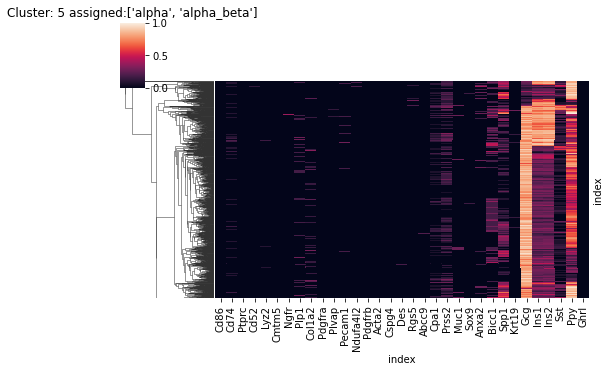

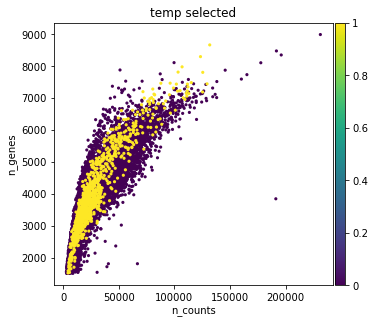


Cluster: 6 	size: 753
Present: ['delta', 'beta_delta']
delta                     0.669323
beta_delta                0.212483
alpha_delta               0.049137
delta_gamma               0.014608
alpha_beta_delta          0.013280
alpha_delta_gamma         0.013280
NA                        0.007968
beta                      0.007968
acinar_delta              0.003984
beta_delta_gamma          0.002656
acinar_delta_gamma        0.001328
gamma                     0.001328
alpha                     0.001328
endothelial_beta_delta    0.001328
Name: type_union, dtype: float64


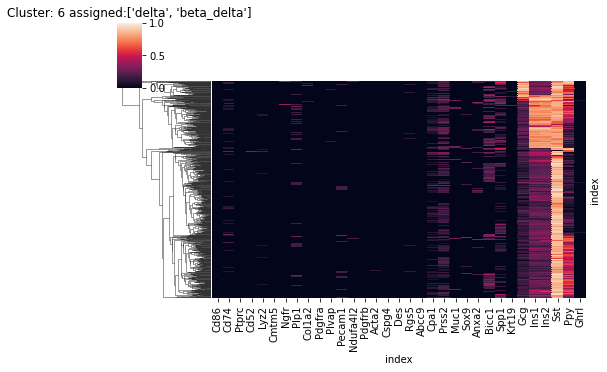

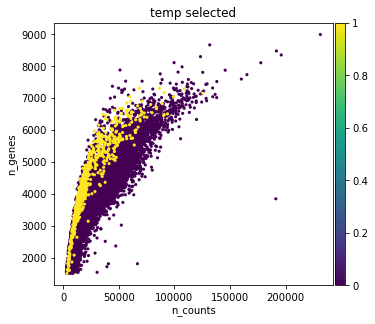


Cluster: 7 	size: 634
Present: ['endothelial', 'endothelial_pericyte']
endothelial                         0.746057
endothelial_pericyte                0.176656
endothelial_beta                    0.028391
endothelial_pericyte_beta           0.011041
immune_endothelial_pericyte         0.007886
NA                                  0.006309
beta                                0.006309
immune_endothelial                  0.003155
immune_endothelial_pericyte_beta    0.001577
endothelial_alpha_beta_delta        0.001577
endothelial_beta_delta              0.001577
endothelial_beta_gamma              0.001577
endothelial_alpha                   0.001577
endothelial_pericyte_delta          0.001577
endothelial_alpha_beta              0.001577
endothelial_pericyte_alpha_beta     0.001577
endothelial_alpha_gamma             0.001577
Name: type_union, dtype: float64


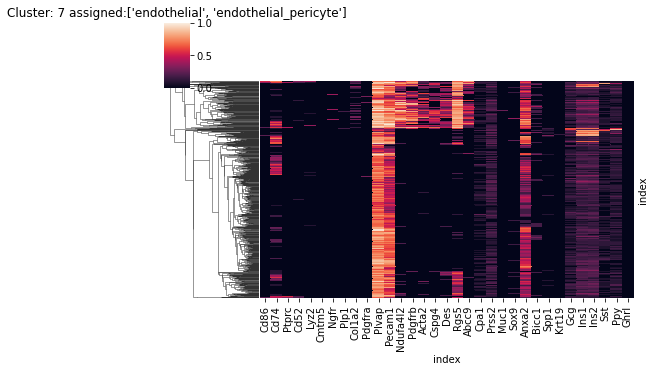

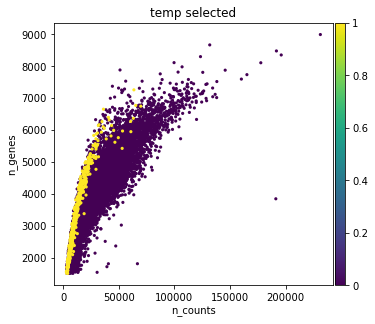


Cluster: 8 	size: 315
Present: ['immune', 'immune_beta']
immune                           0.780952
immune_beta                      0.130159
beta                             0.050794
NA                               0.022222
immune_endothelial               0.006349
immune_alpha_beta                0.003175
immune_alpha_beta_delta_gamma    0.003175
alpha_beta                       0.003175
Name: type_union, dtype: float64


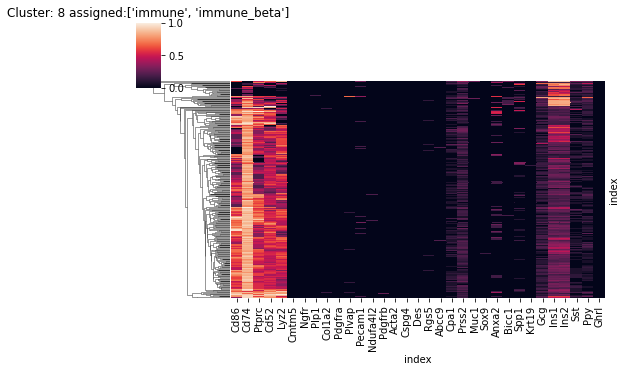

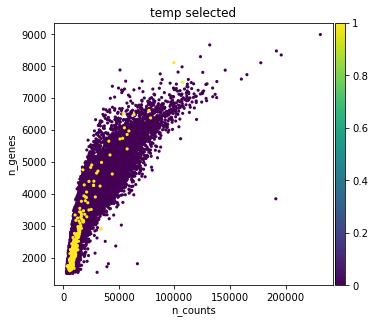


Cluster: 9 	size: 163
Present: ['pericyte', 'NA']
pericyte                            0.533742
NA                                  0.104294
stellate                            0.073620
pericyte_beta                       0.067485
schwann                             0.049080
beta                                0.036810
alpha                               0.018405
immune_pericyte                     0.012270
schwann_beta                        0.012270
schwann_alpha                       0.012270
delta                               0.012270
immune_schwann                      0.006135
pericyte_delta_gamma                0.006135
alpha_delta                         0.006135
alpha_gamma                         0.006135
stellate_beta                       0.006135
pericyte_alpha                      0.006135
schwann_delta                       0.006135
schwann_stellate                    0.006135
immune_endothelial_pericyte_beta    0.006135
pericyte_beta_delta                 0.006135
alph

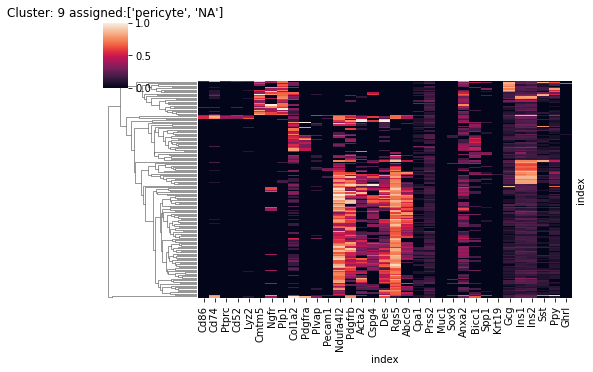

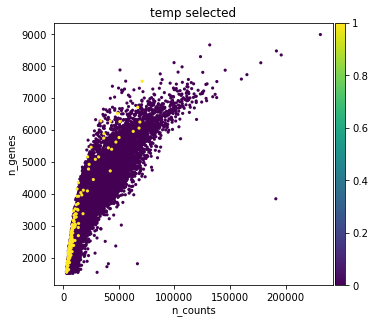


Cluster: 10 	size: 57
Present: ['ductal']
ductal                0.842105
ductal_beta           0.052632
endothelial_ductal    0.035088
immune_ductal         0.035088
NA                    0.017544
acinar_ductal         0.017544
Name: type_union, dtype: float64

Cluster: 11 	size: 44
Present: ['acinar_beta', 'acinar_alpha', 'acinar']
acinar_beta           0.636364
acinar_alpha          0.113636
acinar                0.113636
acinar_alpha_beta     0.022727
acinar_beta_delta     0.022727
acinar_beta_gamma     0.022727
acinar_alpha_gamma    0.022727
acinar_gamma          0.022727
acinar_alpha_delta    0.022727
Name: type_union, dtype: float64


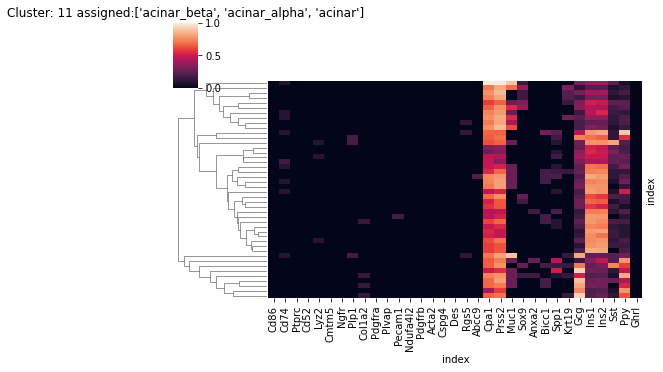

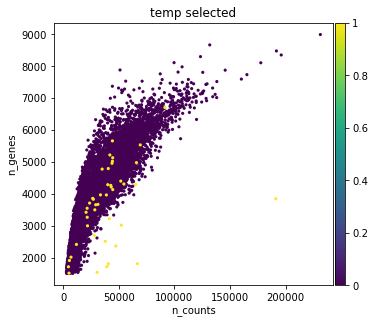

In [45]:
# Display cell type annotation distribution of each cluster.
cluster_annotate(assignment_df=assignment_df,
                 cluster_col=clusters_col,present_threshold=0.1,nomain_threshold=0.7,
                     save=True,cluster_annotation=cluster_annotation,adata_main=adata_rawnormalised)

In [46]:
# Correct annotation
cluster_annotation['8']=['immune']
#cluster_annotation['11']=['acinar']

**** Original cluster 5


/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.3' as categorical


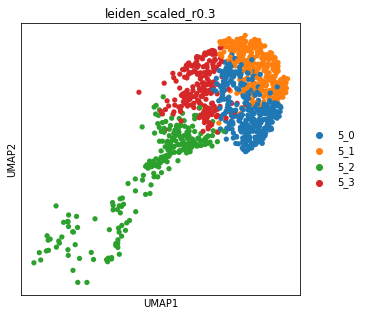


Cluster: 5_0 	size: 321
Present: ['alpha']
alpha          0.900312
alpha_gamma    0.087227
alpha_beta     0.009346
gamma          0.003115
Name: type_union, dtype: float64

Cluster: 5_1 	size: 321
Present: ['alpha']
alpha          0.919003
alpha_gamma    0.056075
alpha_beta     0.018692
alpha_delta    0.006231
Name: type_union, dtype: float64

Cluster: 5_2 	size: 237
Present: ['alpha_beta', 'beta']
alpha_beta                0.645570
beta                      0.164557
alpha                     0.075949
beta_gamma                0.029536
alpha_beta_delta          0.029536
alpha_gamma               0.012658
alpha_beta_gamma          0.012658
NA                        0.008439
gamma                     0.008439
beta_delta                0.008439
endothelial_alpha_beta    0.004219
Name: type_union, dtype: float64


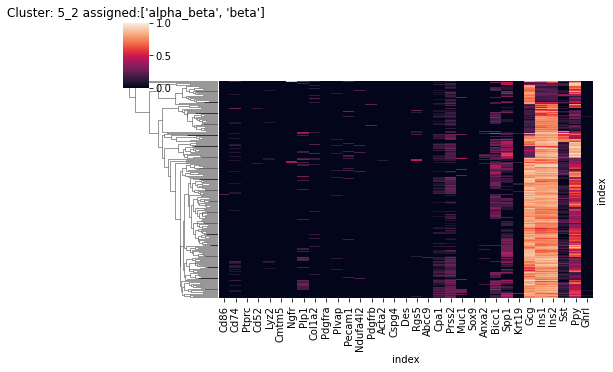

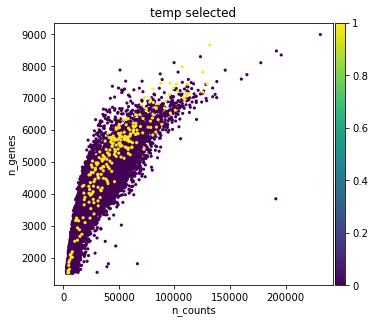


Cluster: 5_3 	size: 208
Present: ['gamma', 'alpha', 'alpha_gamma']
gamma                     0.355769
alpha                     0.230769
alpha_gamma               0.225962
alpha_beta                0.057692
alpha_beta_delta          0.043269
beta_gamma                0.024038
alpha_beta_gamma          0.014423
alpha_delta               0.009615
delta_gamma               0.009615
beta                      0.004808
acinar_gamma              0.004808
alpha_delta_gamma         0.004808
beta_epsilon              0.004808
alpha_beta_delta_gamma    0.004808
beta_delta_gamma          0.004808
Name: type_union, dtype: float64


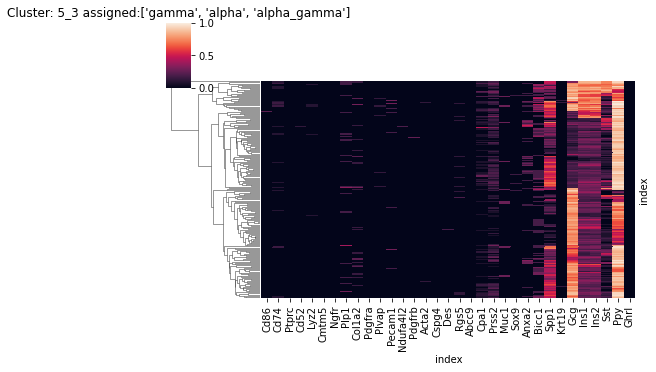

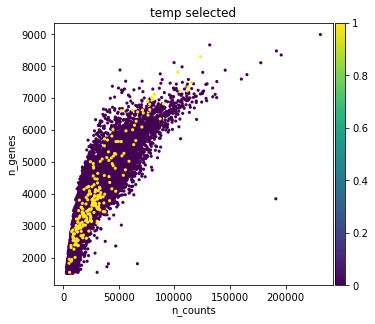

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.3' as categorical


**** Original cluster 6


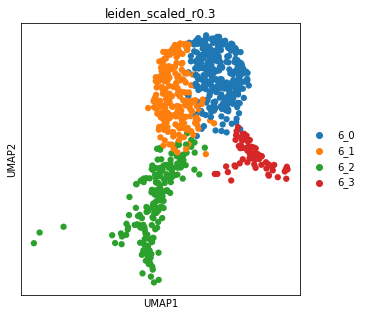


Cluster: 6_0 	size: 284
Present: ['delta']
delta               0.989437
acinar_delta        0.003521
alpha_beta_delta    0.003521
beta_delta          0.003521
Name: type_union, dtype: float64

Cluster: 6_1 	size: 212
Present: ['delta']
delta                 0.957547
beta_delta            0.018868
acinar_delta          0.009434
alpha_delta           0.004717
acinar_delta_gamma    0.004717
delta_gamma           0.004717
Name: type_union, dtype: float64

Cluster: 6_2 	size: 190
Present: ['beta_delta', 'other']
beta_delta                0.815789
delta                     0.094737
NA                        0.031579
beta                      0.031579
alpha_beta_delta          0.021053
endothelial_beta_delta    0.005263
Name: type_union, dtype: float64


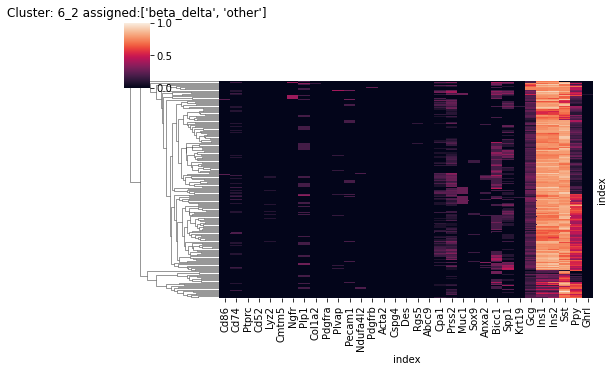

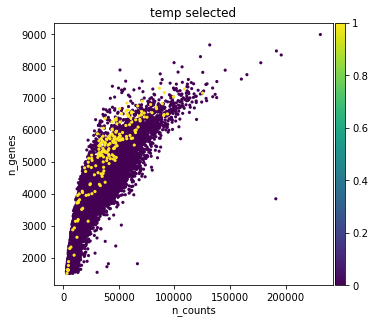


Cluster: 6_3 	size: 67
Present: ['alpha_delta', 'delta_gamma', 'alpha_delta_gamma']
alpha_delta          0.537313
delta_gamma          0.149254
alpha_delta_gamma    0.149254
alpha_beta_delta     0.074627
delta                0.029851
beta_delta_gamma     0.029851
gamma                0.014925
alpha                0.014925
Name: type_union, dtype: float64


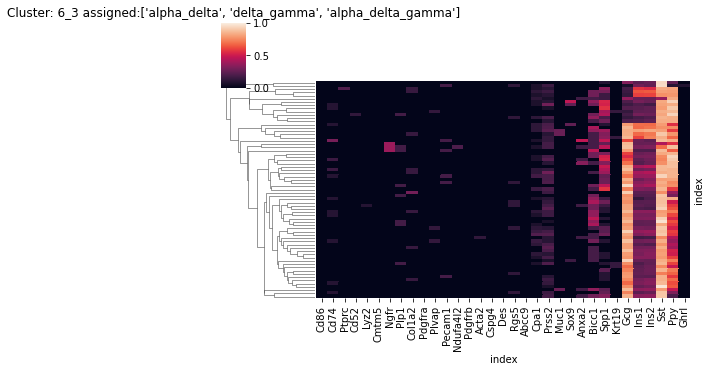

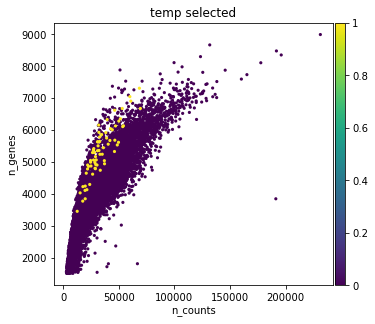

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.3' as categorical


**** Original cluster 7


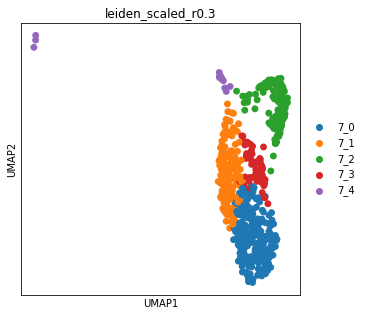


Cluster: 7_0 	size: 277
Present: ['endothelial']
endothelial                    0.953069
endothelial_pericyte           0.028881
endothelial_beta               0.010830
immune_endothelial             0.003610
immune_endothelial_pericyte    0.003610
Name: type_union, dtype: float64

Cluster: 7_1 	size: 160
Present: ['endothelial']
endothelial          0.93125
endothelial_beta     0.05000
NA                   0.01250
endothelial_alpha    0.00625
Name: type_union, dtype: float64

Cluster: 7_2 	size: 125
Present: ['endothelial_pericyte', 'other']
endothelial_pericyte                0.824
endothelial                         0.056
endothelial_pericyte_beta           0.056
immune_endothelial_pericyte         0.032
endothelial_pericyte_delta          0.008
immune_endothelial_pericyte_beta    0.008
NA                                  0.008
endothelial_pericyte_alpha_beta     0.008
Name: type_union, dtype: float64


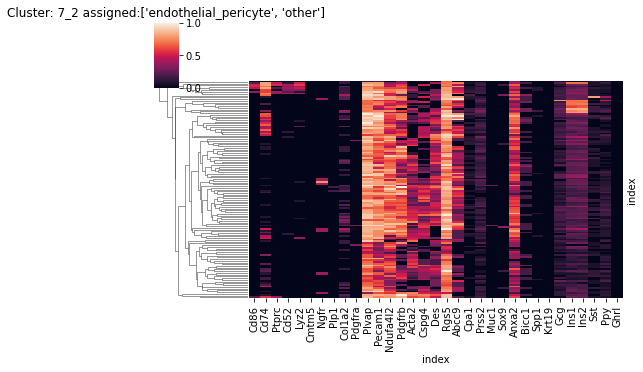

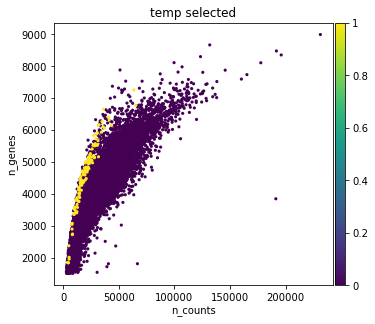


Cluster: 7_3 	size: 57
Present: ['endothelial']
endothelial             0.929825
endothelial_beta        0.017544
immune_endothelial      0.017544
NA                      0.017544
endothelial_pericyte    0.017544
Name: type_union, dtype: float64

Cluster: 7_4 	size: 15
Present: ['endothelial_beta', 'beta']
endothelial_beta                0.400000
beta                            0.266667
endothelial_alpha_beta          0.066667
endothelial_beta_delta          0.066667
endothelial_alpha_gamma         0.066667
endothelial_alpha_beta_delta    0.066667
endothelial_beta_gamma          0.066667
Name: type_union, dtype: float64


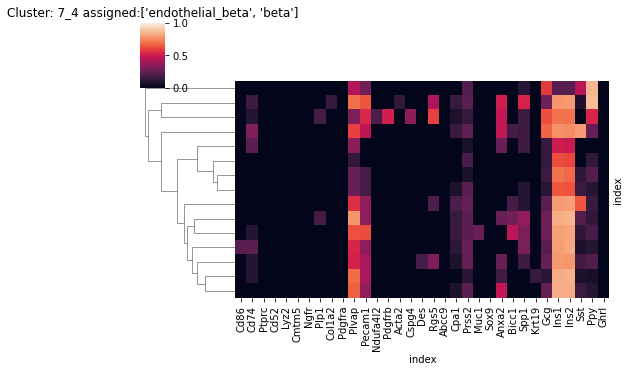

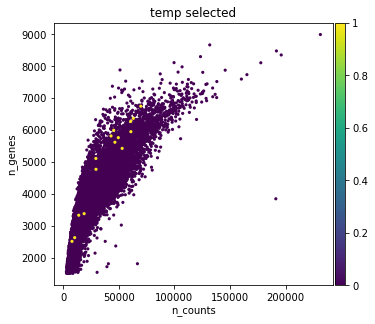

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.3' as categorical


**** Original cluster 9


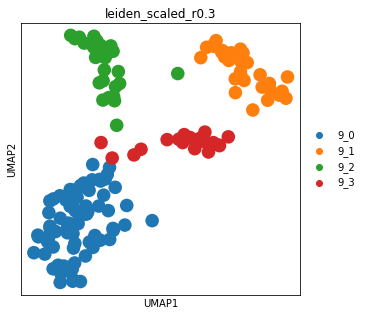


Cluster: 9_0 	size: 79
Present: ['pericyte']
pericyte           0.987342
immune_pericyte    0.012658
Name: type_union, dtype: float64

Cluster: 9_1 	size: 33
Present: ['schwann', 'NA']
schwann                 0.242424
NA                      0.181818
beta                    0.090909
alpha                   0.090909
schwann_beta            0.060606
delta                   0.060606
schwann_alpha           0.060606
alpha_gamma             0.030303
schwann_stellate        0.030303
schwann_delta           0.030303
immune_schwann          0.030303
pericyte_delta_gamma    0.030303
alpha_delta             0.030303
alpha_epsilon           0.030303
Name: type_union, dtype: float64


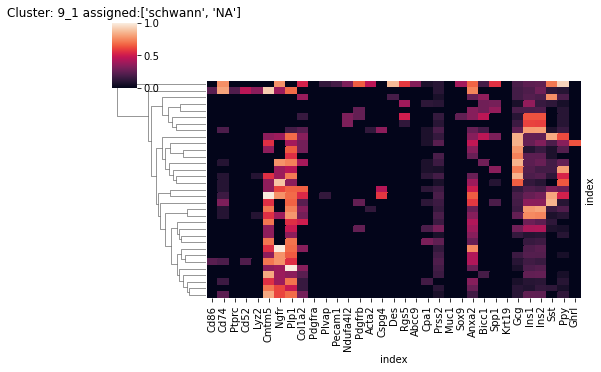

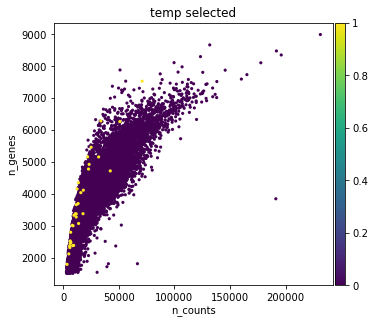


Cluster: 9_2 	size: 30
Present: ['stellate', 'NA', 'pericyte']
stellate         0.400000
NA               0.366667
pericyte         0.200000
stellate_beta    0.033333
Name: type_union, dtype: float64


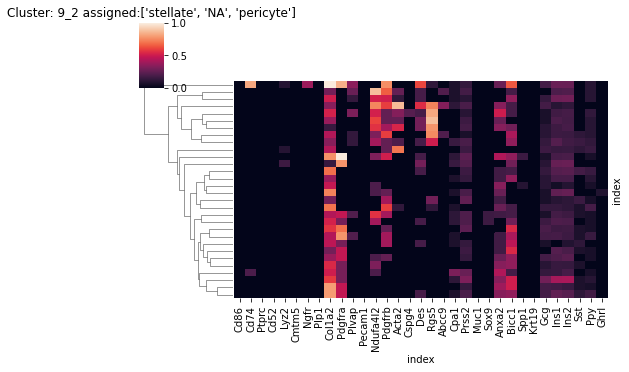

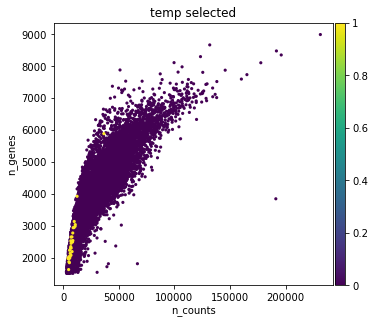


Cluster: 9_3 	size: 21
Present: ['pericyte_beta', 'pericyte', 'beta']
pericyte_beta                       0.523810
pericyte                            0.142857
beta                                0.142857
immune_pericyte                     0.047619
pericyte_alpha                      0.047619
pericyte_beta_delta                 0.047619
immune_endothelial_pericyte_beta    0.047619
Name: type_union, dtype: float64


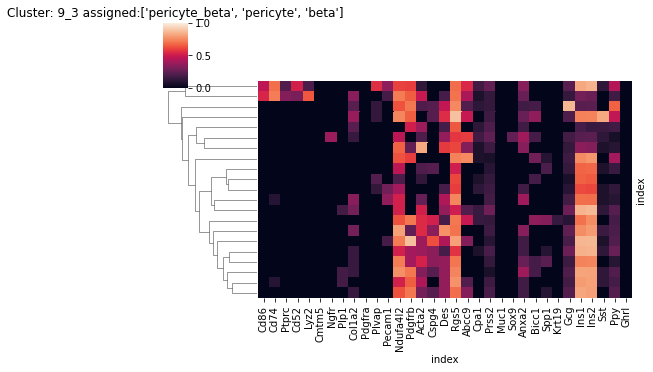

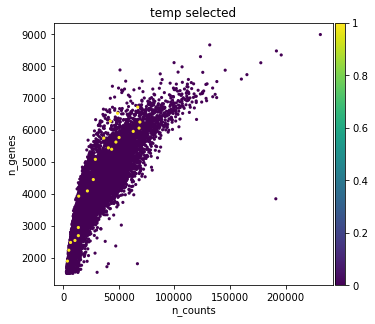

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.3' as categorical


**** Original cluster 11


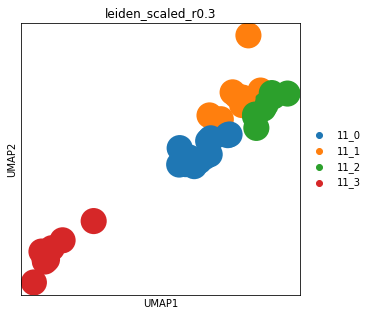


Cluster: 11_0 	size: 16
Present: ['acinar_beta', 'acinar']
acinar_beta          0.8125
acinar               0.1250
acinar_beta_delta    0.0625
Name: type_union, dtype: float64


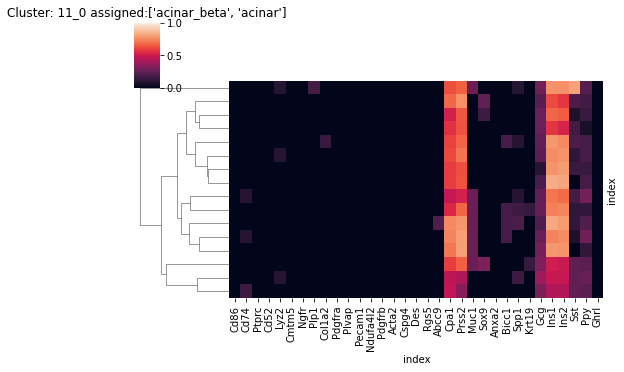

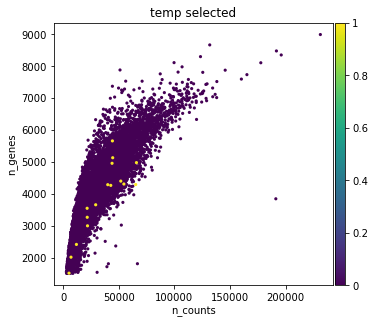


Cluster: 11_1 	size: 11
Present: ['acinar_alpha', 'other']
acinar_alpha          0.454545
acinar_alpha_beta     0.090909
acinar_alpha_delta    0.090909
acinar                0.090909
acinar_alpha_gamma    0.090909
acinar_gamma          0.090909
acinar_beta_gamma     0.090909
Name: type_union, dtype: float64


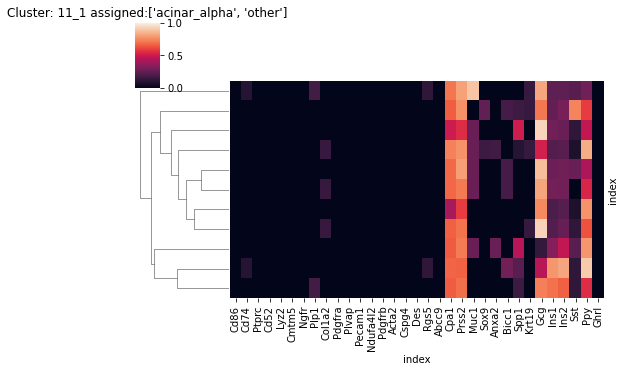

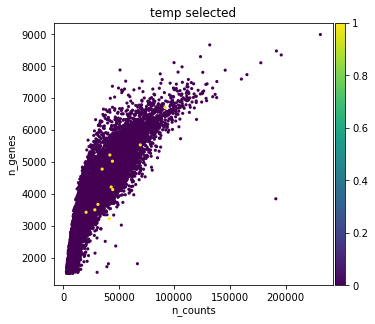


Cluster: 11_2 	size: 9
Present: ['acinar_beta', 'acinar']
acinar_beta    0.777778
acinar         0.222222
Name: type_union, dtype: float64


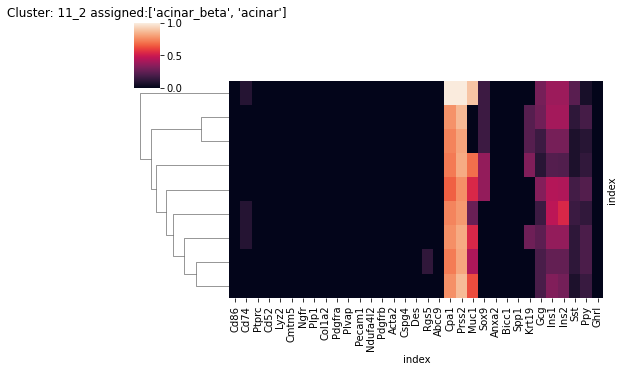

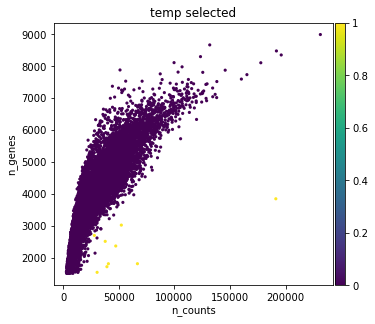


Cluster: 11_3 	size: 8
Present: ['acinar_beta']
acinar_beta    1.0
Name: type_union, dtype: float64


In [47]:
# recluster clusters that previously had less or more than 1 annotted cell type (exclusing NA and other).
for cluster in sorted(list(adata_rawnormalised.obs['cluster'].unique()),key=int):
    if len(cluster_annotation[cluster]) != 1 or len(
        [cell_type for cell_type in cluster_annotation[cluster] if cell_type !='NA' and cell_type !='other']) == 0:
        print('**** Original cluster',cluster)
        res=0.3
        adata_temp,assignment_df_temp=get_cluster_data(adata_original=adata_rawnormalised, cluster=cluster,
                                                       cluster_col='cluster',assignment_df=assignment_df)
        subcluster(adata_cluster=adata_temp,res=res,original_cluster=cluster,assignment_df_temp=assignment_df_temp)
        cluster_annotate(assignment_df=assignment_df_temp,
                         cluster_col='leiden_scaled_r'+str(res),
                         # Use more leanient condition as this is already subclustered - 
                        # otherwise data could be in some cases subclustered almost idefinitely
                         present_threshold=0.1,nomain_threshold=0.9,
                     save=True,cluster_annotation=cluster_annotation,adata_main= adata_rawnormalised)

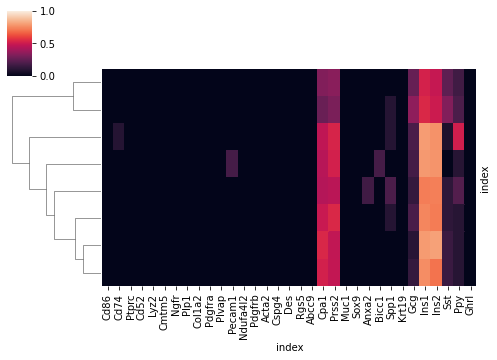

In [48]:
# Expression of markers in cluster 11_3
sb.clustermap(pd.DataFrame(scaled_expression.loc[adata_rawnormalised.obs.query('cluster=="11_3"').index,:]), 
                  row_cluster=True, col_cluster=False,xticklabels=1,yticklabels=False,figsize=(7,5),vmin=0,vmax=1)

In [49]:
# Correct entries in cluster_annotation dict - all clusters that do not have exactly one entry will be assigned 'NA'
# If cluster is to be removed add 'remove'

cluster_annotation['6_2']=['beta_delta']
cluster_annotation['7_2']=['endothelial_pericyte']
cluster_annotation['7_4']=['endothelial']
cluster_annotation['9_3']=['pericyte']
cluster_annotation['11_0']=['acinar']
cluster_annotation['11_1']=['acinar']
cluster_annotation['11_2']=['acinar']
cluster_annotation['11_3']=['acinar_low']

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.5' as categorical


**** Original cluster 5_2


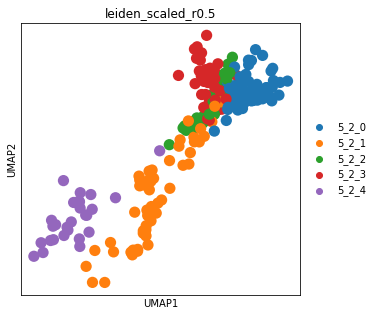


Cluster: 5_2_0 	size: 71
Present: ['alpha_beta', 'alpha']
alpha_beta     0.690141
alpha          0.239437
alpha_gamma    0.042254
gamma          0.028169
Name: type_union, dtype: float64


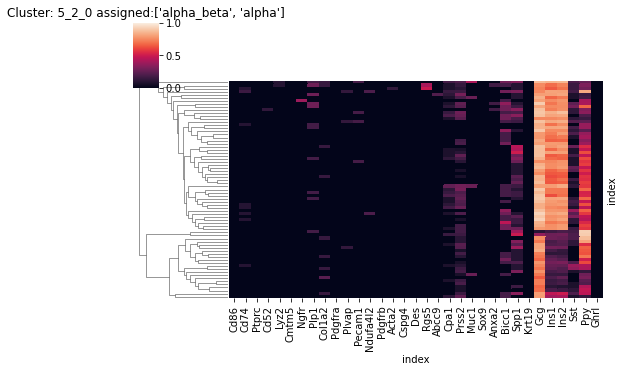

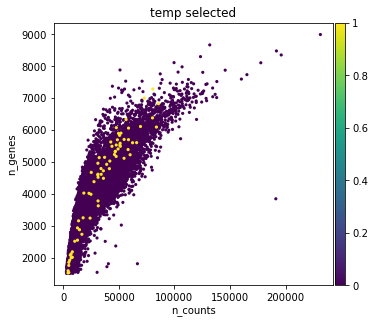


Cluster: 5_2_1 	size: 52
Present: ['alpha_beta', 'other']
alpha_beta          0.730769
beta                0.173077
alpha_beta_delta    0.057692
beta_gamma          0.019231
alpha               0.019231
Name: type_union, dtype: float64


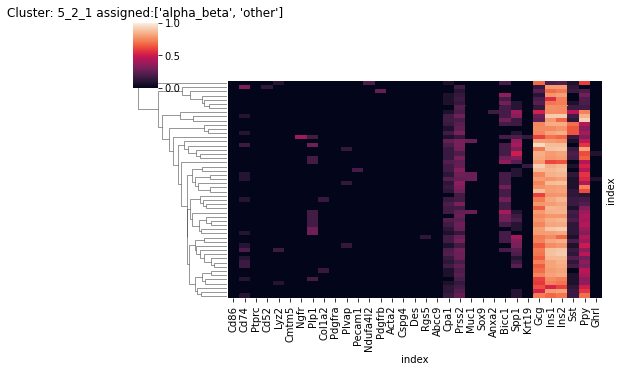

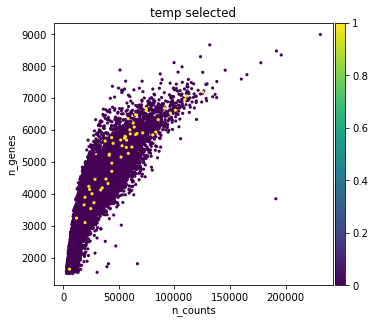


Cluster: 5_2_2 	size: 52
Present: ['alpha_beta']
alpha_beta          0.942308
alpha_beta_gamma    0.038462
beta                0.019231
Name: type_union, dtype: float64

Cluster: 5_2_3 	size: 35
Present: ['alpha_beta', 'beta']
alpha_beta                0.400000
beta                      0.200000
beta_gamma                0.142857
alpha_beta_delta          0.114286
NA                        0.057143
endothelial_alpha_beta    0.028571
alpha_beta_gamma          0.028571
beta_delta                0.028571
Name: type_union, dtype: float64


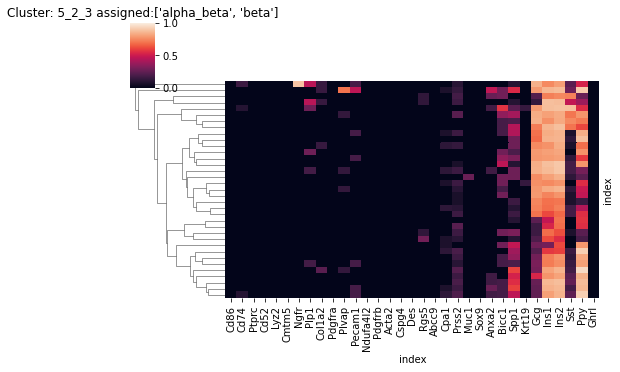

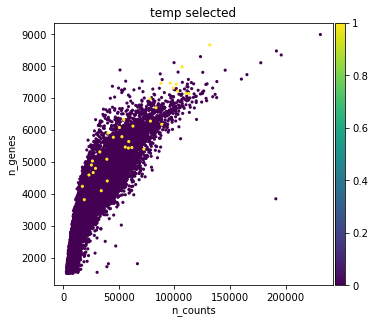

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.5' as categorical



Cluster: 5_2_4 	size: 27
Present: ['beta']
beta          0.814815
alpha_beta    0.111111
beta_delta    0.037037
beta_gamma    0.037037
Name: type_union, dtype: float64
**** Original cluster 5_3


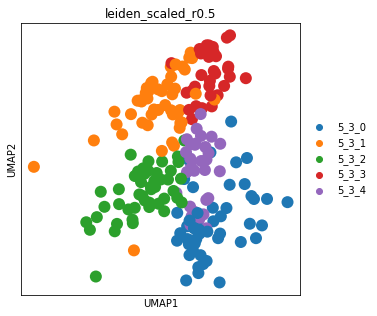


Cluster: 5_3_0 	size: 49
Present: ['gamma', 'alpha_gamma']
gamma               0.489796
alpha_gamma         0.265306
alpha               0.122449
alpha_beta_gamma    0.061224
alpha_beta          0.020408
acinar_gamma        0.020408
beta_gamma          0.020408
Name: type_union, dtype: float64


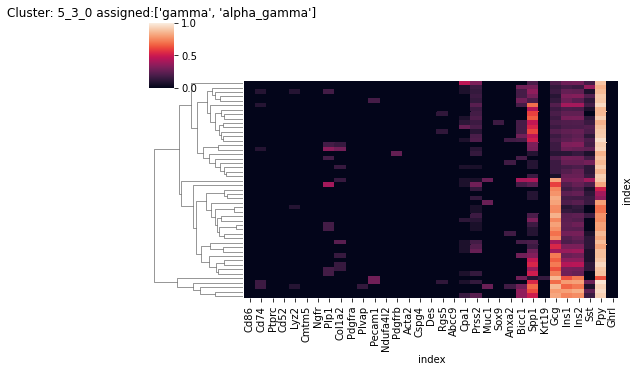

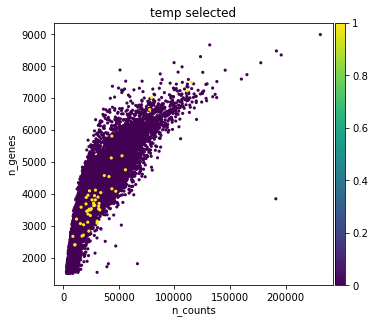


Cluster: 5_3_1 	size: 48
Present: ['gamma', 'alpha_gamma']
gamma                     0.395833
alpha_gamma               0.312500
alpha                     0.083333
alpha_beta_delta          0.041667
delta_gamma               0.041667
beta_gamma                0.041667
alpha_beta                0.020833
alpha_beta_delta_gamma    0.020833
beta                      0.020833
beta_epsilon              0.020833
Name: type_union, dtype: float64


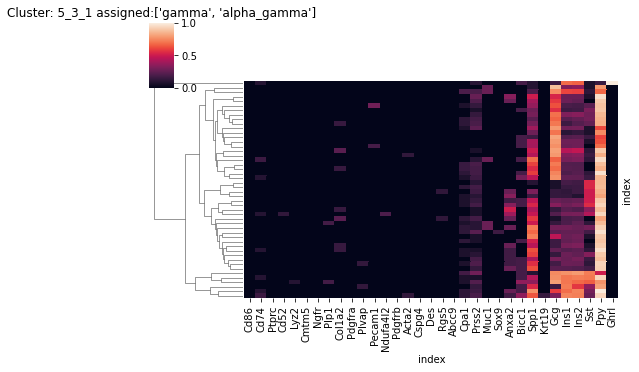

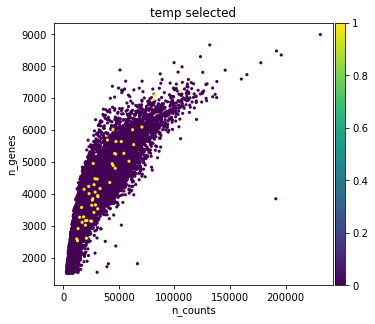


Cluster: 5_3_2 	size: 46
Present: ['gamma', 'other']
gamma               0.608696
alpha_beta_delta    0.152174
alpha_gamma         0.065217
alpha               0.065217
alpha_beta          0.043478
beta_gamma          0.043478
beta_delta_gamma    0.021739
Name: type_union, dtype: float64


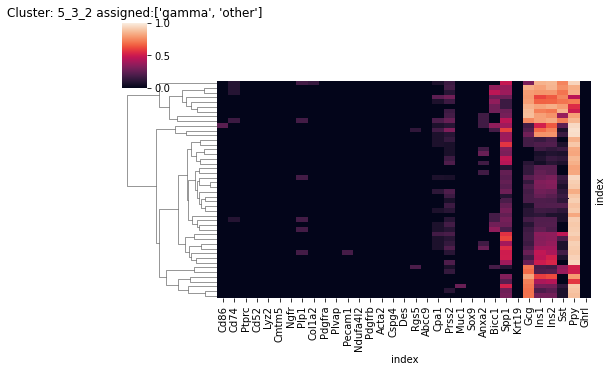

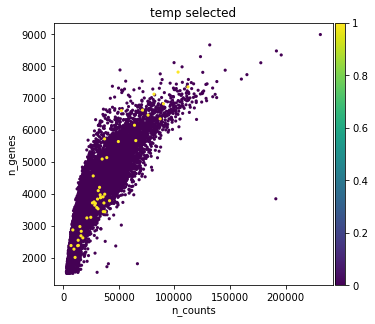


Cluster: 5_3_3 	size: 33
Present: ['alpha', 'alpha_gamma']
alpha                0.424242
alpha_gamma          0.393939
gamma                0.090909
alpha_delta          0.060606
alpha_delta_gamma    0.030303
Name: type_union, dtype: float64


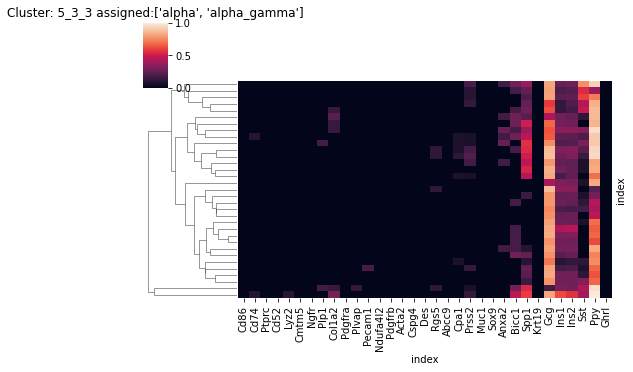

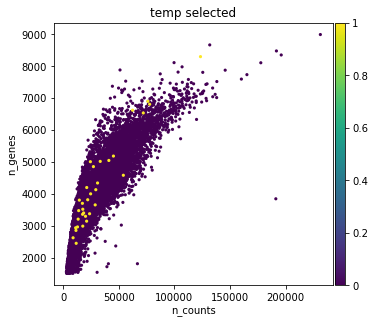


Cluster: 5_3_4 	size: 32
Present: ['alpha', 'alpha_beta']
alpha          0.65625
alpha_beta     0.25000
alpha_gamma    0.09375
Name: type_union, dtype: float64


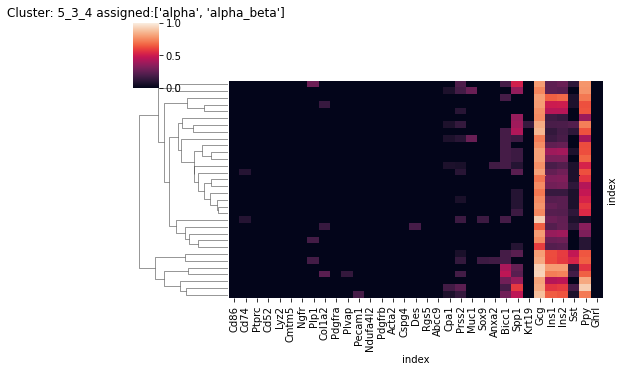

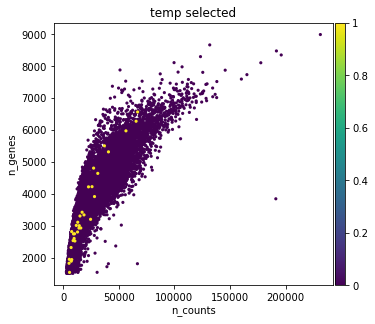

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.5' as categorical


**** Original cluster 6_3


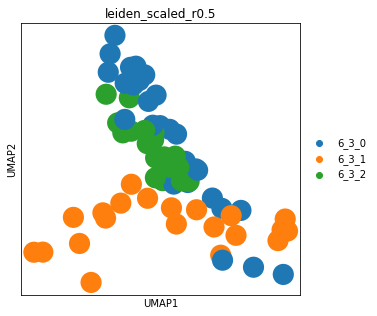


Cluster: 6_3_0 	size: 28
Present: ['alpha_delta', 'alpha_delta_gamma']
alpha_delta          0.535714
alpha_delta_gamma    0.214286
delta_gamma          0.107143
delta                0.071429
alpha_beta_delta     0.035714
gamma                0.035714
Name: type_union, dtype: float64


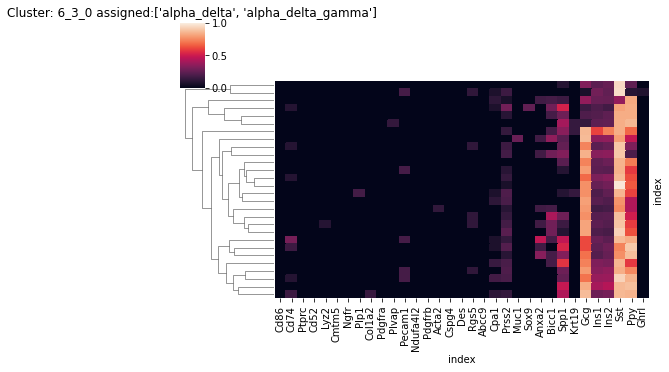

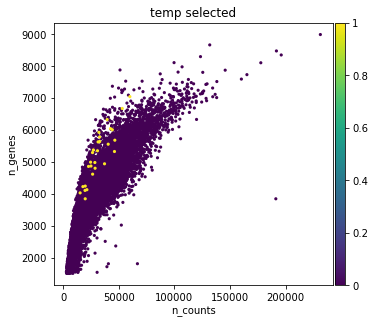


Cluster: 6_3_1 	size: 21
Present: ['delta_gamma', 'alpha_delta']
delta_gamma          0.333333
alpha_delta          0.285714
alpha_beta_delta     0.190476
beta_delta_gamma     0.095238
alpha_delta_gamma    0.047619
alpha                0.047619
Name: type_union, dtype: float64


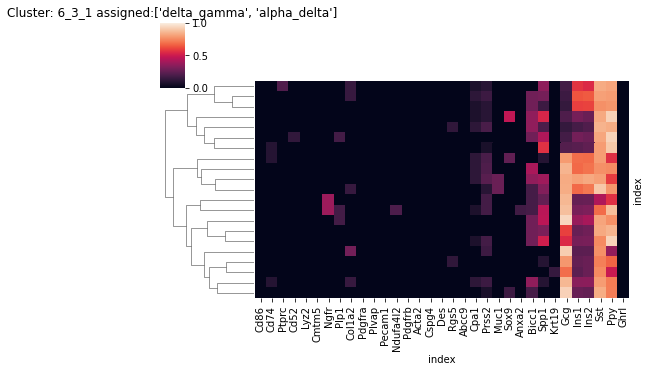

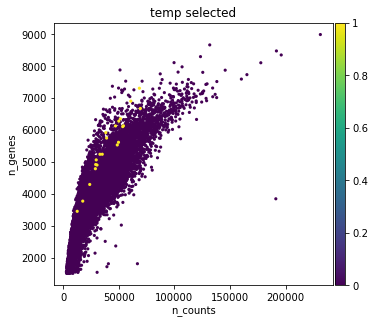

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.5' as categorical



Cluster: 6_3_2 	size: 18
Present: ['alpha_delta']
alpha_delta          0.833333
alpha_delta_gamma    0.166667
Name: type_union, dtype: float64
**** Original cluster 9_1


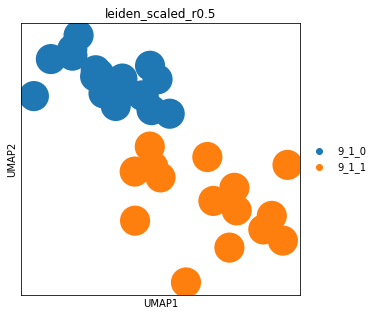


Cluster: 9_1_0 	size: 18
Present: ['schwann', 'NA']
schwann                 0.444444
NA                      0.222222
delta                   0.111111
immune_schwann          0.055556
pericyte_delta_gamma    0.055556
schwann_stellate        0.055556
schwann_delta           0.055556
Name: type_union, dtype: float64


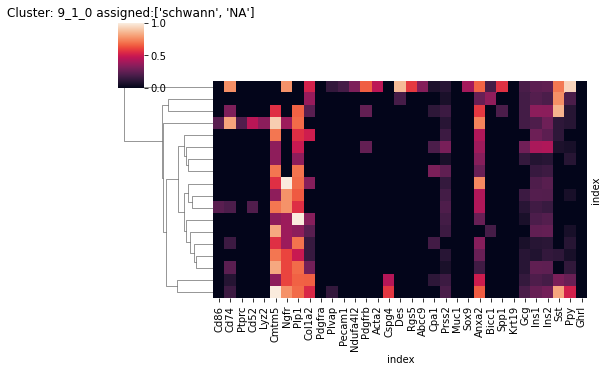

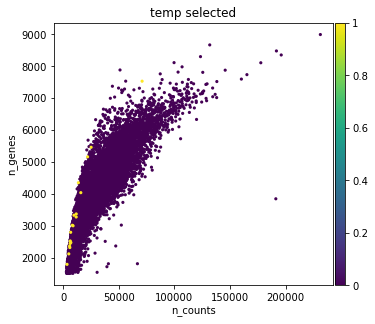


Cluster: 9_1_1 	size: 15
Present: ['beta', 'alpha']
beta             0.200000
alpha            0.200000
schwann_alpha    0.133333
NA               0.133333
schwann_beta     0.133333
alpha_gamma      0.066667
alpha_delta      0.066667
alpha_epsilon    0.066667
Name: type_union, dtype: float64


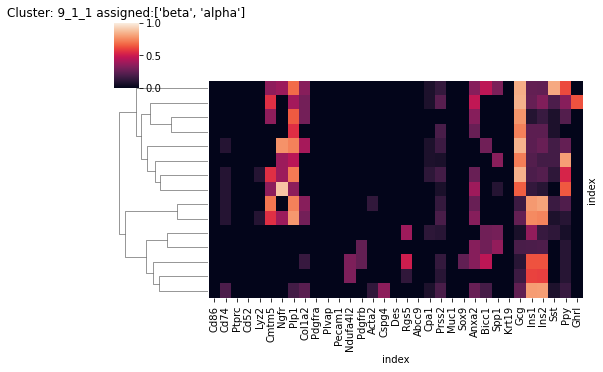

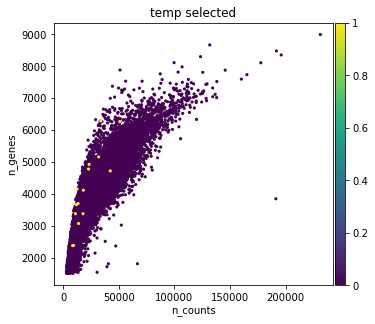

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.5' as categorical


**** Original cluster 9_2


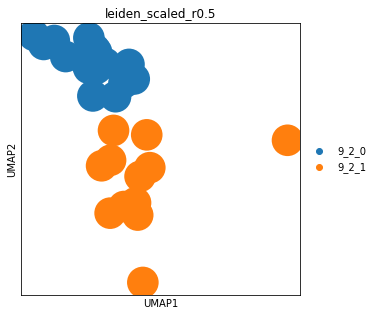


Cluster: 9_2_0 	size: 18
Present: ['stellate', 'NA']
stellate         0.555556
NA               0.388889
stellate_beta    0.055556
Name: type_union, dtype: float64


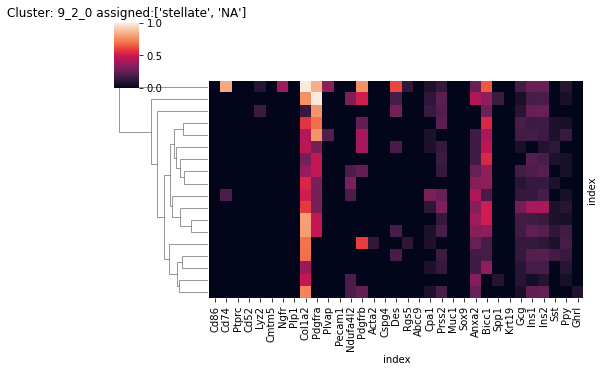

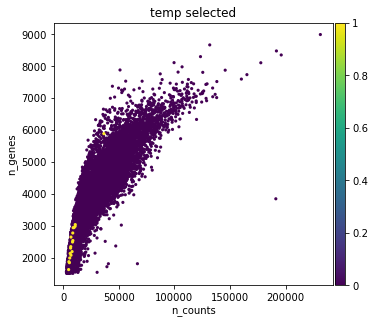


Cluster: 9_2_1 	size: 12
Present: ['pericyte', 'NA']
pericyte    0.500000
NA          0.333333
stellate    0.166667
Name: type_union, dtype: float64


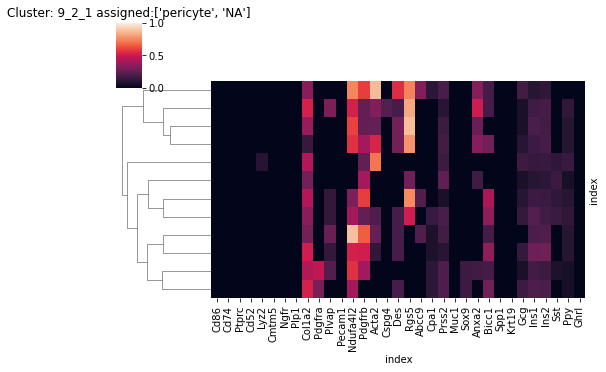

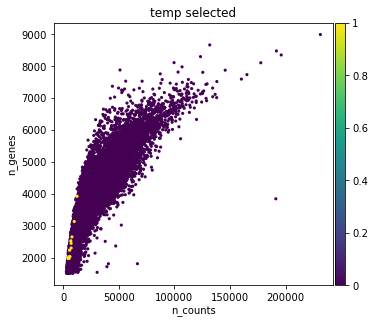

In [50]:
for cluster in sorted(list(adata_rawnormalised.obs['cluster'].unique()),key=int):
    if len(cluster_annotation[cluster]) != 1 or len(
        [cell_type for cell_type in cluster_annotation[cluster] if cell_type !='NA' and cell_type !='other']) == 0:
        print('**** Original cluster',cluster)
        res=0.5
        adata_temp,assignment_df_temp=get_cluster_data(adata_original=adata_rawnormalised, cluster=cluster,
                                                       cluster_col='cluster',assignment_df=assignment_df)
        subcluster(adata_cluster=adata_temp,res=res,original_cluster=cluster,assignment_df_temp=assignment_df_temp)
        cluster_annotate(assignment_df=assignment_df_temp,
                         cluster_col='leiden_scaled_r'+str(res),
                         # Use more leanient condition as this is already subclustered - 
                        # otherwise data could be in some cases subclustered almost idefinitely
                         present_threshold=0.2,nomain_threshold=0.8,
                     save=False,cluster_annotation=cluster_annotation,adata_main= adata_rawnormalised)

#C: The above clustering could not resolve most clusters. However, it did resolve 9_1 and 9_2 to some extent thus those subclusters will be further subclustered.

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.8' as categorical


**** Original cluster 9_1


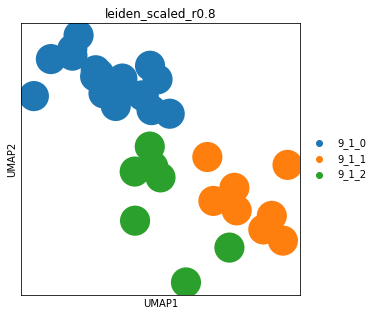


Cluster: 9_1_0 	size: 18
Present: ['schwann', 'NA']
schwann                 0.444444
NA                      0.222222
delta                   0.111111
immune_schwann          0.055556
pericyte_delta_gamma    0.055556
schwann_stellate        0.055556
schwann_delta           0.055556
Name: type_union, dtype: float64


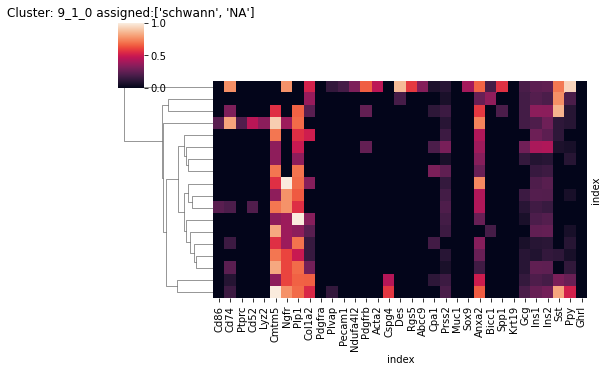

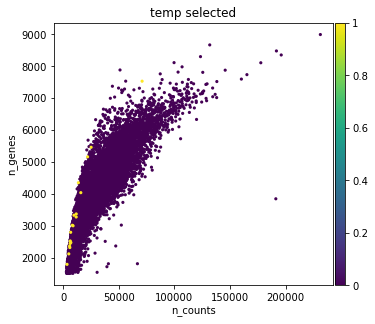


Cluster: 9_1_1 	size: 8
Present: ['alpha', 'schwann_alpha']
alpha            0.375
schwann_alpha    0.250
alpha_delta      0.125
alpha_gamma      0.125
alpha_epsilon    0.125
Name: type_union, dtype: float64


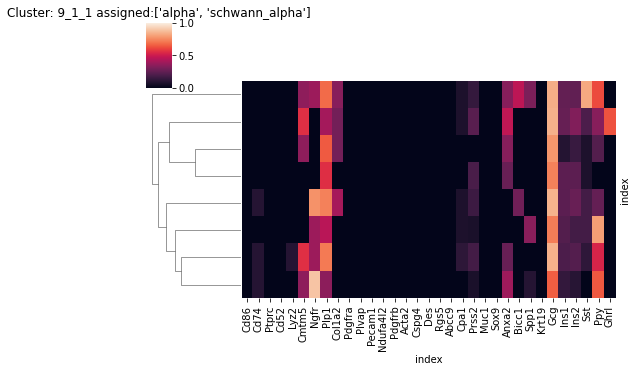

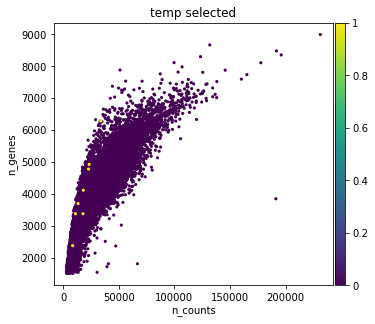


Cluster: 9_1_2 	size: 7
Present: ['beta', 'schwann_beta', 'NA']
beta            0.428571
schwann_beta    0.285714
NA              0.285714
Name: type_union, dtype: float64


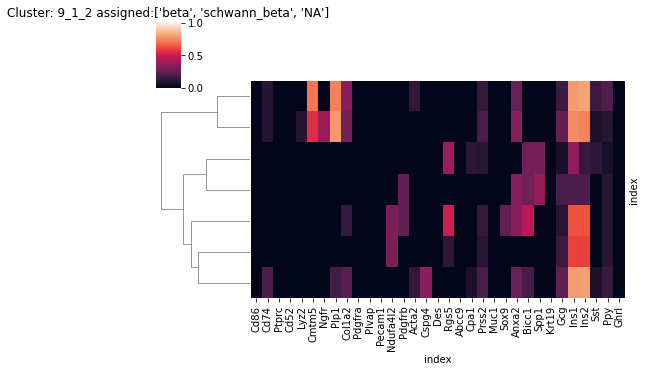

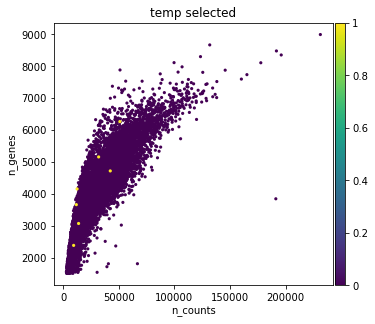

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
... storing 'leiden_scaled_r0.8' as categorical


**** Original cluster 9_2


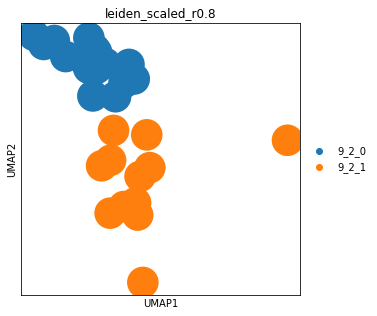


Cluster: 9_2_0 	size: 18
Present: ['stellate', 'NA']
stellate         0.555556
NA               0.388889
stellate_beta    0.055556
Name: type_union, dtype: float64


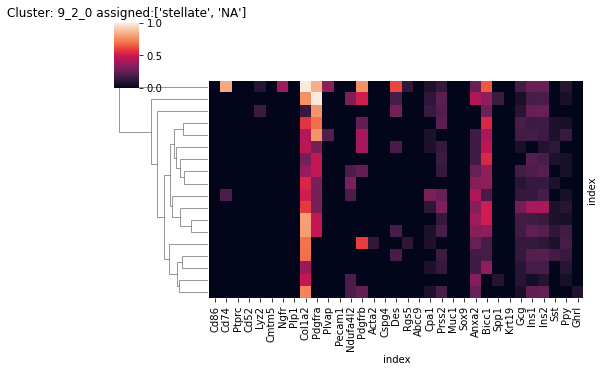

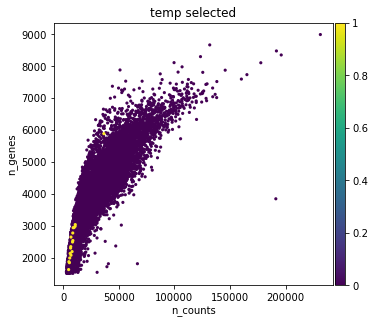


Cluster: 9_2_1 	size: 12
Present: ['pericyte', 'NA']
pericyte    0.500000
NA          0.333333
stellate    0.166667
Name: type_union, dtype: float64


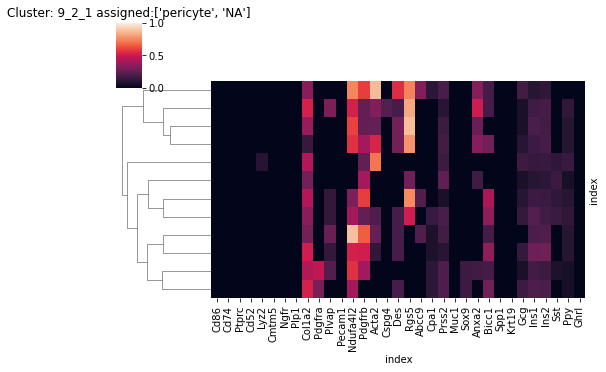

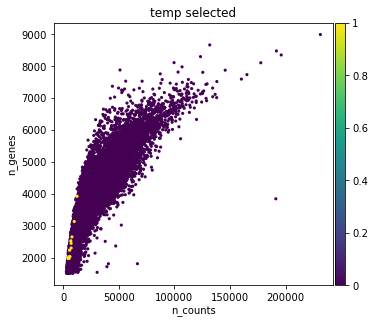

In [51]:
for cluster in ['9_1','9_2']:
    if len(cluster_annotation[cluster]) != 1 or len(
        [cell_type for cell_type in cluster_annotation[cluster] if cell_type !='NA' and cell_type !='other']) == 0:
        print('**** Original cluster',cluster)
        res=0.8
        adata_temp,assignment_df_temp=get_cluster_data(adata_original=adata_rawnormalised, cluster=cluster,
                                                       cluster_col='cluster',assignment_df=assignment_df)
        subcluster(adata_cluster=adata_temp,res=res,original_cluster=cluster,assignment_df_temp=assignment_df_temp)
        cluster_annotate(assignment_df=assignment_df_temp,
                         cluster_col='leiden_scaled_r'+str(res),
                         # Use more leanient condition as this is already subclustered - 
                        # otherwise data could be in some cases subclustered almost idefinitely
                         present_threshold=0.2,nomain_threshold=0.8,
                     save=True,cluster_annotation=cluster_annotation,adata_main= adata_rawnormalised)

In [52]:
cluster_annotation['9_1_0']=['schwann']
cluster_annotation['9_1_1']=['schwann']
cluster_annotation['9_1_2']=['NA']
cluster_annotation['9_2_0']=['stellate']
cluster_annotation['9_2_1']=['pericyte']

#### Annotate cells from unsolvable clusters based on cell type score threshold
All those clusters are endocrine so strip any non-endocrine annotations from cell names.

In [53]:
# Get clusters that still do not have single cell type annotation
unsolvable=[]
for cluster in sorted(list(adata_rawnormalised.obs['cluster'].unique()),key=int):
    if len(cluster_annotation[cluster]) != 1:
        unsolvable.append(cluster)
print('Unsolvable clusters:',unsolvable)        

Unsolvable clusters: ['5_2', '5_3', '6_3']


In [54]:
# Get all cells from the clusters 
idx_unsolvable=adata_rawnormalised.obs.query('cluster in @unsolvable').index

Do not use epsilon cells as there were only 2 - unreliable.

In [55]:
# Make new assignments with only endocrine cell types (excluding epsilone)
type_unions=[]
for idx in idx_unsolvable:
    row=assignment_df.loc[idx,:]
    type_union=''
    # Use list comprehension instead of just the endocrine list so that names of cell types stay in the same order as above
    for col in [col for col in row.index if col in ['alpha','beta','delta','gamma']]:
        if row[col]:
            type_union=type_union+col+'_'
    if type_union=='':
        type_union='NA'
    type_unions.append(type_union.rstrip('_'))

#Reasign cell types in assignment_df
assignment_df.loc[idx_unsolvable,'type_union']=type_unions

alpha_gamma N: 50


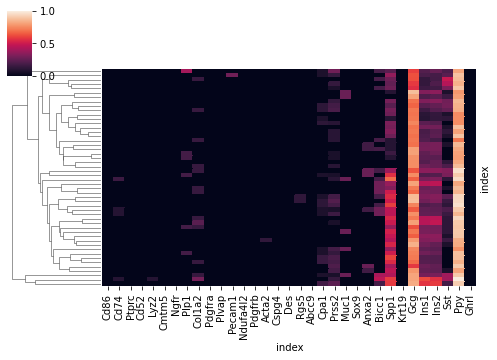

beta N: 41


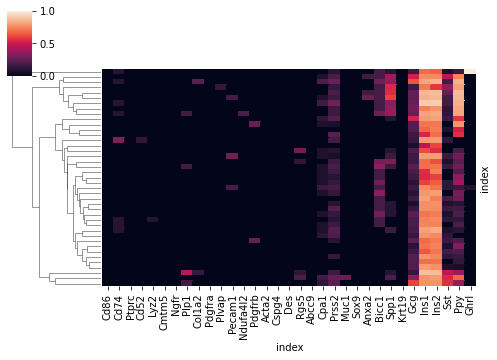

alpha_beta N: 166


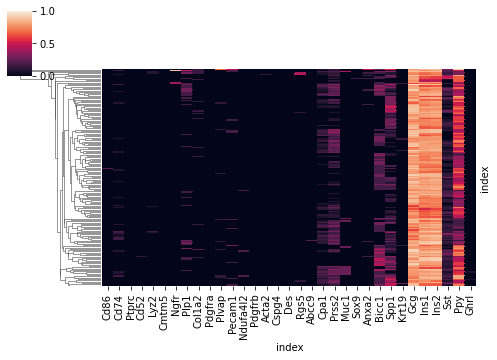

alpha_beta_gamma N: 6


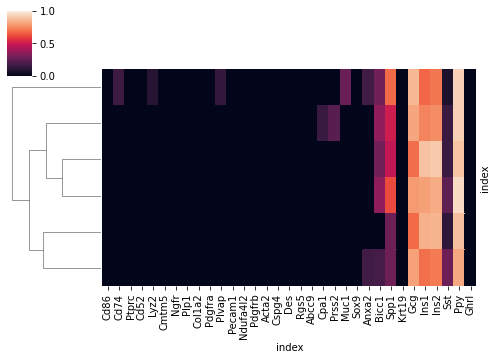

alpha N: 67


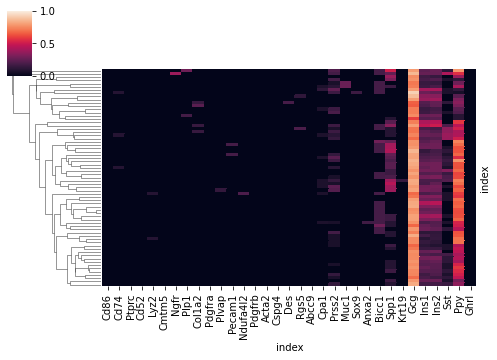

alpha_delta N: 38


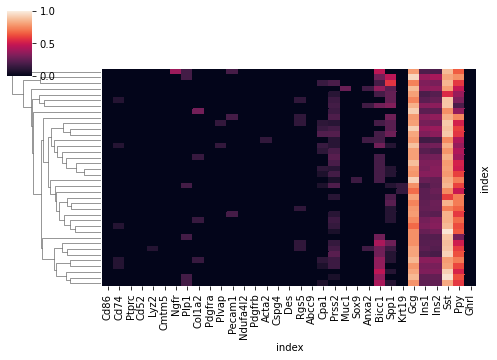

gamma N: 78


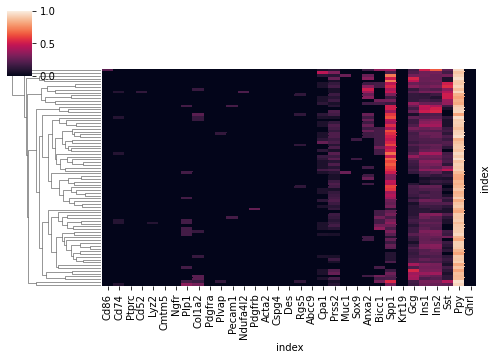

alpha_beta_delta N: 21


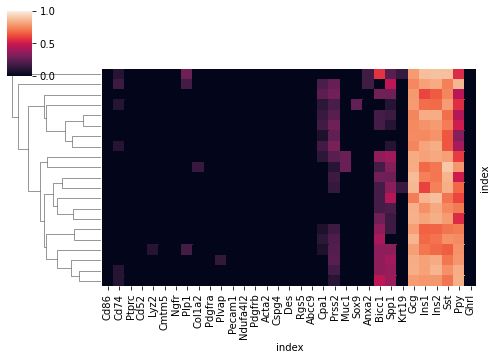

delta N: 2


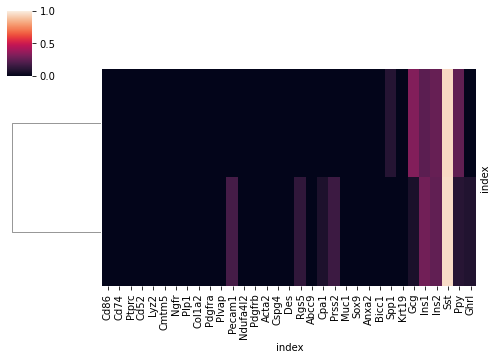

delta_gamma N: 12


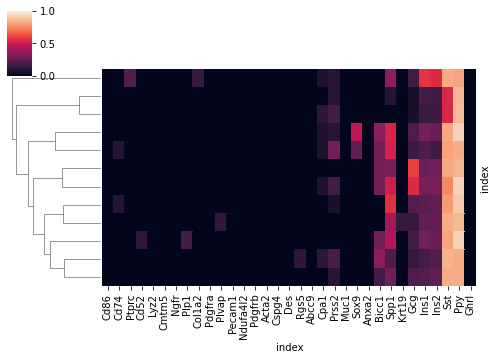

NA N: 2


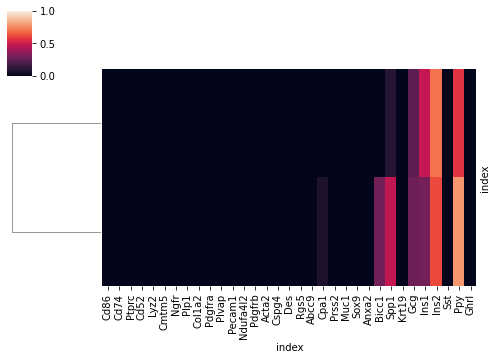

alpha_delta_gamma N: 11


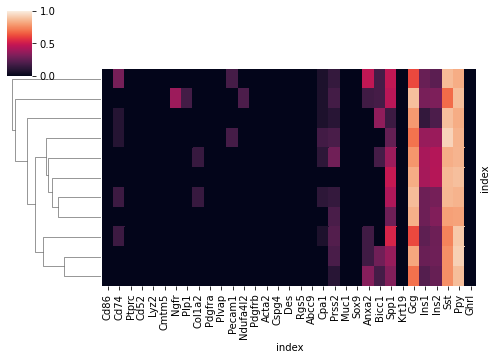

beta_delta N: 2


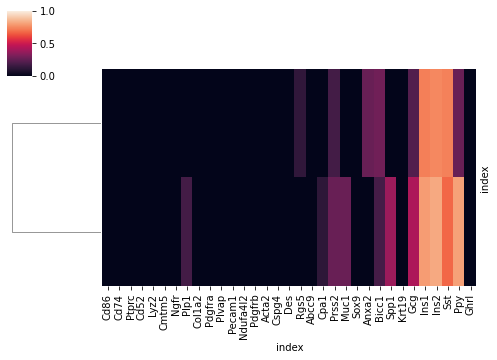

beta_gamma N: 12


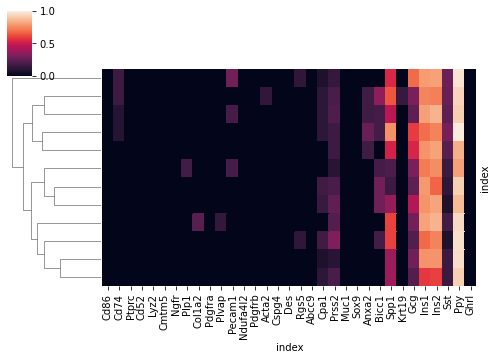

beta_delta_gamma N: 3


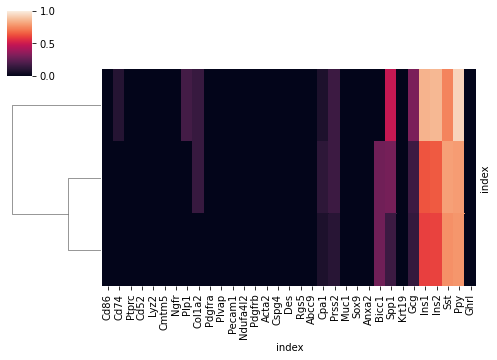

alpha_beta_delta_gamma N: 1


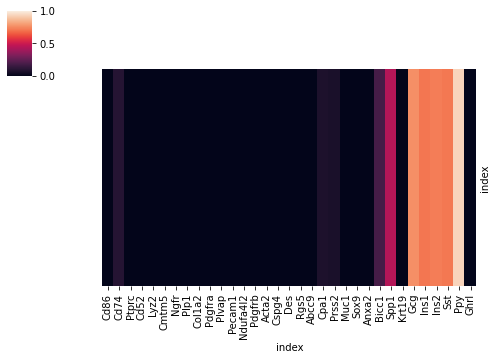

In [56]:
# Group unsolvable cells by cell type and plot expression to check if assignment was ok
for cell_type in assignment_df.loc[idx_unsolvable,'type_union'].unique():
    type_idx=assignment_df.loc[idx_unsolvable,:].query('type_union == "'+cell_type+'"').index
    print(cell_type,'N:',len(type_idx))
    row_cluster=True
    if len(type_idx)<2:
        row_cluster=False
    sb.clustermap(pd.DataFrame(scaled_expression.loc[type_idx,:]), 
                  row_cluster=row_cluster, col_cluster=False,xticklabels=1,yticklabels=False,figsize=(7,5),vmin=0,vmax=1)
    plt.show()
    time.sleep(1.0)

In [57]:
# Replace cluster names in adata and cluster_annotation with threshold based annotation
for cell_type in assignment_df.loc[idx_unsolvable,'type_union'].unique():
    # Subset assignment_df to idx_unsolvable before extracting idices of each cell type so that 
    # Cells from other clusters to not get assigned new clusters because they share phenotype
    type_idx=assignment_df.loc[idx_unsolvable,:].query('type_union == "'+cell_type+'"').index
    save_cluster_annotation(adata=adata_rawnormalised,cluster_name=cell_type,cell_types=[cell_type],cell_names=type_idx)

#### Add cluster based annotation to adata

In [58]:
# Display cluster annotation of clusters that will be used
clusters=list(adata_rawnormalised.obs['cluster'].unique())
clusters.sort()
for cluster in clusters:
    print(cluster ,cluster_annotation[cluster ])

0 ['beta']
1 ['beta']
10 ['ductal']
11_0 ['acinar']
11_1 ['acinar']
11_2 ['acinar']
11_3 ['acinar_low']
2 ['beta']
3 ['beta']
4 ['beta']
5_0 ['alpha']
5_1 ['alpha']
6_0 ['delta']
6_1 ['delta']
6_2 ['beta_delta']
7_0 ['endothelial']
7_1 ['endothelial']
7_2 ['endothelial_pericyte']
7_3 ['endothelial']
7_4 ['endothelial']
8 ['immune']
9_0 ['pericyte']
9_1_0 ['schwann']
9_1_1 ['schwann']
9_1_2 ['NA']
9_2_0 ['stellate']
9_2_1 ['pericyte']
9_3 ['pericyte']
NA ['NA']
alpha ['alpha']
alpha_beta ['alpha_beta']
alpha_beta_delta ['alpha_beta_delta']
alpha_beta_delta_gamma ['alpha_beta_delta_gamma']
alpha_beta_gamma ['alpha_beta_gamma']
alpha_delta ['alpha_delta']
alpha_delta_gamma ['alpha_delta_gamma']
alpha_gamma ['alpha_gamma']
beta ['beta']
beta_delta ['beta_delta']
beta_delta_gamma ['beta_delta_gamma']
beta_gamma ['beta_gamma']
delta ['delta']
delta_gamma ['delta_gamma']
gamma ['gamma']


In [59]:
# Add cell type annotation to clusters. 
# If clusters was annotated with more than one cell type (inbcluding NA or other) set it to 'NA'.
if 'cell_type' in adata_rawnormalised.obs.columns:
    adata_rawnormalised.obs.drop('cell_type',axis=1,inplace=True)
for row_idx in adata_rawnormalised.obs.index:
    cluster=adata_rawnormalised.obs.at[row_idx,'cluster']
    cell_type=cluster_annotation[cluster]
    if len(cell_type)!=1:
        cell_type='NA'
    else:
        cell_type=cell_type[0]
        
    add_category(df=adata_rawnormalised.obs,idxs=row_idx,col='cell_type',category=cell_type)

### Cell type annotation evaluation

... storing 'cell_type' as categorical


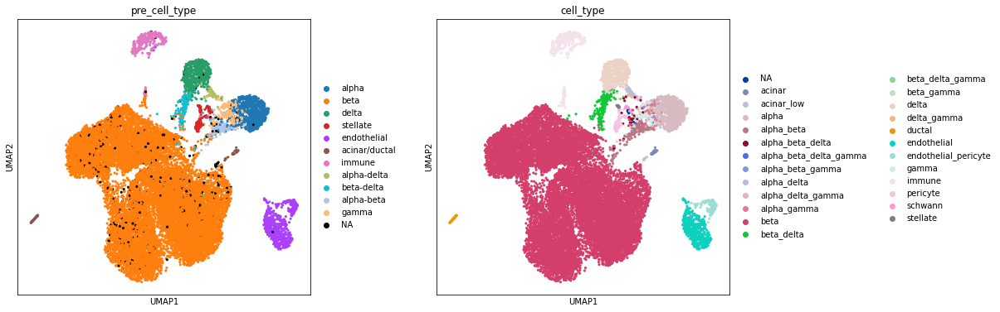

In [60]:
# Plot cell types on UMPA (pre-annotated and new ones)
rcParams['figure.figsize']=(6,6)
sc.pl.umap(adata_rawnormalised, color=['pre_cell_type','cell_type'], size=40, use_raw=False,wspace=0.3)

In [61]:
# Count of new cell types
adata_rawnormalised.obs.cell_type.value_counts()

beta                      14349
alpha                       709
endothelial                 509
delta                       498
immune                      315
beta_delta                  192
alpha_beta                  166
endothelial_pericyte        125
pericyte                    112
gamma                        78
ductal                       57
alpha_gamma                  50
alpha_delta                  38
acinar                       36
schwann                      26
alpha_beta_delta             21
stellate                     18
beta_gamma                   12
delta_gamma                  12
alpha_delta_gamma            11
NA                            9
acinar_low                    8
alpha_beta_gamma              6
beta_delta_gamma              3
alpha_beta_delta_gamma        1
Name: cell_type, dtype: int64

Text(0.5, 1.0, 'cell_type')

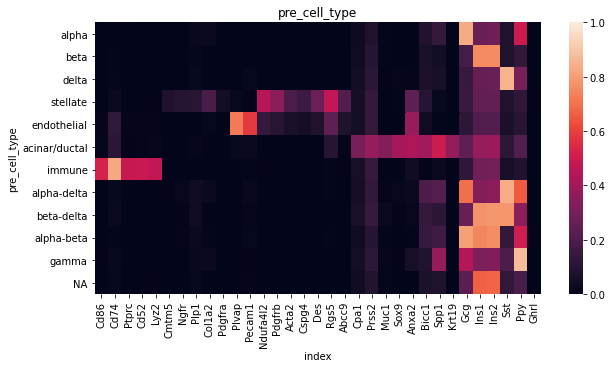

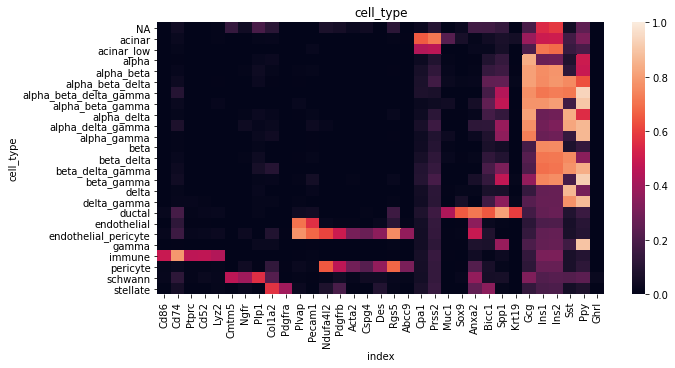

In [62]:
# Plot mean marker expression in each cluster
rcParams['figure.figsize']=(10,5)
fig,ax=plt.subplots()
sb.heatmap(scaled_expression.groupby(adata_rawnormalised.obs['pre_cell_type']).mean(),yticklabels=1,xticklabels=1,
          vmin=0,vmax=1)
ax.set_title('pre_cell_type')
fig,ax=plt.subplots()
sb.heatmap(scaled_expression.groupby(adata_rawnormalised.obs['cell_type']).mean(),yticklabels=1,xticklabels=1,
          vmin=0,vmax=1)
ax.set_title('cell_type')

Expression of markers in individual NA cells.

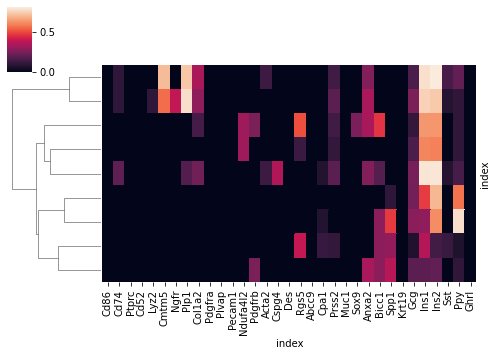

In [63]:
# Subset marker expression to NA cell type cells and plot heatmap
sb.clustermap(pd.DataFrame(scaled_expression[adata_rawnormalised.obs.cell_type=='NA']), 
                  row_cluster=True, col_cluster=False,xticklabels=1,yticklabels=False,figsize=(7,5))

In [64]:
# Add cell type to adata
adata.obs['cell_type']=adata_rawnormalised.obs.cell_type
# Add final clusters and starting clusters to adata
adata.obs[['cluster',clusters_col]]=adata_rawnormalised.obs[['cluster',clusters_col]]
# Add cell type scores
score_cols=[col for col in scores_df_norm.columns if '_score' in col]
adata.obs[score_cols]=scores_df_norm[score_cols].reindex(adata.obs.index)

QC metrics in each cell type.

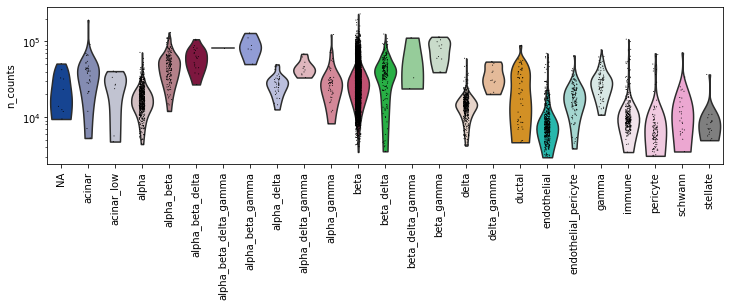

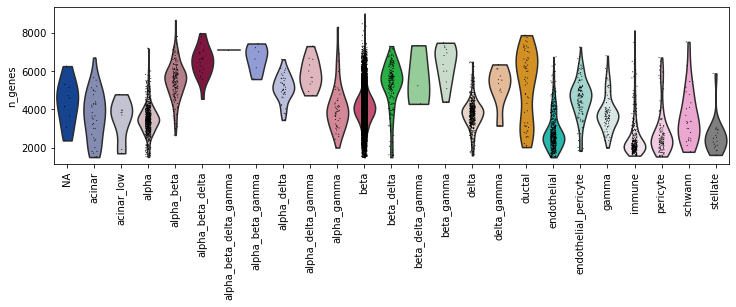

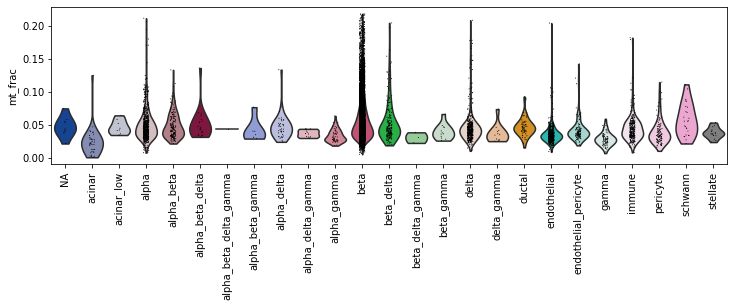

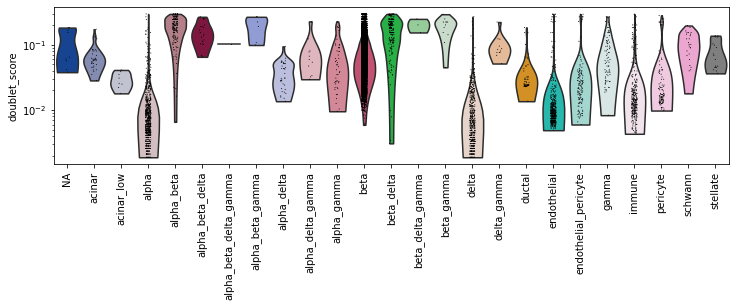

In [65]:
# QC metrics per cell type
rcParams['figure.figsize']=(10,3)
sc.pl.violin(adata, ['n_counts'], groupby='cell_type', size=1, log=True,rotation=90)
sc.pl.violin(adata, ['n_genes'], groupby='cell_type', size=1, log=False,rotation=90)
sc.pl.violin(adata, ['mt_frac'], groupby='cell_type', size=1, log=False,rotation=90)
sc.pl.violin(adata, 'doublet_score',groupby='cell_type',size=1, log=True,rotation=90)

#C: The double cell type populations might be doublets.

Add celly type data to original adata for saving.

#### Cell type markers

Upregulated genes in each cell type compared to other cells on normalised log scaled data.

In [66]:
# Compute overexpressed genes in each cell type on normalised log scaled data
#Retain only cell types with >=10 cells and non-NA annotation
groups_counts=adata.obs.cell_type.value_counts()
groups=[cell_type for cell_type in groups_counts[groups_counts>=10].index if cell_type!='NA']
# Compute markers
sc.tl.rank_genes_groups(adata,groupby='cell_type',groups=groups, use_raw=False)
sc.tl.filter_rank_genes_groups(adata,groupby='cell_type', use_raw=False)

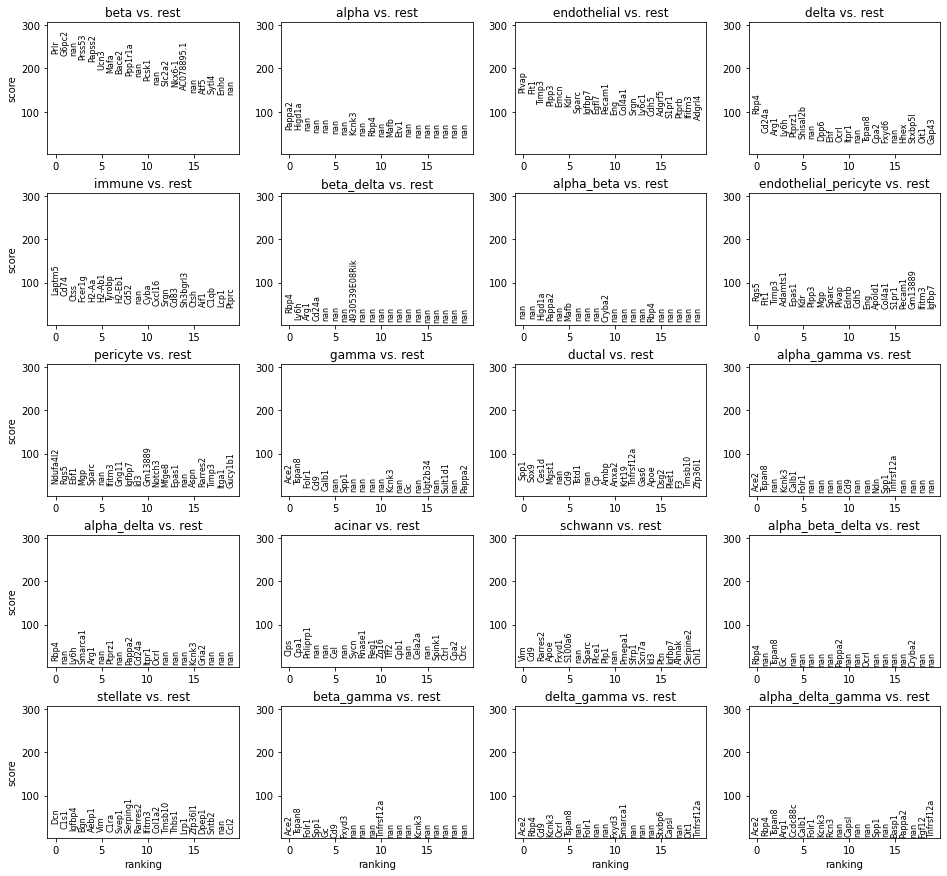

In [67]:
# Plot cell_type vs rest upregulated genes
rcParams['figure.figsize']=(4,3)
sc.pl.rank_genes_groups(adata,key='rank_genes_groups_filtered')

Expression of upregulated genes on normalised log transformed z-scaled data

categories: NA, acinar, acinar_low, etc.
var_group_labels: beta, alpha, endothelial, etc.


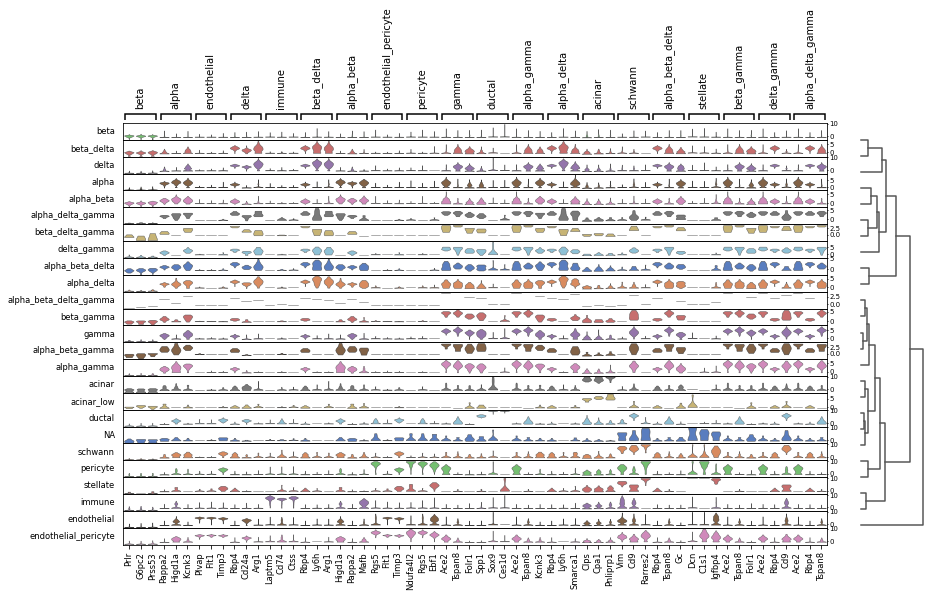

In [68]:
# Plot expression of cell type upregulated genes on normalised log transformed z-scaled data
adata_scl.uns['rank_genes_groups_filtered']=adata.uns['rank_genes_groups_filtered']
adata_scl.obs['cell_type']=adata.obs['cell_type']
sc.pl.rank_genes_groups_stacked_violin(adata_scl,key='rank_genes_groups_filtered',n_genes=3,use_raw=False)

### Expected doublet rates

Adapted from https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6126471/#ref-7, but using 0.1 as doublet rate (described in my notes).

Expected multiplet number is calculated for each file separately.

In [69]:
# Singlet cell types whose multiplet rates are predicted
cell_types=['alpha','beta','gamma','delta']
# DFs with expected multiplet rates
expected_dfs=[]
# Calculate expected rate for each file separately
for file in adata.obs.file.unique():
    print('\nFile:',file)
    cell_type_temp=adata.obs.query('file == "'+file+'"').cell_type.copy()
    
    # N of droplets containing at least one cell of the relevant cell type
    Ns=dict()
    for cell_type in cell_types:
        n_celltype=cell_type_temp.str.contains(cell_type).sum()
        Ns[cell_type]=n_celltype
    print('N droplets that contain at least one:',Ns)
    
    # Calculate N (see formula in notes)
    N=emr.get_N(Ns=Ns.values())
    regex_any='|'.join(['.*'+cell_type+'.*' for cell_type in cell_types])
    print('N:',round(N,1), '(observed cell-containing N with relevant cell types:',
          cell_type_temp.str.contains(fr'{regex_any}').sum(),')')
    
    # Calculate mu for each cell type
    mus=dict()
    for cell_type in cell_types:
        mus[cell_type]=emr.mu_cell_type(N_cell_type=Ns[cell_type], N=N)
    print('mu:',{k:round(v,4) for k,v in mus.items()})
    
    # Extract multiplet types and their components
    multiplet_types=dict()
    for cell_type in cell_type_temp.unique():
        # Get components of multiplets by retaining name parts contained in original cell type dict
        components_all=cell_type.split('_')
        components_relevant=[type_singlet for type_singlet in components_all if type_singlet in cell_types]
        if len(components_relevant) > 1:
            multiplet_types[cell_type]=components_relevant
            # This does not assure that initially the cell types are not counted wrongly 
            # (e.g. including proliferative, ...)
            #if len(components_relevant) < len(components_all):
            #    warnings.warn('Multiplet type has additional unrecognised component: '+cell_type)
    #print('Relevant multiplet cell types:',multiplet_types.keys())
    
    # This also analyses O and E of singlet types, but this is not so relevant as changes in multiplets also 
    # affect it?
    #types_OE= dict(zip(cell_types,[[i] for i in cell_types]))
    #types_OE.update(multiplet_types)
    
    # Calculate O (observed) and E (expected) numbers
    expected_df=pd.DataFrame(index=multiplet_types.keys(),columns=['O_'+file,'E_'+file
                                                                  # ,'E_atleast'
                                                                  ])
    #for multiplet, components in types_OE.items():
    for multiplet, components in multiplet_types.items():
        absent=np.setdiff1d(cell_types,components)
        # N of cellls of this cell type
        expected_df.at[multiplet,'O_'+file]=(cell_type_temp==multiplet).sum()
        # Expected N of cells that have all the individual cell types of multiplet and non of the other 
        # considered possible multiplet ontributors
        expected_df.at[multiplet,'E_'+file]=emr.expected_multiplet(
            mu_present=[mus[cell_type] for cell_type in components], 
            mu_absent=[mus[cell_type] for cell_type in absent], 
            N=N)
        # E that droplet contains at least one cell of each present cell type,
        # but does not exclude other cell types from being present
        #expected_df.at[multiplet,'E_atleast']=emr.expected_multiplet(
        #    mu_present=[mus[cell_type] for cell_type in components], 
        #    mu_absent=[], 
        #    N=N)
    expected_dfs.append(expected_df)
    
# Merge O/E rates for all files into single DF
display(pd.concat(expected_dfs,axis=1))
del cell_type_temp


File: MUC13976
N droplets that contain at least one: {'alpha': 396, 'beta': 5598, 'gamma': 37, 'delta': 195}
N: 14496.7 (observed cell-containing N with relevant cell types: 6074 )
mu: {'alpha': 0.0277, 'beta': 0.488, 'gamma': 0.0026, 'delta': 0.0135}

File: MUC13975
N droplets that contain at least one: {'alpha': 269, 'beta': 2507, 'gamma': 105, 'delta': 286}
N: 7082.2 (observed cell-containing N with relevant cell types: 2956 )
mu: {'alpha': 0.0387, 'beta': 0.4369, 'gamma': 0.0149, 'delta': 0.0412}

File: MUC13974
N droplets that contain at least one: {'alpha': 337, 'beta': 6645, 'gamma': 31, 'delta': 295}
N: 17082.5 (observed cell-containing N with relevant cell types: 7116 )
mu: {'alpha': 0.0199, 'beta': 0.4927, 'gamma': 0.0018, 'delta': 0.0174}


,O_MUC13976,E_MUC13976,O_MUC13975,E_MUC13975,O_MUC13974,E_MUC13974
alpha_gamma,18,0.612074,22,2.47236,10,0.367215
beta_delta,53,73.0568,65,95.9503,74,112.286
alpha_beta,57,150.476,38,90.0217,71,128.594
alpha_beta_gamma,4,0.385045,1,1.35473,1,0.233786
alpha_delta,7,3.26143,21,6.9136,10,3.54942
alpha_beta_delta,3,2.05171,9,3.78831,9,2.25973
delta_gamma,1,0.297164,10,2.63519,1,0.320645
alpha_delta_gamma,1,0.00834548,8,0.104042,2,0.00645292
beta_gamma,NaN,NaN,10,34.3127,2,11.6168
beta_delta_gamma,NaN,NaN,3,1.44395,NaN,NaN


#C: Despite alpha_beta_delta having O > E it will be treated as multiplet, as this cell type was multiplet like in other studies (Fltp, STZ ref, VSG ref) and it does not have very large cell numbers. The cells are also very dispersed on UMAP.

In [70]:
# Reassign cell types to multiplet
multiplets=['beta_delta','alpha_beta','alpha_beta_gamma','beta_gamma',
            'beta_delta_gamma','alpha_beta_delta_gamma','alpha_beta_delta']
adata.obs['cell_type_multiplet']=adata.obs.cell_type.replace(multiplets, 'multiplet')

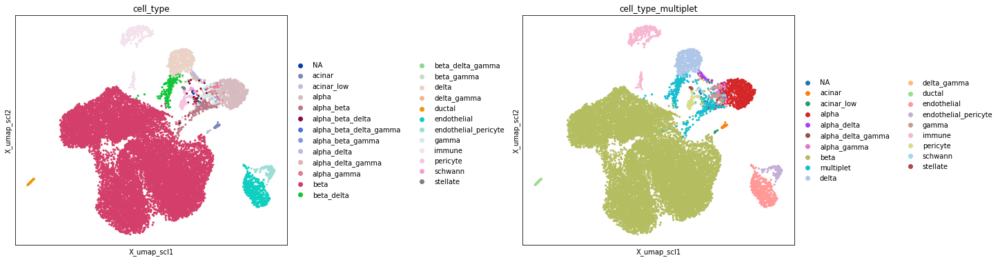

In [71]:
# Plot new cell types
rcParams['figure.figsize']=(6,6)
sc.pl.embedding(adata,'X_umap_scl', color=['cell_type','cell_type_multiplet'], size=40, use_raw=False,wspace=0.7)

## Resolve beta subtypes

#### Preprocess beta cell data

Select beta cells only

In [6]:
[ct for ct in adata.obs.cell_type_multiplet.unique() if 'beta' in ct]

['beta']

#C: No beta str containing cell types to exclude

In [7]:
# Subset adata
selected_beta=[ct for ct in adata.obs.cell_type_multiplet.unique() if 'beta' in ct]
adata_beta=adata[adata.obs.cell_type.isin(selected_beta),:].copy()
adata_beta.shape

# Normalise raw data for plotting and cell type scoring
adata_raw_beta=adata_beta.raw.to_adata().copy()
# Normalize and log transform
adata_raw_beta.X /= adata_raw_beta.obs['size_factors'].values[:,None] # This reshapes the size-factors array
sc.pp.log1p(adata_raw_beta)
adata_raw_beta.X = sparse.csr_matrix(np.asarray(adata_raw_beta.X))

# Scale beta adata for umap
adata_scl_beta=adata_beta
del adata_beta
sc.pp.scale(adata_scl_beta,max_value=10)
sc.pp.pca(adata_scl_beta, n_comps=10, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_scl_beta,n_pcs=10)
sc.tl.umap(adata_scl_beta)

# Combine raw and X data
adata_rawnormalised_beta=adata_scl_beta.copy()
adata_rawnormalised_beta.raw=adata_raw_beta
del adata_raw_beta

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'

In [8]:
metadata=pd.read_excel('/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/scRNA-seq_pancreas_metadata.xlsx',
                      sheet_name='Fltp_2y')
# Add metadata 
samples=adata_rawnormalised_beta.obs.file.unique()
value_map={sample:metadata.query('sample_name =="'+sample+'"')['design'].values[0] for sample in samples}
adata_rawnormalised_beta.obs['design']=adata_rawnormalised_beta.obs.file.map(value_map)

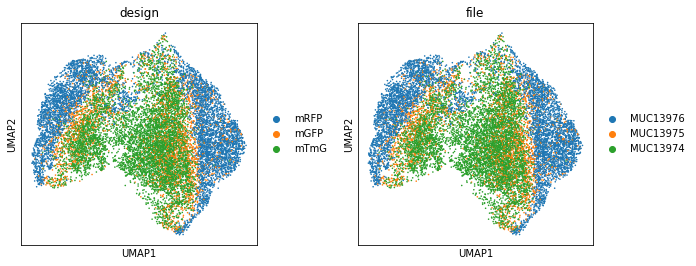

In [13]:
rcParams['figure.figsize']=(4,4)
random_indices=np.random.permutation(list(range(adata_rawnormalised_beta.shape[0])))
sc.pl.umap(adata_rawnormalised_beta[random_indices,:], color=['design','file'],size=10, use_raw=True,wspace=0.3)

#### Check markers

('beta', '/')
Missing genes: []


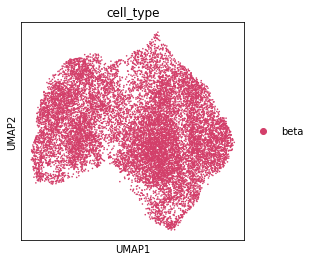

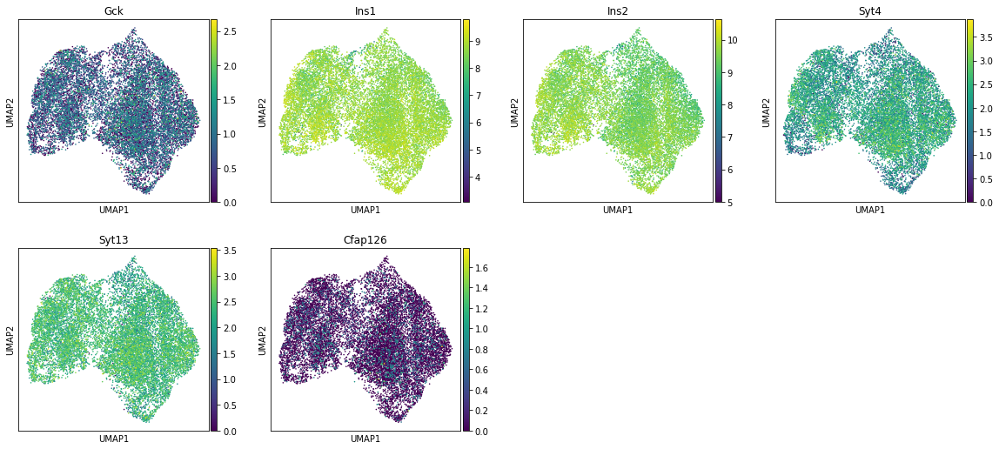

('beta', 'aging')
Missing genes: []


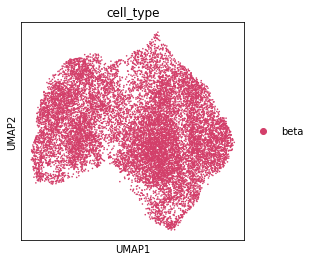

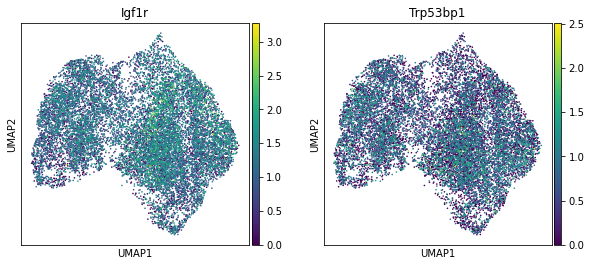

('beta', 'dedifferentiated')
Missing genes: []


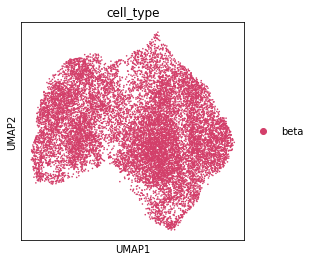

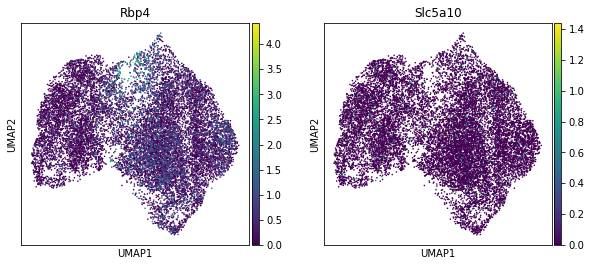

('beta', 'disease')
Missing genes: []


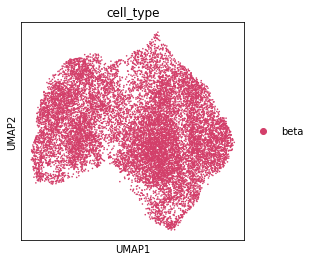

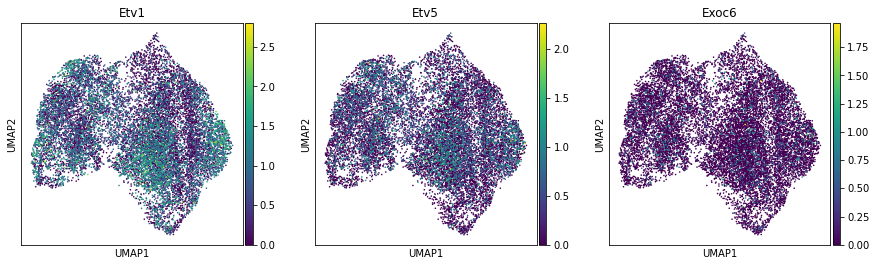

('beta', 'immature')
Missing genes: ['Pax4']


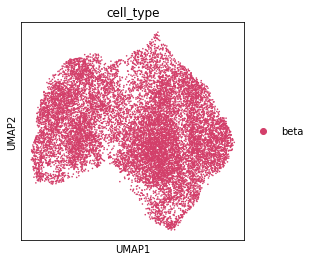

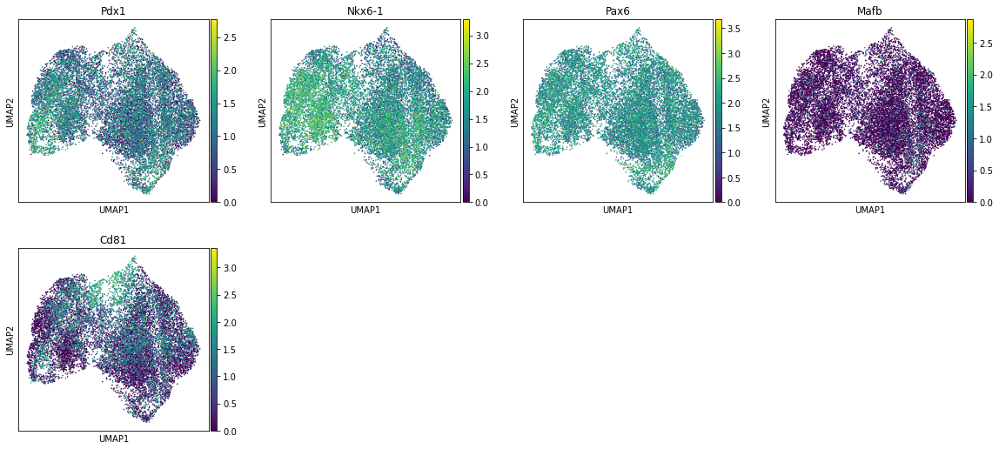

('beta', 'inflamation')
Missing genes: []


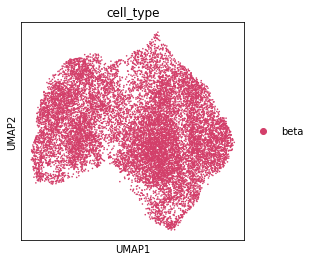

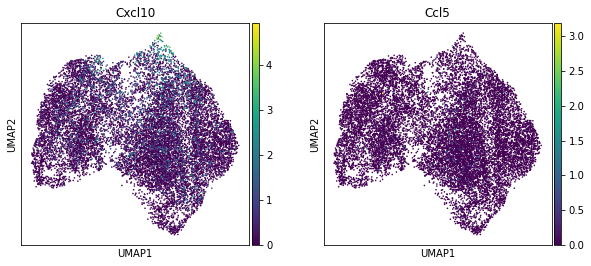

('beta', 'mature')
Missing genes: []


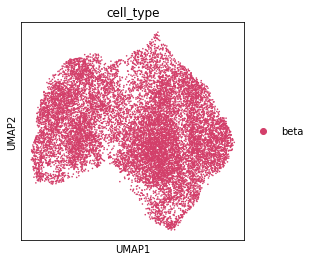

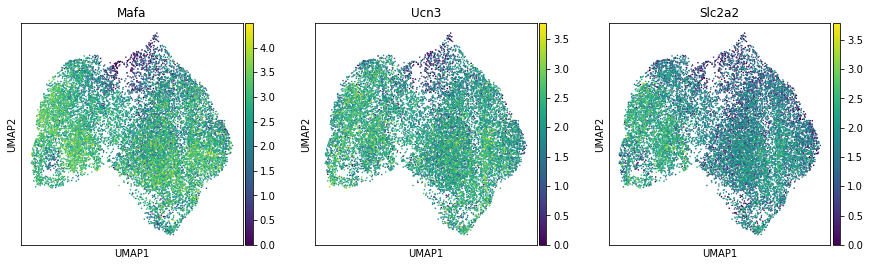

('beta', 'senescent')
Missing genes: []


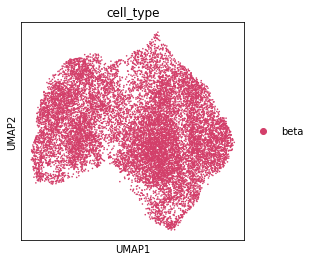

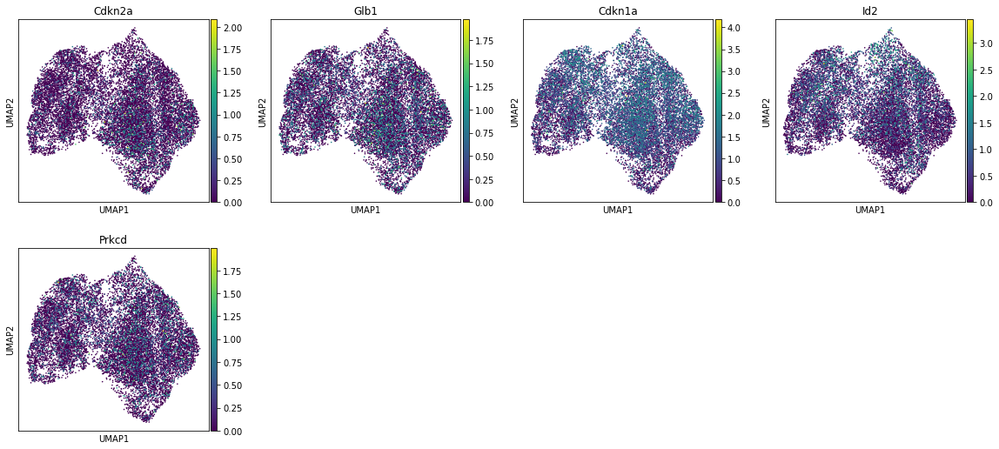

('endocrine', '/')
Missing genes: ['Neurod2', 'Gng13']


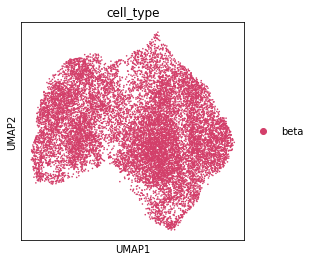

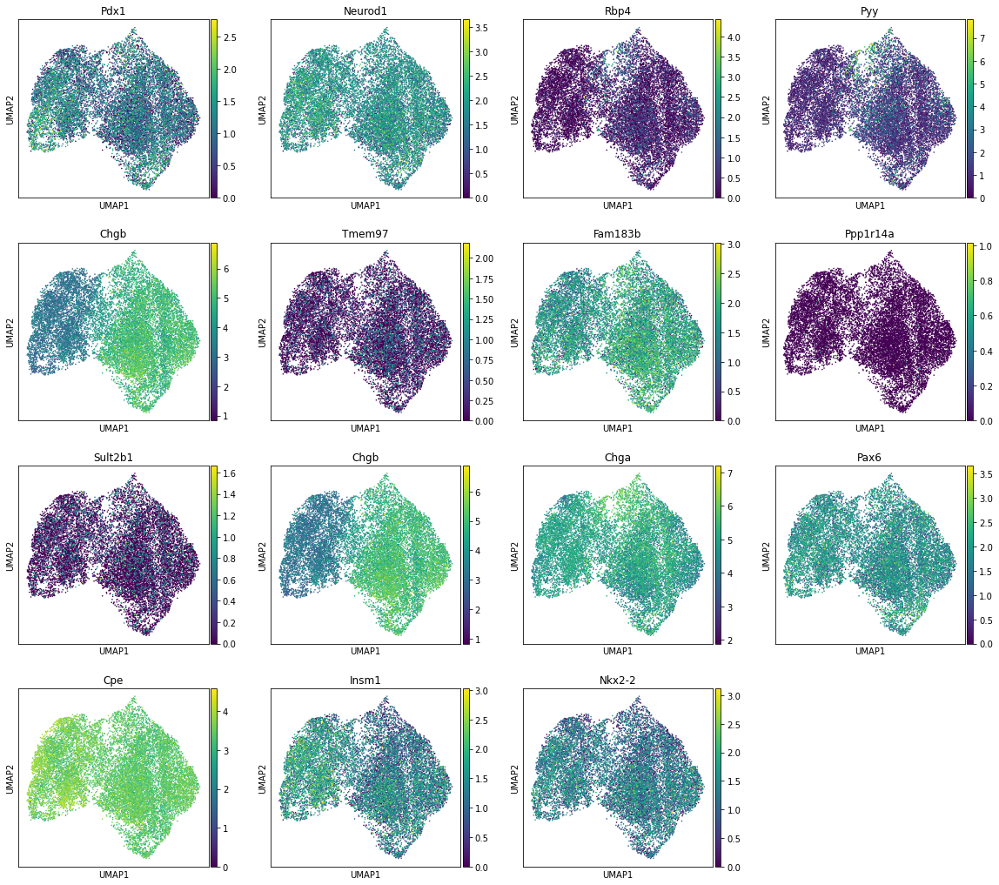

In [74]:
# Select beta and endocrine markers and group by cell type and subtype
for group_name, group in markers.query('Cell in ["beta","endocrine"]').fillna('/').groupby(['Cell','Subtype']):
    print(group_name)
    genes=group.Gene
    # Retain genes present in raw var_names
    missing=[gene for gene in genes if gene not in adata.raw.var_names]
    genes=[gene for gene in genes if gene in adata.raw.var_names]
    print('Missing genes:',missing)
    rcParams['figure.figsize']=(4,4)
    sc.pl.umap(adata_rawnormalised_beta, color=['cell_type'],size=10, use_raw=True)
    sc.pl.umap(adata_rawnormalised_beta, color=genes ,size=10, use_raw=True)

#C: Small ins low population. Aging markers are all ower UMAP so will not be annotated specifically. Etv5 is similar but less distinct than Etv1 - only Etv1 will be annotated as this cell type was recognised elsewhere and seems to represent similar populations. Slc2a2 will note be included in mature as Mafa and Ucn3 have more distinct expression patters. Chgb seems to separate beta cells in two large subpopulations, both of which have subpopulations of other markers. However, as Chgb is not separated by batches (unlike Ccl5) it will be annotated with other cell markers and not separately.

In [75]:
# Selected markers that seem to be able to distinguish between cell seubtypes
markers_selection_beta={
'Etv1_high':['Etv1'],
'Cd81_high':['Cd81'],
'Cxcl10_high':['Cxcl10'],
'mature':['Mafa','Ucn3'],
'immature':['Rbp4','Pyy'],
'Chgb_high':['Chgb'],
'ins_high':['Ins1','Ins2']
}

#### Calculate subpopulation scores

In [76]:
# Calculate scores
scores=[]
for cell_type,genes in markers_selection_beta.items():
    score_name=cell_type+'_score'
    scores.append(cell_type+'_score')
    sc.tl.score_genes(adata_rawnormalised_beta, gene_list=genes, score_name=score_name,  use_raw=True)

In [77]:
# Scores normalised to interval [0,1] for each cell type - so that they can be more easily compared
scores_df_norm_beta=adata_rawnormalised_beta.obs[scores]
scores_df_norm_beta=pd.DataFrame(pp.minmax_scale(scores_df_norm_beta),columns=scores_df_norm_beta.columns,index=adata_rawnormalised_beta.obs.index)

#### Score distn and relationships

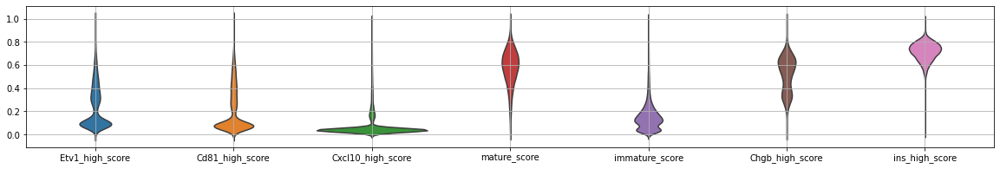

In [78]:
# Plot of normalised scores distribution in whole dataset, per cluster
rcParams['figure.figsize']=(20,3)
fig,ax=plt.subplots()
sb.violinplot(data=scores_df_norm_beta,inner=None,ax=ax)
ax.grid()

In [79]:
# Convert ins high to ins low
scores_df_norm_beta['ins_low_score']=scores_df_norm_beta['ins_high_score']*-1+1

In [80]:
# Dict for score thresholds
beta_marker_thresholds=dict()

Text(0, 0.5, 'mature_score')

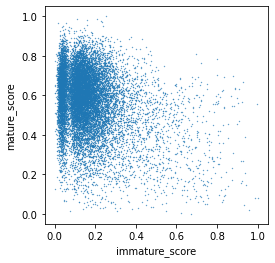

In [81]:
# Find immature
rcParams['figure.figsize']=(4,4)
plt.scatter(scores_df_norm_beta['immature_score'],scores_df_norm_beta['mature_score'],s=0.1)
plt.xlabel('immature_score')
plt.ylabel('mature_score')

Dist of differences between mature and immature

In [82]:
scores_df_norm_beta['immature-mature_score']=scores_df_norm_beta['immature_score']-scores_df_norm_beta['mature_score']

Text(0.5, 0, 'immature-mature score')

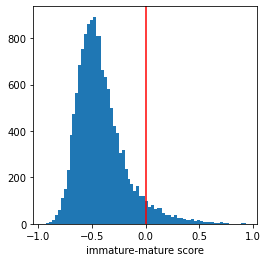

In [83]:
a=plt.hist(scores_df_norm_beta['immature-mature_score'],bins=70)
beta_marker_thresholds['immature-mature_score']=0
plt.axvline(beta_marker_thresholds['immature-mature_score'],c='r')
plt.xlabel('immature-mature score')

Text(0, 0.5, 'mature_score')

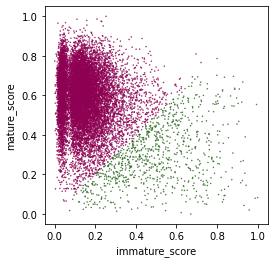

In [84]:
plt.scatter(scores_df_norm_beta['immature_score'],scores_df_norm_beta['mature_score'],s=0.2,
            c=scores_df_norm_beta['immature-mature_score']>=beta_marker_thresholds['immature-mature_score'],
            cmap='PiYG')
plt.xlabel('immature_score')
plt.ylabel('mature_score')

Text(0, 0.5, 'immature-mature_score')

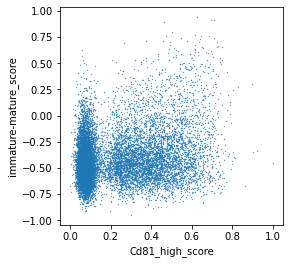

In [85]:
plt.scatter(scores_df_norm_beta['Cd81_high_score'],scores_df_norm_beta['immature-mature_score'],s=0.1)
plt.xlabel('Cd81_high_score')
plt.ylabel('immature-mature_score')

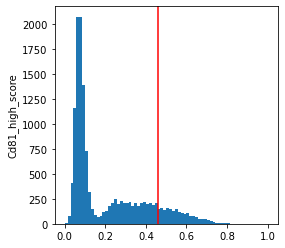

In [86]:
a=plt.hist(scores_df_norm_beta['Cd81_high_score'],bins=70)
#plt.yscale('log')
plt.ylabel('Cd81_high_score')
beta_marker_thresholds['Cd81_high_score']=0.46
plt.axvline(beta_marker_thresholds['Cd81_high_score'],c='r')

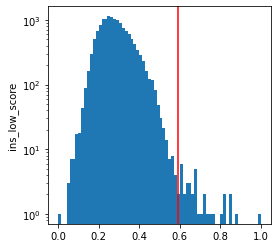

In [87]:
a=plt.hist(scores_df_norm_beta['ins_low_score'],bins=70)
plt.yscale('log')
plt.ylabel('ins_low_score')
beta_marker_thresholds['ins_low_score']=0.59
plt.axvline(beta_marker_thresholds['ins_low_score'],c='r')

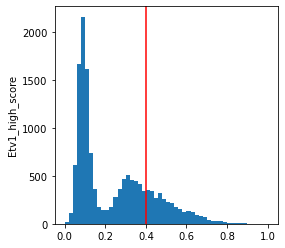

In [88]:
a=plt.hist(scores_df_norm_beta['Etv1_high_score'],bins=50)
#plt.yscale('log')
plt.ylabel('Etv1_high_score')
beta_marker_thresholds['Etv1_high_score']=0.4
plt.axvline(beta_marker_thresholds['Etv1_high_score'],c='r')

Text(0, 0.5, 'Etv1_high_score')

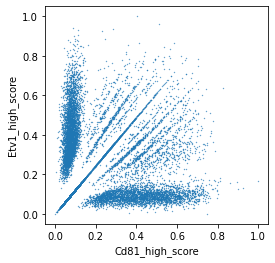

In [89]:
plt.scatter(scores_df_norm_beta['Cd81_high_score'],scores_df_norm_beta['Etv1_high_score'],s=0.1)
plt.xlabel('Cd81_high_score')
plt.ylabel('Etv1_high_score')

Text(0, 0.5, 'Etv1_high_score')

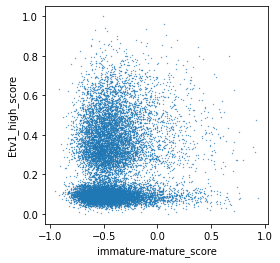

In [90]:
plt.scatter(scores_df_norm_beta['immature-mature_score'],scores_df_norm_beta['Etv1_high_score'],s=0.1)
plt.xlabel('immature-mature_score')
plt.ylabel('Etv1_high_score')

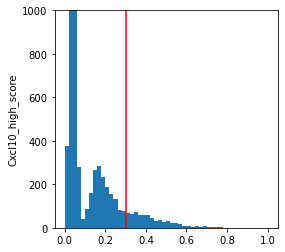

In [91]:
a=plt.hist(scores_df_norm_beta['Cxcl10_high_score'],bins=50)
#plt.yscale('log')
plt.ylim((0,1000))
plt.ylabel('Cxcl10_high_score')
beta_marker_thresholds['Cxcl10_high_score']=0.3
plt.axvline(beta_marker_thresholds['Cxcl10_high_score'],c='r')

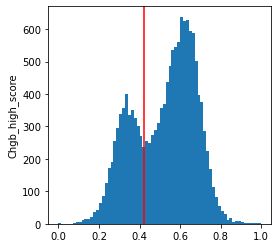

In [92]:
a=plt.hist(scores_df_norm_beta['Chgb_high_score'],bins=70)
#plt.yscale('log')
plt.ylabel('Chgb_high_score')
beta_marker_thresholds['Chgb_high_score']=0.42
plt.axvline(beta_marker_thresholds['Chgb_high_score'],c='r')

In [93]:
# Thresholds for cell type assignemnt based on normalised scores
scores_cols_beta=['immature-mature_score','Cd81_high_score','Etv1_high_score','ins_low_score','Cxcl10_high_score',
                 'Chgb_high_score']
thresholds_beta=[beta_marker_thresholds[score_col] for score_col in scores_cols_beta]

In [94]:
# Assign cell types based on scores to each cell
assignment_df_beta=scores_df_norm_beta[scores_cols_beta]>=thresholds_beta
# replace '-mature' from immature-mature to get just immature out for the cell type name
assignment_df_beta.columns=[col.replace('_score','').replace('-mature','') for col in scores_cols_beta] 

In [95]:
# For each cell make a (standard) string of annotated cell types: 
# e.g. each annotated cell type in the same order, separated by '_' when multiple cell types were annotated
type_unions_beta=[]
for idx,row in assignment_df_beta.iterrows():
    type_union=''
    for col in row.index:
        # Remove Ccl5 from union of cell types
        if row[col]:
            type_union=type_union+col+'_'
    if type_union=='':
        type_union='NA'
    type_unions_beta.append(type_union.rstrip('_'))

In [96]:
# Add cell types strings of cells to scores/assignment DF
assignment_df_beta['type_union']=type_unions_beta
assignment_df_beta['type_union'].value_counts()

Chgb_high                                             6174
NA                                                    2660
Etv1_high_Chgb_high                                   1857
Cd81_high_Chgb_high                                    778
Etv1_high                                              674
Cd81_high                                              479
Cxcl10_high_Chgb_high                                  326
immature_Chgb_high                                     289
immature_Cd81_high_Chgb_high                           196
Cd81_high_Etv1_high_Chgb_high                          190
immature_Etv1_high_Chgb_high                           138
Cxcl10_high                                             97
Cd81_high_Etv1_high                                     83
Etv1_high_Cxcl10_high_Chgb_high                         73
immature_Cd81_high_Etv1_high_Chgb_high                  56
Cd81_high_Cxcl10_high_Chgb_high                         48
immature_Cd81_high_Cxcl10_high_Chgb_high                

In [97]:
adata_rawnormalised_beta.obs['beta_subtype']=assignment_df_beta['type_union']

... storing 'beta_subtype' as categorical


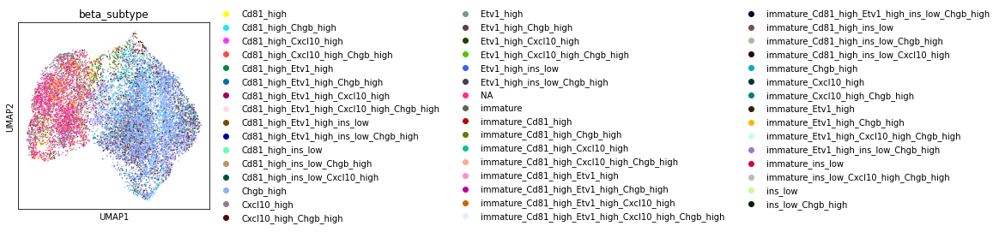

In [98]:
rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata_rawnormalised_beta,color='beta_subtype')

#C: Adjust threshold so that high patterns observed on UMAps above can be seen here as well.

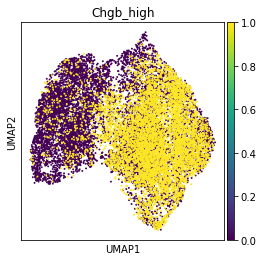

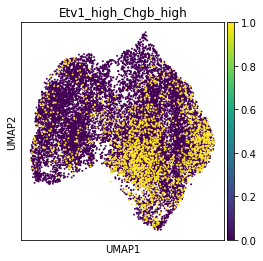

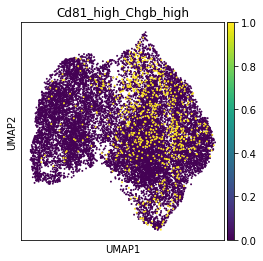

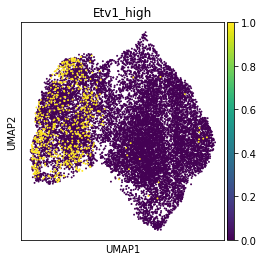

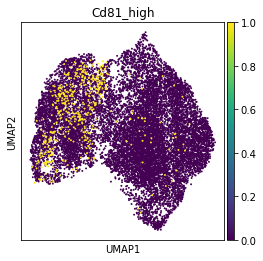

...

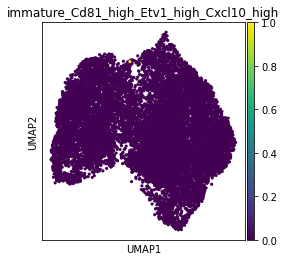

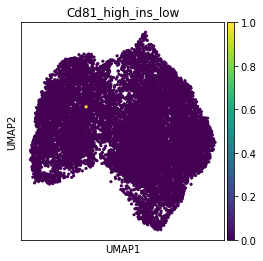

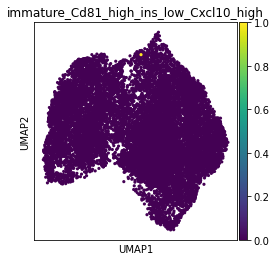

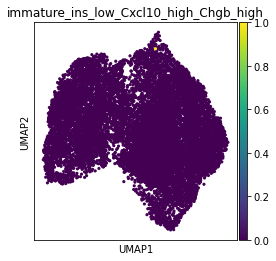

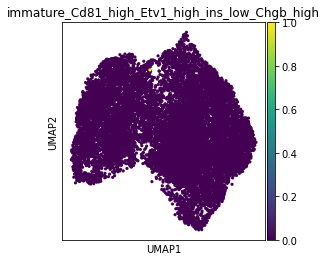

In [99]:
for subtype,count in adata_rawnormalised_beta.obs.beta_subtype.value_counts().iteritems():
    if subtype !='NA':
        s=40 if count < 100 else 15
        adata_rawnormalised_beta.obs['temp']=adata_rawnormalised_beta.obs['beta_subtype']==subtype
        sc.pl.umap(adata_rawnormalised_beta,color='temp',size=s,title=subtype)
adata_rawnormalised_beta.obs.drop('temp',axis=1,inplace=True)

#C: Set less common cell types to more common ones based on UMAP position. If none of the individual cell types is common or the population is based on single cell type with low count set it to NA which will be interpreted as beta.

In [106]:
# rename cell types
adata_rawnormalised_beta.obs['beta_subtype'].replace({
 'immature_Cd81_high_Chgb_high':'immature_Chgb_high',
 'immature_Etv1_high_Chgb_high':'Etv1_high_Chgb_high',
 'Etv1_high_Cxcl10_high_Chgb_high':'Etv1_high_Chgb_high',
 'immature_Cd81_high_Etv1_high_Chgb_high':'Cd81_high_Etv1_high_Chgb_high',
 'immature_Cd81_high_Cxcl10_high_Chgb_high':'immature_Cxcl10_high_Chgb_high',
 'immature_Cd81_high':'immature',
 'Cd81_high_Cxcl10_high':'Cd81_high',
 'Etv1_high_Cxcl10_high':'Etv1_high',
 'immature_Cd81_high_Etv1_high':'Cd81_high_Etv1_high',
 'immature_Etv1_high_Cxcl10_high_Chgb_high':'Etv1_high_Chgb_high',
 'Cd81_high_Etv1_high_Cxcl10_high':'Cd81_high_Etv1_high',
 'immature_Cd81_high_ins_low_Chgb_high':'immature_Chgb_high',
 'Etv1_high_ins_low':'Etv1_high',
 'Cd81_high_Etv1_high_Cxcl10_high_Chgb_high':'Cd81_high_Etv1_high_Chgb_high',
 'immature_Cxcl10_high':'immature',
 'Cd81_high_ins_low_Chgb_high':'Cd81_high_Chgb_high',
 'Etv1_high_ins_low_Chgb_high':'Etv1_high_Chgb_high',
 'ins_low_Chgb_high':'Chgb_high',
 'ins_low':'NA',
 'immature_Cd81_high_ins_low':'immature',
 'immature_Cd81_high_Etv1_high_Cxcl10_high_Chgb_high':'immature_Cxcl10_high_Chgb_high',
 'Cd81_high_Etv1_high_ins_low_Chgb_high':'Cd81_high_Etv1_high_Chgb_high',
 'Cd81_high_Etv1_high_ins_low':'Cd81_high_Etv1_high',
 'immature_Etv1_high_ins_low_Chgb_high':'Etv1_high_Chgb_high',
 'immature_ins_low':'NA',
 'immature_Cd81_high_Cxcl10_high':'NA',
 'Cd81_high_ins_low_Cxcl10_high':'NA',
 'immature_Cd81_high_Etv1_high_Cxcl10_high':'immature',
 'Cd81_high_ins_low':'Cd81_high',
 'immature_Cd81_high_ins_low_Cxcl10_high':'immature',
 'immature_ins_low_Cxcl10_high_Chgb_high':'immature_Cxcl10_high_Chgb_high',
 'immature_Cd81_high_Etv1_high_ins_low_Chgb_high':'immature_Chgb_high',
 'immature_Etv1_high':'Etv1_high'
}, inplace=True)

In [107]:
adata_rawnormalised_beta.obs.beta_subtype.value_counts()

Chgb_high                          6177
NA                                 2668
Etv1_high_Chgb_high                2080
Cd81_high_Chgb_high                 781
Etv1_high                           707
Cd81_high                           499
immature_Chgb_high                  491
Cxcl10_high_Chgb_high               326
Cd81_high_Etv1_high_Chgb_high       252
Cd81_high_Etv1_high                 103
Cxcl10_high                          97
immature_Cxcl10_high_Chgb_high       64
immature                             56
Cd81_high_Cxcl10_high_Chgb_high      48
Name: beta_subtype, dtype: int64

... storing 'beta_subtype' as categorical


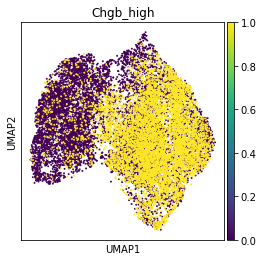

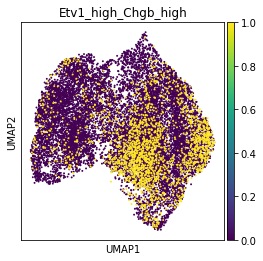

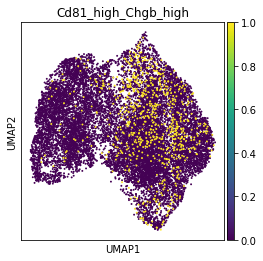

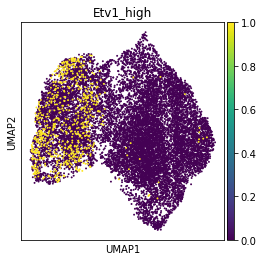

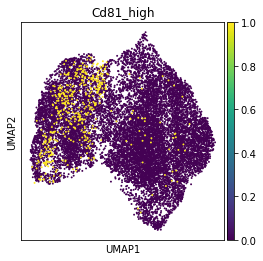

...

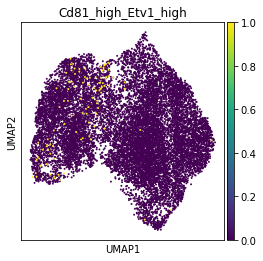

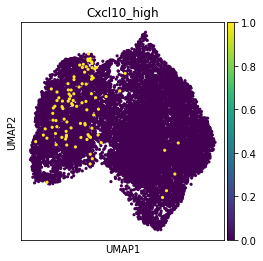

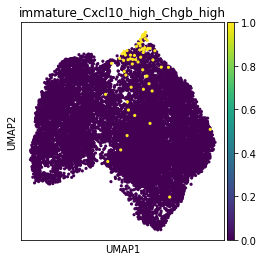

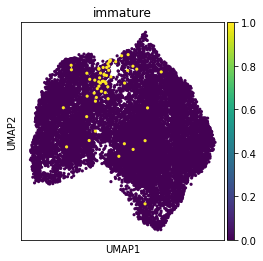

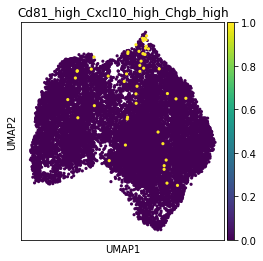

In [108]:
for subtype,count in adata_rawnormalised_beta.obs.beta_subtype.value_counts().iteritems():
    if subtype !='NA':
        s=40 if count < 100 else 15
        adata_rawnormalised_beta.obs['temp']=adata_rawnormalised_beta.obs['beta_subtype']==subtype
        sc.pl.umap(adata_rawnormalised_beta,color='temp',size=s,title=subtype)
adata_rawnormalised_beta.obs.drop('temp',axis=1,inplace=True)

In [109]:
# Add cell type data to adata
adata.obs[['cell_subtype','cell_subtype_multiplet']]=adata.obs[['cell_type','cell_type_multiplet']]
for subtype in adata_rawnormalised_beta.obs['beta_subtype'].unique():
    if subtype != 'NA':
        idxs=adata_rawnormalised_beta.obs.query('beta_subtype == @subtype').index
        subtype='beta_'+subtype
        add_category(df=adata.obs,idxs=idxs,col='cell_subtype',category=subtype)
        add_category(df=adata.obs,idxs=idxs,col='cell_subtype_multiplet',category=subtype)
# reorder categories
adata.obs.cell_subtype=pd.Categorical(adata.obs.cell_subtype,
                                   categories=sorted(list(adata.obs.cell_subtype.unique())),ordered=True)
adata.obs.cell_subtype_multiplet=pd.Categorical(adata.obs.cell_subtype_multiplet,
                                  categories=sorted(list(adata.obs.cell_subtype_multiplet.unique())),ordered=True)

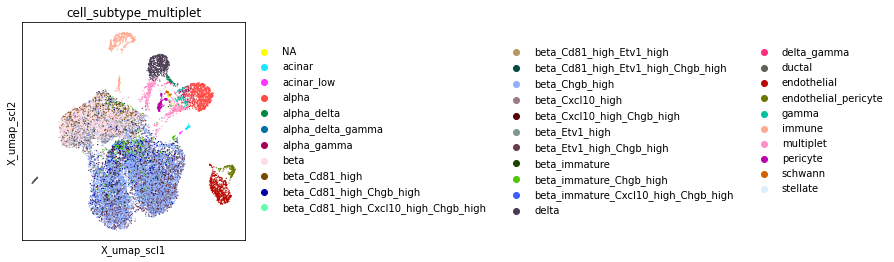

In [110]:
sc.pl.embedding(adata,'X_umap_scl',color='cell_subtype_multiplet')

### Save annotation

In [111]:
if SAVE:
    h.save_h5ad(adata, shared_folder+"data_annotated.h5ad",unique_id2=UID2)

In [6]:
#adata=h.open_h5ad(shared_folder+"data_annotated.h5ad",unique_id2=UID2)